In [1]:
#!pip install mlxtend

In [2]:
#!pip install catboost

In [3]:
#!pip install ppscore

In [4]:
#!pip install skimpy

In [5]:
#!pip install xgboost

In [6]:
#!pip install lightgbm

In [7]:
#!pip install pingouin

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Load libraries

In [9]:
# Data manipulation
#===============================================================================
import pandas as pd
import numpy as np

# Data visualization
#===============================================================================
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from skimpy import skim

# Stats
#===============================================================================
from scipy import stats
import statsmodels.api as sm
import pingouin as pg
import ppscore as pps
from scipy.stats import chi2_contingency
from scipy.sparse import csr_matrix

# Data preprocessing
#===============================================================================
from sklearn.model_selection import train_test_split as tts
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split

# Models
#===============================================================================
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier
import lightgbm as lgb
from catboost import CatBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier ,  AdaBoostClassifier
from mlxtend.classifier import stacking_classification

# Metrics
#===============================================================================
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import confusion_matrix, classification_report

# tqdm : Its For Long loops such as for loop
#===============================================================================
from tqdm.auto import tqdm

# Counter
#===============================================================================
from collections import Counter

# Pipeline
#===============================================================================
from sklearn.pipeline import Pipeline

# Hyperparameter Tuning
#===============================================================================
from sklearn.model_selection import GridSearchCV , RandomizedSearchCV
from sklearn.model_selection import StratifiedKFold

# Feature Selection
#===============================================================================
from sklearn.feature_selection import SelectKBest, f_classif

# learning_curve
#===============================================================================
from sklearn.model_selection import learning_curve

# warnings
#===============================================================================
import warnings
warnings.filterwarnings('ignore')

# Load data

In [10]:
df=pd.read_csv('/content/drive/MyDrive/nursery.csv')
df.head()

,parents,has_nurs,form,children,housing,finance,social,health,Target
0,usual,proper,complete,1,convenient,convenient,nonprob,recommended,recommend
1,usual,proper,complete,1,convenient,convenient,nonprob,priority,priority
2,usual,proper,complete,1,convenient,convenient,nonprob,not_recom,not_recom
3,usual,proper,complete,1,convenient,convenient,slightly_prob,recommended,recommend
4,usual,proper,complete,1,convenient,convenient,slightly_prob,priority,priority


# EDA

In [11]:
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 12960  │ │ string      │ 9     │                                                          │
│ │ Number of columns │ 9      │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA      ┃ NA %       ┃ words per row                ┃ total words              ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━┩  │
│ │  parents                  │       0 │          0 │                            1 │                    12960 │  │
│ │ has_nurs                  │       0 │          0 │                            1 │                    12960 │  │
│ │ form                      │       0 │          0 │                            1 │                    12960 │  │
│ │ children                  │       0 │          0 │                            1 │                    12960 │  │
│ │ housing                   │       0 │          0 │                            1 │                    12960 │  │
│ │ finance                   │       0 │          0 │                            1 │                    12960 │  │
│ │ social                    │       0 │          0 │                            1 │                    12960 │  │
│ │ health                    │       0 │          0 │                            1 │                    12960 │  │
│ │ Target                    │       0 │          0 │                            1 │                    12960 │  │
│ └───────────────────────────┴─────────┴────────────┴──────────────────────────────┴──────────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

In [12]:
df.columns.str.strip()

Index(['parents', 'has_nurs', 'form', 'children', 'housing', 'finance',
       'social', 'health', 'Target'],
      dtype='object')

In [13]:
df.describe()

,parents,has_nurs,form,children,housing,finance,social,health,Target
count,12960,12960,12960,12960,12960,12960,12960,12960,12960
unique,3,5,4,4,3,2,3,3,5
top,usual,proper,complete,1,convenient,convenient,nonprob,recommended,not_recom
freq,4320,2592,3240,3240,4320,6480,4320,4320,4320


In [14]:
df.dtypes

 parents    object
has_nurs    object
form        object
children    object
housing     object
finance     object
social      object
health      object
Target      object
dtype: object

In [15]:
df.isnull().sum()

 parents    0
has_nurs    0
form        0
children    0
housing     0
finance     0
social      0
health      0
Target      0
dtype: int64

In [16]:
df[' parents'].value_counts()

 parents
usual          4320
pretentious    4320
great_pret     4320
Name: count, dtype: int64

In [17]:
df['has_nurs'].value_counts()

has_nurs
proper         2592
less_proper    2592
improper       2592
critical       2592
very_crit      2592
Name: count, dtype: int64

In [18]:
df['form'].value_counts()

form
complete      3240
completed     3240
incomplete    3240
foster        3240
Name: count, dtype: int64

In [19]:
df['children'].value_counts()

children
1       3240
2       3240
3       3240
more    3240
Name: count, dtype: int64

In [20]:
df['housing'].value_counts()

housing
convenient    4320
less_conv     4320
critical      4320
Name: count, dtype: int64

In [21]:
df['finance'].value_counts()

finance
convenient    6480
inconv        6480
Name: count, dtype: int64

In [22]:
df['social'].value_counts()

social
nonprob          4320
slightly_prob    4320
problematic      4320
Name: count, dtype: int64

In [23]:
df['health'].value_counts()

health
recommended    4320
priority       4320
not_recom      4320
Name: count, dtype: int64

In [24]:
df['Target'].value_counts()

Target
not_recom     4320
priority      4266
spec_prior    4044
very_recom     328
recommend        2
Name: count, dtype: int64

# Performing Hypothesis Testing

#### Effect of Health on Recommendation:
- Null Hypothesis (H0): There is no association between the health status and the recommendation.
- Alternative Hypothesis (H1): There is an association between the health status and the recommendation.

#### Effect of Social Conditions on Recommendation:
- Null Hypothesis (H0): There is no association between social conditions and the recommendation.
- Alternative Hypothesis (H1): There is an association between social conditions and the recommendation.

#### Effect of Housing Conditions on Recommendation:
- Null Hypothesis (H0): There is no association between housing conditions and the recommendation.
- Alternative Hypothesis (H1): There is an association between housing conditions and the recommendation.

#### Interaction between Health and Social Conditions on Recommendation:
- Null Hypothesis (H0): The effect of health on recommendation does not depend on social conditions.
- Alternative Hypothesis (H1): The effect of health on recommendation depends on social conditions.



In [25]:
hypotheses = [
    ("Effect of Health on Recommendation", "health", "Target"),
    ("Effect of Social Conditions on Recommendation", "social", "Target"),
    ("Effect of Housing Conditions on Recommendation", "housing", "Target"),
    ("Interaction between Health and Social Conditions on Recommendation", "health", "social")
]

# Perform hypothesis testing for each hypothesis
for hypothesis, predictor, target in hypotheses:
    print("\nHypothesis:", hypothesis)

    if isinstance(predictor, list):
        contingency_table = pd.crosstab(df[predictor[0]], df[target])
        for col in predictor[1:]:
            contingency_table += pd.crosstab(df[col], df[target])
    else:
        contingency_table = pd.crosstab(df[predictor], df[target])

    chi2, p, dof, expected = chi2_contingency(contingency_table)

    print("Chi-square statistic:", chi2)
    print("P-value:", p)

    # Significance level
    alpha = 0.05

    # Make decision based on p-value
    if p < alpha:
        print("Reject null hypothesis.")
    else:
        print("Fail to reject null hypothesis.")


Hypothesis: Effect of Health on Recommendation
Chi-square statistic: 13856.9676595425
P-value: 0.0
Reject null hypothesis.

Hypothesis: Effect of Social Conditions on Recommendation
Chi-square statistic: 298.98921984750024
P-value: 6.757486694729546e-60
Reject null hypothesis.

Hypothesis: Effect of Housing Conditions on Recommendation
Chi-square statistic: 330.75043921006016
P-value: 1.1577548556097407e-66
Reject null hypothesis.

Hypothesis: Interaction between Health and Social Conditions on Recommendation
Chi-square statistic: 0.0
P-value: 1.0
Fail to reject null hypothesis.


# Univariate Analysis

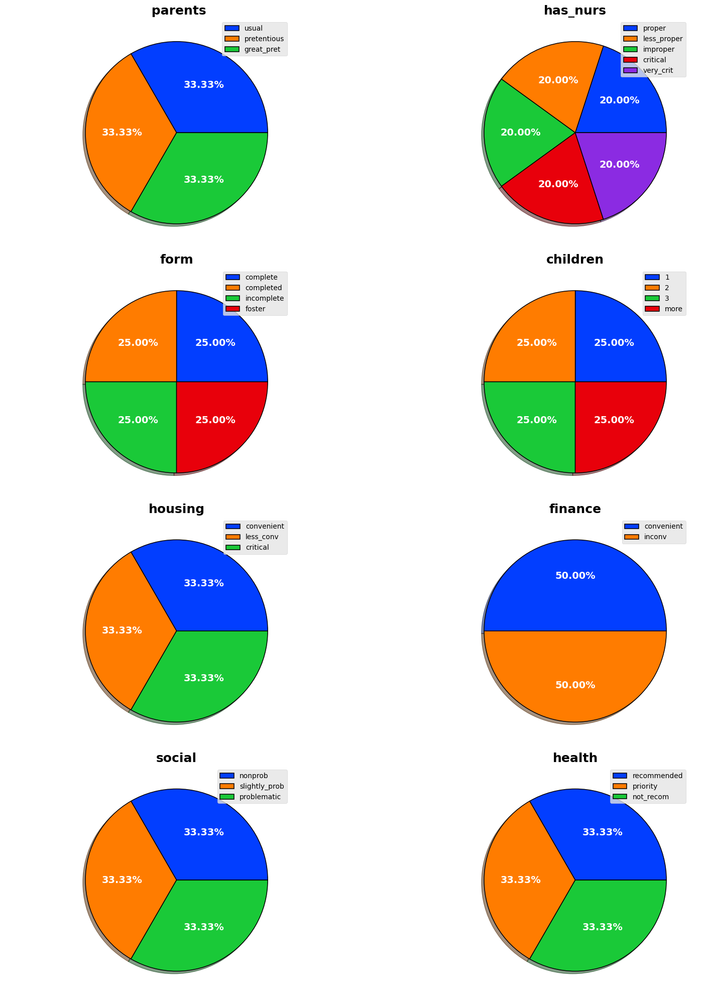

In [26]:
plt.style.use('ggplot')
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(18, 20))
axs = axs.flat

for i, col in enumerate(df.columns[:-1]):
    axs[i].pie(x=list(Counter(df[col]).values()),
               labels=list(Counter(df[col]).keys()),
               colors=[color for color in sns.color_palette('bright', len(df.columns))],
               autopct="%.2f%%",
               shadow=True,
               wedgeprops=dict(edgecolor='black', linewidth=1.1),
               textprops=dict(fontsize=14, fontweight='bold', color='white'))

    axs[i].set_title(col, fontsize=18, fontweight='bold', color='black')
    axs[i].legend()

fig.tight_layout()
plt.show()


#

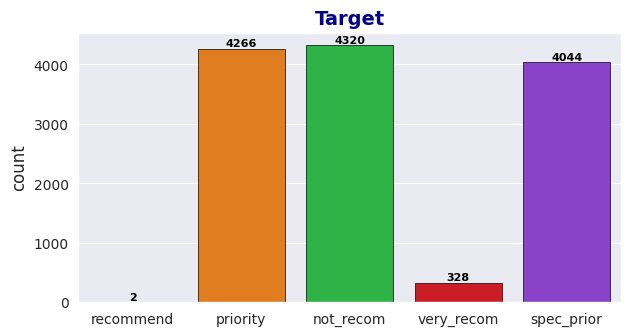

In [27]:
sns.set_style("darkgrid")
fig,ax = plt.subplots(figsize = (7,3.5))
ax = sns.countplot(df, x = 'Target', palette = 'bright', edgecolor = 'black')

for bars in ax.containers:
    ax.bar_label(bars, fontsize = 8, fontweight = 'bold', color = 'black')

ax.set_xlabel("")
ax.set_title('Target', fontsize = 14, fontweight = 'bold', color = 'darkblue')
fig.show()

#  Bivariate Analysis

In [28]:
fig=px.parallel_categories(data_frame=df,dimensions=[' parents','Target'])
fig.show()

In [29]:
fig=px.parallel_categories(data_frame=df,dimensions=['has_nurs','Target'])
fig.show()

In [30]:
fig = px.parallel_categories(data_frame = df, dimensions = ['form', 'Target'])
fig.show()

In [31]:
fig = px.parallel_categories(data_frame = df, dimensions = ['children', 'Target'])
fig.show()

In [32]:
fig = px.parallel_categories(data_frame = df, dimensions = ['housing', 'Target'])
fig.show()

In [33]:
fig = px.parallel_categories(data_frame = df, dimensions = ['finance', 'Target'])
fig.show()

In [34]:
fig = px.parallel_categories(data_frame = df, dimensions = ['social', 'Target'])
fig.show()

In [35]:
fig = px.parallel_categories(data_frame = df, dimensions = ['health', 'Target'])
fig.show()

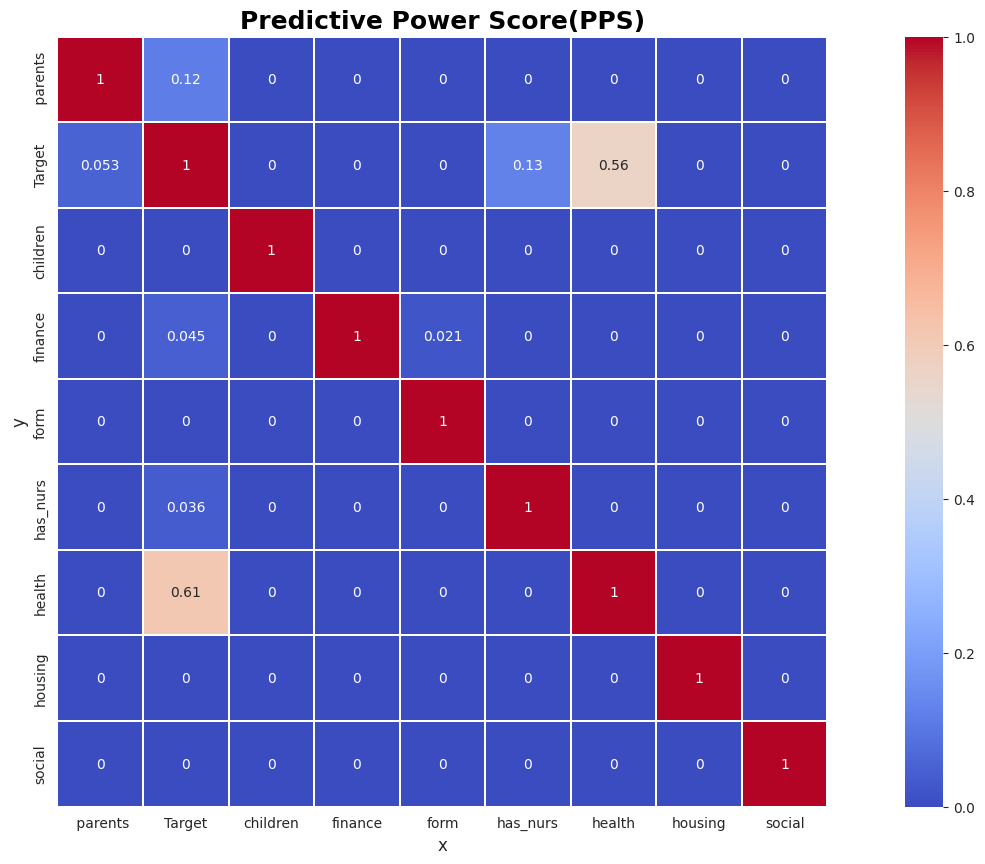

In [36]:
corr_matrix_pps=pps.matrix(df)[['x','y','ppscore']].pivot_table(index='y',columns='x',values='ppscore')
plt.figure(figsize=(20,10))
sns.heatmap(corr_matrix_pps, cmap='coolwarm',annot=True ,linewidths=1.1,square=True)
plt.title("Predictive Power Score(PPS)", fontsize = 18, fontweight = 'bold', color = 'black')
plt.show()

#  Data preprocessing




In [37]:
X= df.drop(columns=['Target'])
y=df['Target']

In [38]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=.20,random_state=42,stratify=y)

In [39]:
# Transformation of the Target variable
le=LabelEncoder()
y_train=le.fit_transform(y_train)
y_test=le.transform(y_test)

In [40]:
# We selected categorical variables to code.
categorical_predictors = X_train.select_dtypes(include = ['object', 'category']).columns.to_list()
categorical_predictors

[' parents',
 'has_nurs',
 'form',
 'children',
 'housing',
 'finance',
 'social',
 'health']

In [41]:
transformer = ColumnTransformer(
    transformers=[
        ("onehot", OneHotEncoder(), categorical_predictors)
    ],
    remainder='passthrough'
)

In [42]:
X_train_encoded = transformer.fit_transform(X_train)
X_test_encoded=transformer.transform(X_test)

In [43]:
print(f'X_train_prep: {X_train_encoded.shape}')
print(f'X_test_prep: {X_test_encoded.shape}')

X_train_prep: (10368, 27)
X_test_prep: (2592, 27)


In [44]:
print(f'y_train: {Counter(y_train)}')
print(f'y_test: {Counter(y_test)}')

y_train: Counter({0: 3456, 1: 3413, 3: 3235, 4: 262, 2: 2})
y_test: Counter({0: 864, 1: 853, 3: 809, 4: 66})


# Note : Because it is a multiclass problem, and the classes are unbalanced, we will use balanced_accuracy_score as the evaluation metric.

# Models & Metrics

#### LogisticRegression

In [45]:
feature_selection = SelectKBest(score_func=f_classif)

param_grid = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__C': [0.001, 0.01, 0.1, 1, 10, 100],
        'classifier__penalty': ['l1', 'l2']
    }]

pipe = Pipeline([
    ('feature_selection', feature_selection),
    ('classifier', LogisticRegression())
])

clf=GridSearchCV(pipe, param_grid, cv=5)
clf.fit(X_train_encoded,y_train)


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('feature_selection', SelectKBest()),
                                       ('classifier', LogisticRegression())]),
             param_grid=[{'classifier__C': [0.001, 0.01, 0.1, 1, 10, 100],
                          'classifier__penalty': ['l1', 'l2'],
                          'feature_selection__k': [5, 10, 15]}])

In [46]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [47]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9224537037037037
0.9227430555555556


In [48]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.699206455409773
0.859259409171774


In [49]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.88      0.89      0.88      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.89      0.89      0.89      3235
  very_recom       0.86      0.71      0.78       262

    accuracy                           0.92     10368
   macro avg       0.73      0.70      0.71     10368
weighted avg       0.92      0.92      0.92     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

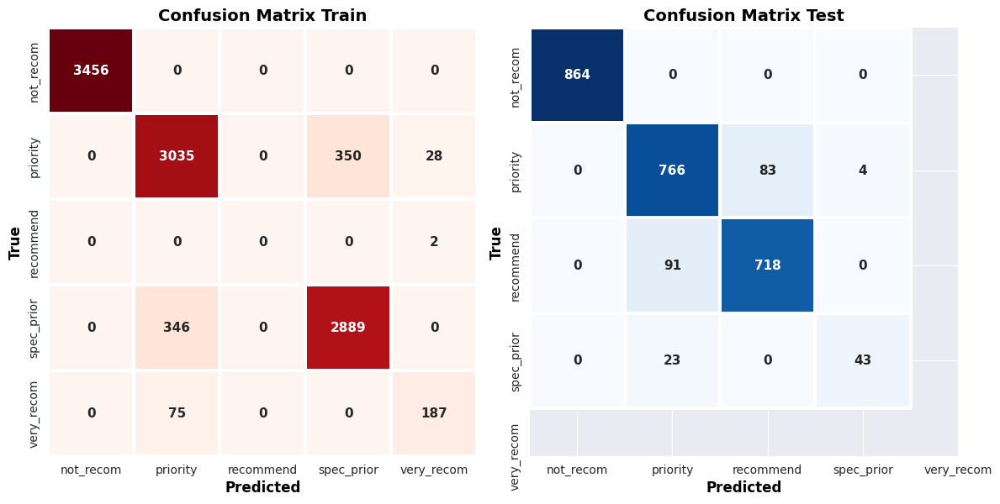

In [50]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

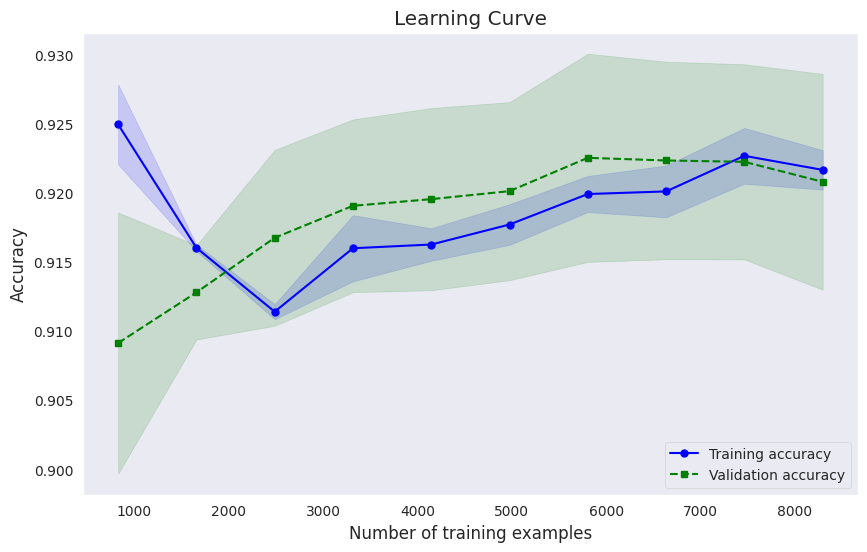

In [51]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

#### KNeighborsClassifier

In [52]:
feature_selection = SelectKBest(score_func=f_classif)
param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__n_neighbors': [3, 5, 7, 9],
        'classifier__weights': ['uniform', 'distance']
    }]

pipe = Pipeline([
    ('feature_selection', feature_selection),
    ('classifier', KNeighborsClassifier())
])

clf = GridSearchCV(pipe, param_grids, cv=5)
clf.fit(X_train_encoded, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('feature_selection', SelectKBest()),
                                       ('classifier', KNeighborsClassifier())]),
             param_grid=[{'classifier__n_neighbors': [3, 5, 7, 9],
                          'classifier__weights': ['uniform', 'distance'],
                          'feature_selection__k': [5, 10, 15]}])

In [53]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [54]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9575617283950617
0.9662422839506173


In [55]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.7363881384675593
0.87996056851978


In [56]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.88      0.77      0.82       262

    accuracy                           0.97     10368
   macro avg       0.76      0.74      0.75     10368
weighted avg       0.97      0.97      0.97     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

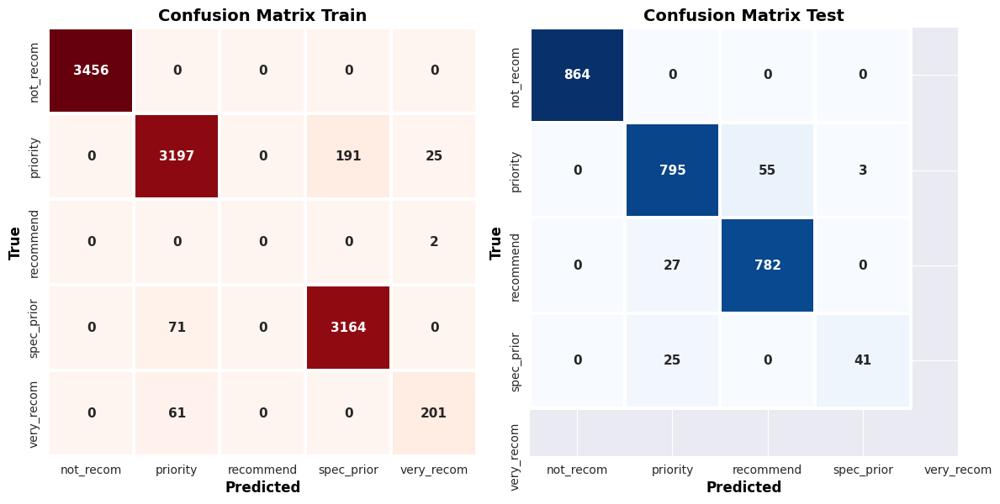

In [57]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

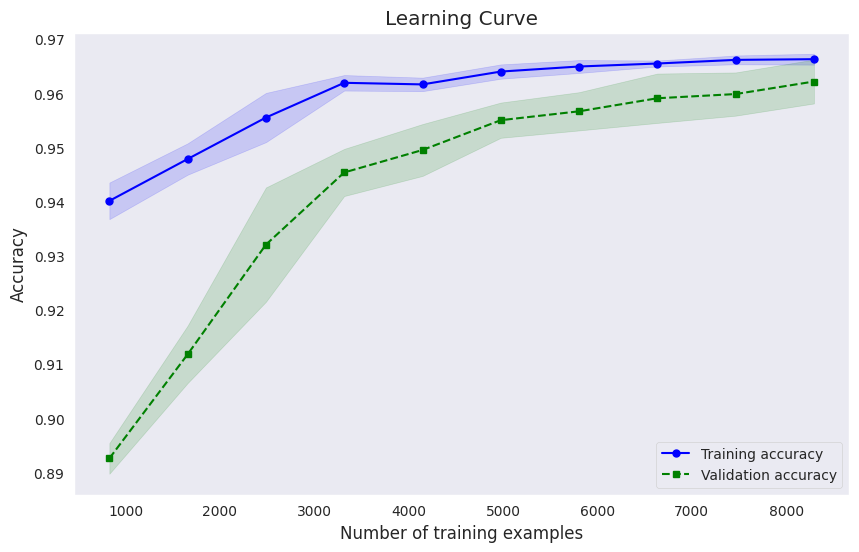

In [58]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

# GaussianNB


In [59]:
X_train_dense = X_train_encoded.toarray()
feature_selection = SelectKBest(score_func=f_classif)

param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
    }
]


pipe = Pipeline([
    ('feature_selection', feature_selection),
    ('classifier', GaussianNB())
])


clf = GridSearchCV(pipe, param_grids, cv=5)
clf.fit(X_train_dense, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('feature_selection', SelectKBest()),
                                       ('classifier', GaussianNB())]),
             param_grid=[{'feature_selection__k': [5, 10, 15]}])

In [60]:
y_pred=clf.predict(X_test_encoded.toarray())
y_pred_train = clf.predict(X_train_encoded.toarray())

In [61]:
print(clf.score(X_test_encoded.toarray(),y_test))
print(clf.score(X_train_encoded.toarray(),y_train))

0.8402777777777778
0.839891975308642


In [62]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.8977759252808983
0.8734631381276249


In [63]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.83      0.64      0.73      3413
   recommend       0.29      1.00      0.44         2
  spec_prior       0.83      0.86      0.85      3235
  very_recom       0.28      0.98      0.44       262

    accuracy                           0.84     10368
   macro avg       0.65      0.90      0.69     10368
weighted avg       0.87      0.84      0.85     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

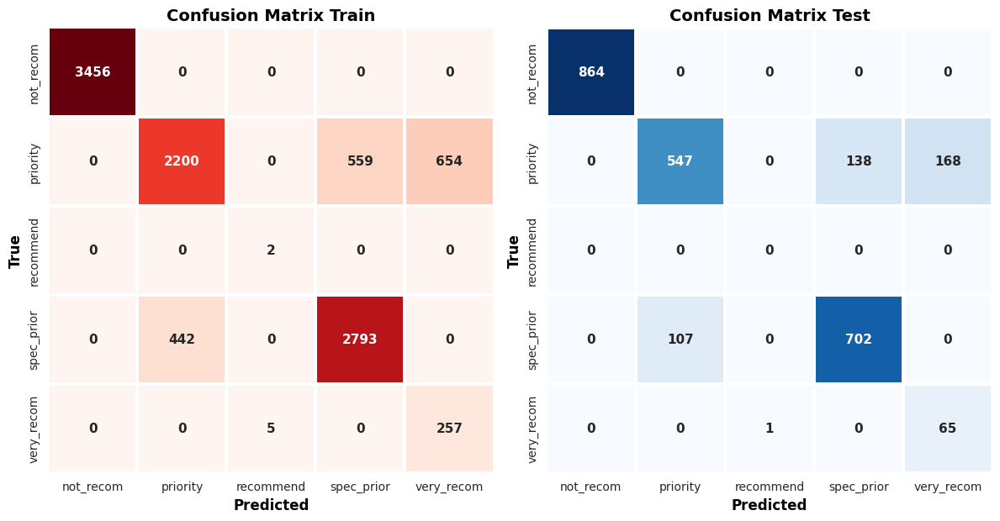

In [64]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

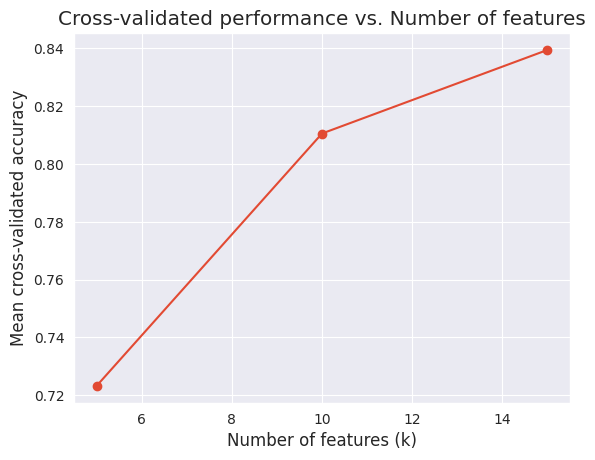

In [65]:
# Extracting k values and mean cross-validated scores
ks = [params['feature_selection__k'] for params in clf.cv_results_['params']]
scores = clf.cv_results_['mean_test_score']

# Plotting
plt.plot(ks, scores, marker='o')
plt.xlabel('Number of features (k)')
plt.ylabel('Mean cross-validated accuracy')
plt.title('Cross-validated performance vs. Number of features')
plt.grid(True)
plt.show()

## Since Gaussian Naive Bayes (GNB) doesn't involve a learning rate, it doesn't have a learning rate to visualize.

## RandomForestClassifier

In [66]:
feature_selection = SelectKBest(score_func=f_classif)
param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__n_estimators': [50, 100, 200],
        'classifier__max_depth': [None, 10, 20],
        'classifier__min_samples_split': [2, 5, 10],
        'classifier__min_samples_leaf': [1, 2, 4],
        'classifier__bootstrap': [True, False]
    }
]

pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier', RandomForestClassifier())
])


clf = RandomizedSearchCV(pipe, param_grids, cv=5)
clf.fit(X_train_encoded, y_train)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('feature_selection',
                                              SelectKBest()),
                                             ('classifier',
                                              RandomForestClassifier())]),
                   param_distributions=[{'classifier__bootstrap': [True, False],
                                         'classifier__max_depth': [None, 10,
                                                                   20],
                                         'classifier__min_samples_leaf': [1, 2,
                                                                          4],
                                         'classifier__min_samples_split': [2, 5,
                                                                           10],
                                         'classifier__n_estimators': [50, 100,
                                                                      200],
                                         'feature_selection__k': [5, 10, 15]}])

In [67]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [68]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9598765432098766
0.9666280864197531


In [69]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.7366386580057738
0.8818147094344896


In [70]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.88      0.77      0.82       262

    accuracy                           0.97     10368
   macro avg       0.76      0.74      0.75     10368
weighted avg       0.97      0.97      0.97     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

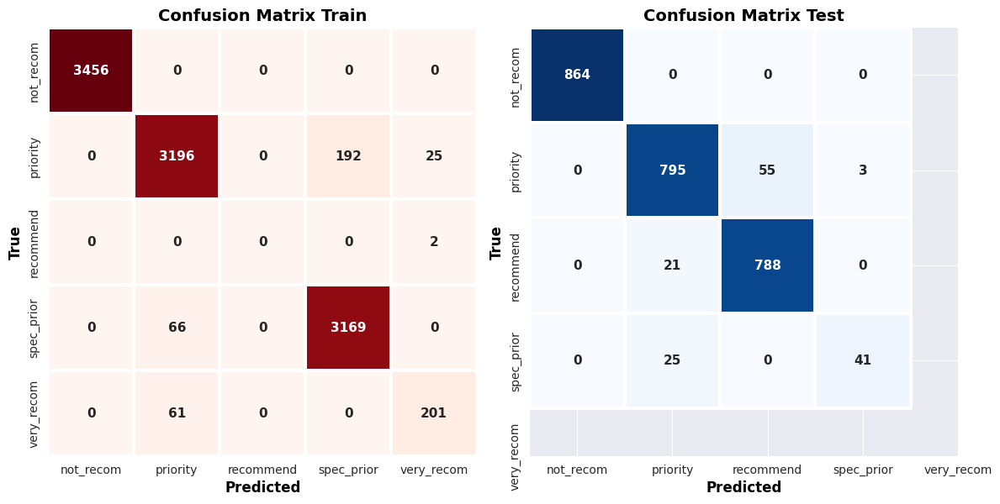

In [71]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

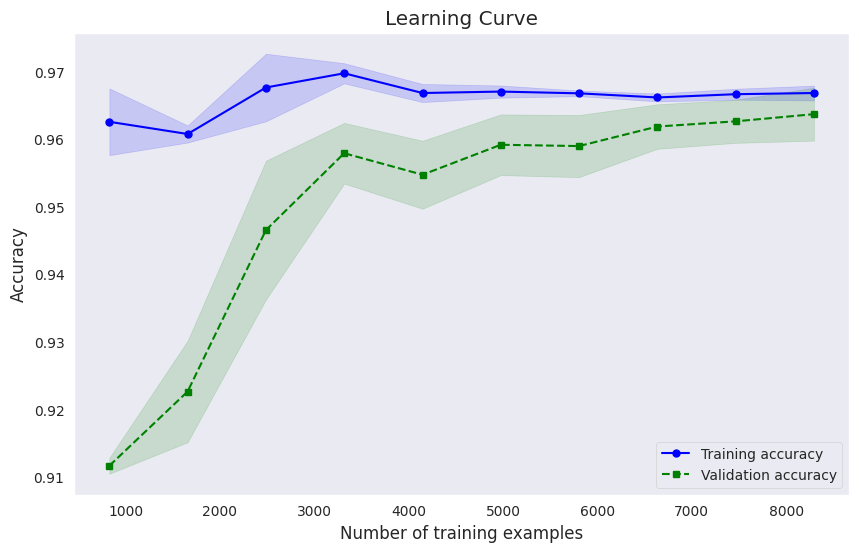

In [72]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

## ExtraTreesClassifier

In [73]:
param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__n_estimators': [50, 100, 200],
        'classifier__max_depth': [None, 10, 20],
        'classifier__min_samples_split': [2, 5, 10],
        'classifier__min_samples_leaf': [1, 2, 4],
        'classifier__bootstrap': [True, False]
    }
]

pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier', ExtraTreesClassifier())
])


clf = RandomizedSearchCV(pipe, param_grids, cv=5)
clf.fit(X_train_encoded, y_train)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('feature_selection',
                                              SelectKBest()),
                                             ('classifier',
                                              ExtraTreesClassifier())]),
                   param_distributions=[{'classifier__bootstrap': [True, False],
                                         'classifier__max_depth': [None, 10,
                                                                   20],
                                         'classifier__min_samples_leaf': [1, 2,
                                                                          4],
                                         'classifier__min_samples_split': [2, 5,
                                                                           10],
                                         'classifier__n_estimators': [50, 100,
                                                                      200],
                                         'feature_selection__k': [5, 10, 15]}])

In [74]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [75]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9583333333333334
0.9666280864197531


In [76]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.736645106664892
0.8806423764919339


In [77]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.88      0.77      0.82       262

    accuracy                           0.97     10368
   macro avg       0.76      0.74      0.75     10368
weighted avg       0.97      0.97      0.97     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

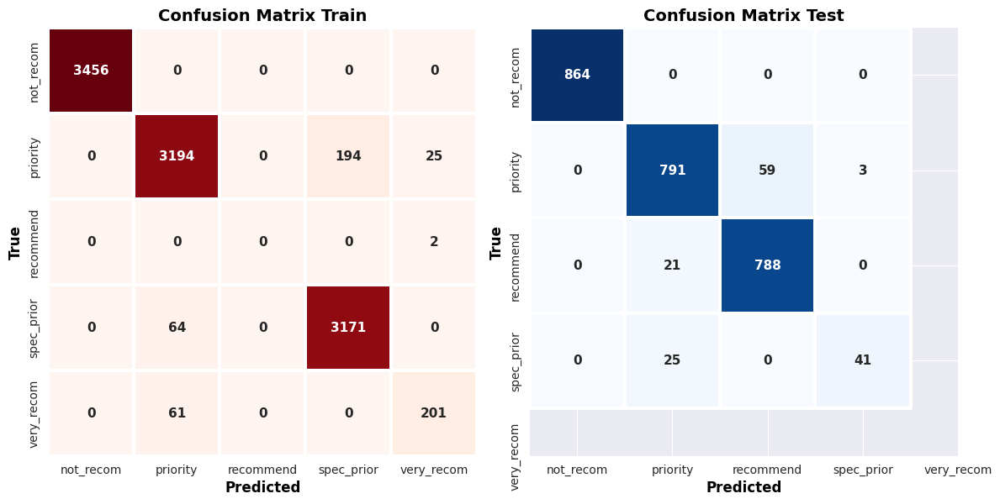

In [78]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

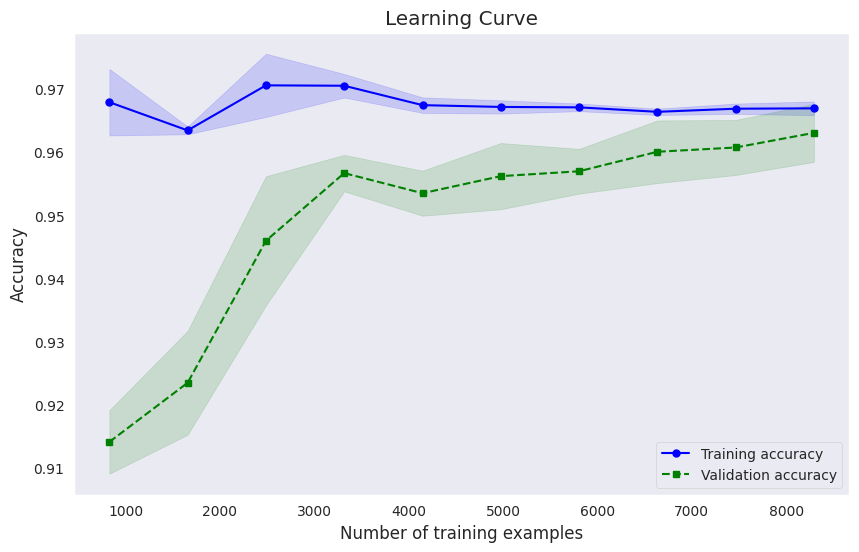

In [79]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

## XGBClassifier

In [80]:
param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__max_depth': [3, 4, 5],
        'classifier__learning_rate': [0.01, 0.05, 0.1],
        'classifier__n_estimators': [50, 100, 200],
        'classifier__gamma': [0, 0.1, 0.3, 0.5],
        'classifier__subsample': [0.8, 0.9, 1.0],
        'classifier__colsample_bytree': [0.8, 0.9, 1.0]
    }
]
pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier', XGBClassifier())
])

clf = RandomizedSearchCV(pipe, param_grids, cv=5)
clf.fit(X_train_encoded, y_train)


RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('feature_selection',
                                              SelectKBest()),
                                             ('classifier',
                                              XGBClassifier(base_score=None,
                                                            booster=None,
                                                            callbacks=None,
                                                            colsample_bylevel=None,
                                                            colsample_bynode=None,
                                                            colsample_bytree=None,
                                                            device=None,
                                                            early_stopping_rounds=None,
                                                            enable_categorical=False,
                                                            eval_metric=None,
                                                            feature_types=None,
                                                            gamma=None,
                                                            grow_policy=No...
                                                            n_jobs=None,
                                                            num_parallel_tree=None,
                                                            random_state=None, ...))]),
                   param_distributions=[{'classifier__colsample_bytree': [0.8,
                                                                          0.9,
                                                                          1.0],
                                         'classifier__gamma': [0, 0.1, 0.3,
                                                               0.5],
                                         'classifier__learning_rate': [0.01,
                                                                       0.05,
                                                                       0.1],
                                         'classifier__max_depth': [3, 4, 5],
                                         'classifier__n_estimators': [50, 100,
                                                                      200],
                                         'classifier__subsample': [0.8, 0.9,
                                                                   1.0],
                                         'feature_selection__k': [5, 10, 15]}])

In [81]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [82]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9610339506172839
0.9646026234567902


In [83]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)


0.7213161072902091
0.8897154307461781


In [84]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")


################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.87      0.69      0.77       262

    accuracy                           0.96     10368
   macro avg       0.75      0.72      0.74     10368
weighted avg       0.96      0.96      0.96     10368




In [85]:
print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       864
           1       0.95      0.93      0.94       853
           3       0.93      0.98      0.96       809
           4       0.91      0.65      0.76        66

    accuracy                           0.96      2592
   macro avg       0.95      0.89      0.91      2592
weighted avg       0.96      0.96      0.96      2592



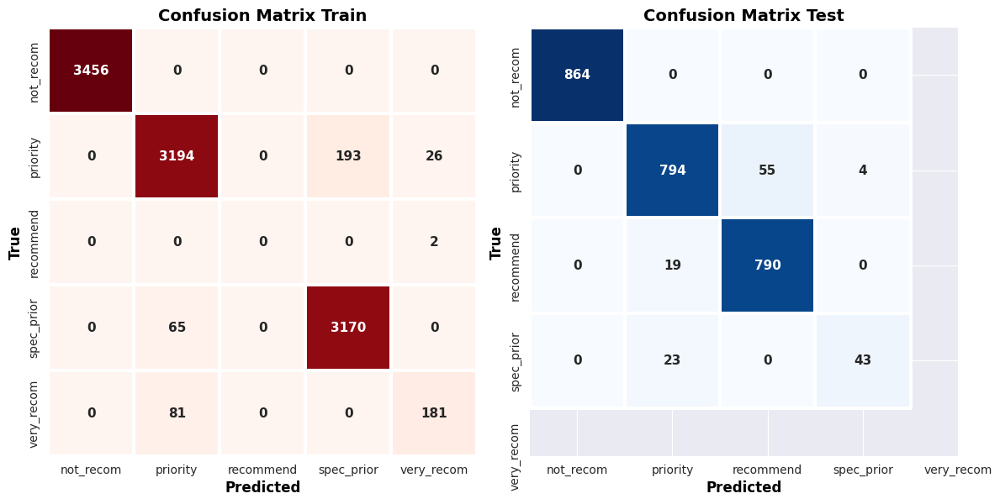

In [86]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()


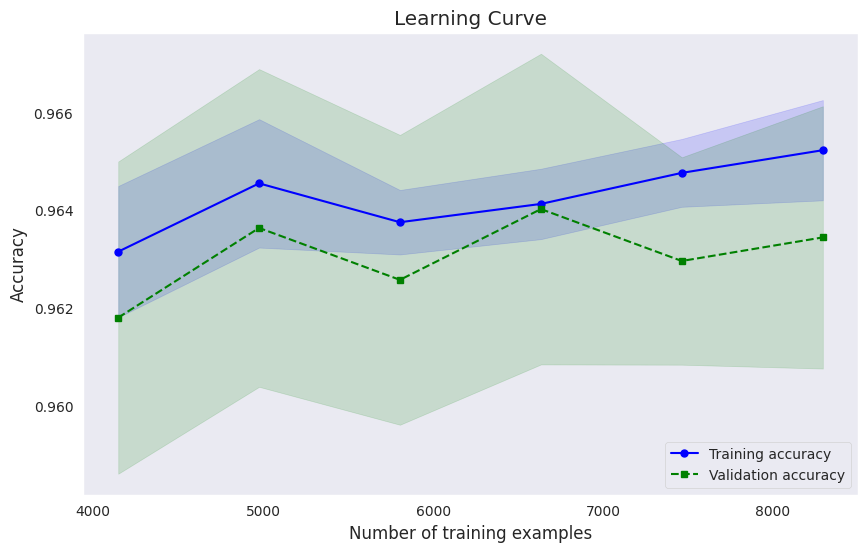

In [87]:

train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

## LGBMClassifier

In [88]:

param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__num_leaves': [20, 31, 40, 50],
        'classifier__max_depth': [3, 5, 7, 10],
        'classifier__learning_rate': [0.01, 0.05, 0.1, 0.2],
        'classifier__n_estimators': [50, 100, 200, 300],
        'classifier__subsample': [0.8, 0.9, 1.0],
        'classifier__colsample_bytree': [0.8, 0.9, 1.0]
    }
]


pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier', lgb.LGBMClassifier())
])


clf = RandomizedSearchCV(pipe, param_grids, cv=5, n_iter=50, verbose=2, n_jobs=-1)


clf.fit(X_train_encoded, y_train)


print("Best parameters found: ", clf.best_params_)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098853
[LightGBM] [Info] Start training from score -1.110865
[LightGBM] [Info] Start training from score -8.330140
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.680953
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098492
[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.676180
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=1.0, classifier__learning_rate=0.05, classifier__max_depth=10, classifier__n_estimators=100, classifier__num_leaves=20, classifier__subsample=0.9, feature_selection__k=15; total time=   1.2s
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (nu

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[CV] END classifier__colsample_bytree=1.0, classifier__learning_rate=0.05, classifier__max_depth=10, classifier__n_estimators=200, classifier__num_leaves=31, classifier__subsample=0.8, feature_selection__k=5; total time=   1.3s
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000787 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 5
[LightGBM] [Info] Start training from score -1.098492
[Li

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.676180
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=50, classifier__num_leaves=40, classifier__subsample=0.9, fe

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.8, classifier__learning_rate=0.1, classifier__max_depth=3, classifier__n_estimators=200, classifier__num_leaves=50, classifier__subsample=0.9, feature_selection__k=15; total time=   1.3s
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[CV] END classifier__colsample_bytree=0.8, classifier__learning_rate=0.01, classifier__max_depth=5, classifier__n_estimators=300, classifier__num_leaves=31, classifier__subsample=1.0, feature_selection__k=15; total time=   3.0s
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001077 seconds.
You can set `

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 5
[LightGBM] [Info] Start training from score -1.098853
[LightGBM] [Info] Start training from score -1.110865
[LightGBM] [Info] Start training from score -8.330140
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.680953
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.2, classifier__max_depth=7, classifier__n_estimators=300, classifier__num_leaves=40, classifier__subsamp

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Total Bins 30
[LightGBM] [Info] Number of data points in the train set: 8295, number of used features: 15
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.111351
[LightGBM] [Info] Start training from score -8.330261
[LightGBM] [Info] Start training from score -1.164768
[LightGBM] [Info] Start training from score -3.676301
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[CV] END classifier__colsample_bytree=0.8, classifier__learning_rate=0.01, classifier__max_depth=7, classifier__n_estimators=300, classifier__num_leaves=31, classifier__subsample=0.8, feature_selection__k=15; total time=   3.1s
[LightGBM] [Info] Auto-

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.1, classifier__max_depth=7, classifier__n_estimators=100, classifier__num_leaves=40, classifier__subsample=1.0, feature_selection__k=15; total time=   1.6s
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098853
[LightGBM] [Info] Start training f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__colsample_bytree=1.0, classifier__learning_rate=0.05, classifier__max_depth=5, classifier__n_estimators=200, classifier__num_leaves=31, classifier__subsample=1.0, feature_selection__k=10; total time=   2.3s
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001009 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098492
[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.676180
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[CV] END classifier__colsample_bytree=1.0, classifier__learning_rate=0.05, classifier__max_depth=5, classifier__n_estima

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.05, classifier__max_depth=3, 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098492
[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.676180
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.05, classifier__max_depth=5, classifier__n_estimators=100, classifier__num_leaves=20, classifier__subsample=0.8, feature_selection__k=15; total time=   1.2s
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000298 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098853
[LightGBM] [Info] Start training from score -1.110865
[LightGBM] [Info] Start training from score -8.330140
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.680953
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098492
[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.676180
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.2, classifier__max_depth=3, classifier__n_estimators=50, classifier__num_leaves=40, classifier__subsample=0.8, feature_selection__k=5; total time=   0.4s
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002286 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 5
[LightGBM] [Info] Start training from score -1.098492
[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM] [Info] Start training from score -3.676180
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Start training from score -8.330261
[LightGBM] [Info] Start training from score -1.164768
[LightGBM] [Info] Start training from score -3.676301
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.111351
[LightGBM] [Info] Start training from score -8.330261
[LightGBM] [Info] Start training from score -1.164768
[LightGBM] [Info] Start training from score -3.676301
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__colsample_bytree=0.8, classifier__learning_rate=0.01, classifier__max_depth=7, classifier__n_estimators=100, classifier__num_leaves=31, classifier__subsample=0.9, feature_selection__k=10; total time=   1.8s
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001021 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20
[LightGBM] [Info] Number of data points in the train set: 8294, number of used features: 10
[LightGBM] [Info] Start training from score -1.098492
[LightGBM] [Info] Start training from score -1.111231
[LightGBM] [Info] Start training from score -9.023288
[LightGBM] [Info] Start training from score -1.164647
[LightGBM]

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[CV] END classifier__colsample_bytree=0.9, classifier__learning_rate=0.01, classifier__max_depth=3, classifier__n_estimators=100, classifier__num_leaves=20, classifier__subsam

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits wit

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

In [89]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [90]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9621913580246914
0.9666280864197531


In [91]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.7380514009473753
0.8975842715575746


In [92]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.88      0.77      0.82       262

    accuracy                           0.97     10368
   macro avg       0.76      0.74      0.75     10368
weighted avg       0.97      0.97      0.97     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

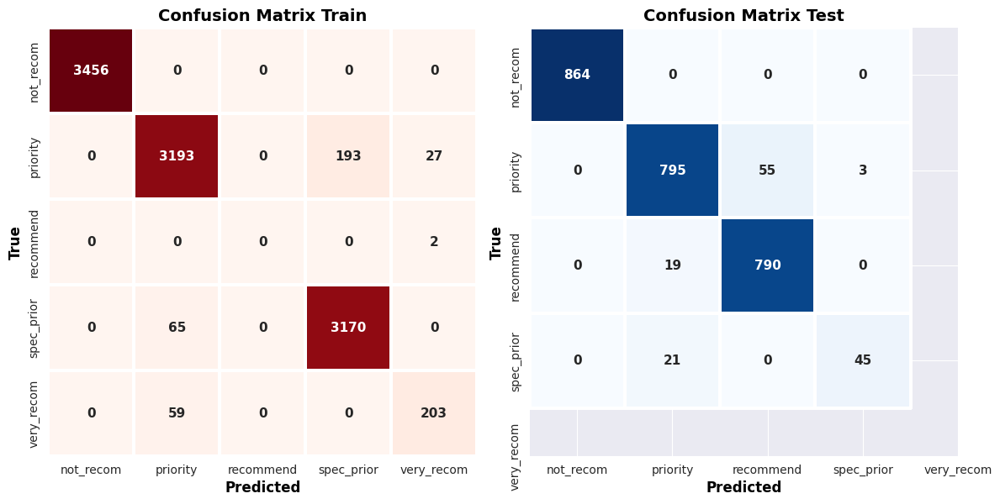

In [93]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

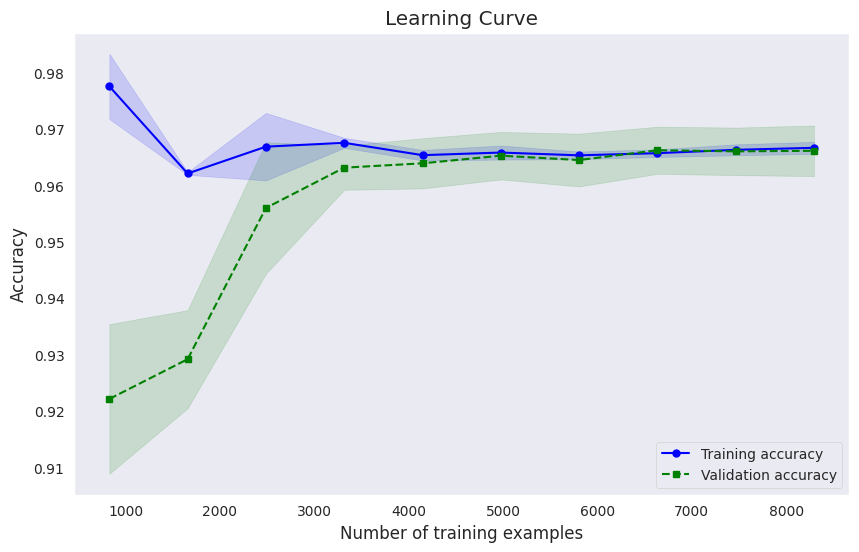

In [94]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

##  CatBoostClassifier

In [95]:
param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
         'classifier__iterations': [50, 100, 200],
        'classifier__learning_rate': [0.01, 0.05, 0.1],
        'classifier__depth': [3, 5, 7],
        'classifier__l2_leaf_reg': [1, 3, 5, 7, 9]
    }
]

pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier',CatBoostClassifier())
])


clf = RandomizedSearchCV(pipe, param_grids, cv=5, n_iter=50, verbose=2, n_jobs=-1)


clf.fit(X_train_encoded, y_train)


Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


192:	learn: 0.0927507	total: 3.69s	remaining: 134ms
193:	learn: 0.0926667	total: 3.71s	remaining: 115ms
194:	learn: 0.0926064	total: 3.73s	remaining: 95.7ms
195:	learn: 0.0925427	total: 3.76s	remaining: 76.8ms
196:	learn: 0.0924471	total: 3.82s	remaining: 58.1ms
197:	learn: 0.0923879	total: 3.83s	remaining: 38.7ms
198:	learn: 0.0923345	total: 3.85s	remaining: 19.3ms
199:	learn: 0.0922619	total: 3.86s	remaining: 0us
[CV] END classifier__depth=7, classifier__iterations=200, classifier__l2_leaf_reg=5, classifier__learning_rate=0.1, feature_selection__k=15; total time=   4.0s
0:	learn: 1.3588458	total: 30.5ms	remaining: 6.08s
1:	learn: 1.1695115	total: 55.6ms	remaining: 5.5s
2:	learn: 1.0355355	total: 70.2ms	remaining: 4.61s
3:	learn: 0.9250363	total: 104ms	remaining: 5.07s
4:	learn: 0.8365214	total: 127ms	remaining: 4.96s
5:	learn: 0.7599223	total: 147ms	remaining: 4.76s
6:	learn: 0.6983562	total: 175ms	remaining: 4.81s
7:	learn: 0.6446696	total: 215ms	remaining: 5.17s
8:	learn: 0.5995999

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


151:	learn: 0.0969547	total: 4.53s	remaining: 1.43s
152:	learn: 0.0968589	total: 4.55s	remaining: 1.4s
153:	learn: 0.0967452	total: 4.56s	remaining: 1.36s
154:	learn: 0.0966189	total: 4.58s	remaining: 1.33s
155:	learn: 0.0964539	total: 4.6s	remaining: 1.3s
156:	learn: 0.0963006	total: 4.62s	remaining: 1.26s
157:	learn: 0.0961006	total: 4.64s	remaining: 1.23s
158:	learn: 0.0959868	total: 4.66s	remaining: 1.2s
159:	learn: 0.0958735	total: 4.68s	remaining: 1.17s
160:	learn: 0.0957721	total: 4.69s	remaining: 1.14s
161:	learn: 0.0955438	total: 4.71s	remaining: 1.1s
162:	learn: 0.0954684	total: 4.73s	remaining: 1.07s
163:	learn: 0.0953066	total: 4.75s	remaining: 1.04s
164:	learn: 0.0951559	total: 4.77s	remaining: 1.01s
165:	learn: 0.0949889	total: 4.79s	remaining: 981ms
166:	learn: 0.0947986	total: 4.81s	remaining: 950ms
167:	learn: 0.0946994	total: 4.83s	remaining: 919ms
168:	learn: 0.0945949	total: 4.84s	remaining: 889ms
169:	learn: 0.0945007	total: 4.86s	remaining: 858ms
170:	learn: 0.094

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


148:	learn: 0.0969034	total: 4.43s	remaining: 1.52s
149:	learn: 0.0967216	total: 4.46s	remaining: 1.49s
150:	learn: 0.0965652	total: 4.47s	remaining: 1.45s
151:	learn: 0.0964212	total: 4.5s	remaining: 1.42s
152:	learn: 0.0962439	total: 4.51s	remaining: 1.39s
153:	learn: 0.0960431	total: 4.54s	remaining: 1.35s
154:	learn: 0.0957941	total: 4.55s	remaining: 1.32s
155:	learn: 0.0956245	total: 4.57s	remaining: 1.29s
156:	learn: 0.0955046	total: 4.59s	remaining: 1.26s
157:	learn: 0.0953971	total: 4.61s	remaining: 1.23s
158:	learn: 0.0952676	total: 4.64s	remaining: 1.2s
159:	learn: 0.0951628	total: 4.66s	remaining: 1.16s
160:	learn: 0.0950650	total: 4.67s	remaining: 1.13s
161:	learn: 0.0949551	total: 4.69s	remaining: 1.1s
162:	learn: 0.0948479	total: 4.71s	remaining: 1.07s
163:	learn: 0.0946927	total: 4.73s	remaining: 1.04s
164:	learn: 0.0945731	total: 4.75s	remaining: 1.01s
165:	learn: 0.0943847	total: 4.77s	remaining: 976ms
166:	learn: 0.0942617	total: 4.78s	remaining: 945ms
167:	learn: 0.0

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


1:	learn: 1.1969920	total: 14.4ms	remaining: 345ms
2:	learn: 1.0771378	total: 39.4ms	remaining: 617ms
3:	learn: 0.9837263	total: 58.6ms	remaining: 673ms
4:	learn: 0.9079319	total: 68.3ms	remaining: 615ms
5:	learn: 0.8451483	total: 75.2ms	remaining: 551ms
6:	learn: 0.7926456	total: 80.3ms	remaining: 493ms
7:	learn: 0.7483479	total: 89.1ms	remaining: 468ms
8:	learn: 0.7083888	total: 101ms	remaining: 459ms
9:	learn: 0.6744711	total: 111ms	remaining: 443ms
10:	learn: 0.6444059	total: 117ms	remaining: 416ms
11:	learn: 0.6182656	total: 124ms	remaining: 394ms
12:	learn: 0.5954029	total: 134ms	remaining: 382ms
13:	learn: 0.5753050	total: 144ms	remaining: 370ms
14:	learn: 0.5575766	total: 153ms	remaining: 356ms
15:	learn: 0.5421383	total: 159ms	remaining: 338ms
16:	learn: 0.5285148	total: 166ms	remaining: 323ms
17:	learn: 0.5153938	total: 177ms	remaining: 316ms
18:	learn: 0.5040031	total: 187ms	remaining: 304ms
19:	learn: 0.4947311	total: 197ms	remaining: 295ms
20:	learn: 0.4852193	total: 204ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


1:	learn: 1.3773846	total: 12.1ms	remaining: 1.19s
2:	learn: 1.2907303	total: 27.7ms	remaining: 1.82s
3:	learn: 1.2185611	total: 37.2ms	remaining: 1.82s
4:	learn: 1.1536923	total: 46.1ms	remaining: 1.8s
5:	learn: 1.0980735	total: 52.1ms	remaining: 1.69s
6:	learn: 1.0471575	total: 60.6ms	remaining: 1.67s
7:	learn: 1.0017305	total: 70ms	remaining: 1.68s
8:	learn: 0.9613940	total: 79.6ms	remaining: 1.69s
9:	learn: 0.9248435	total: 88.6ms	remaining: 1.68s
10:	learn: 0.8908350	total: 94.5ms	remaining: 1.62s
11:	learn: 0.8595044	total: 102ms	remaining: 1.6s
12:	learn: 0.8313471	total: 111ms	remaining: 1.6s
13:	learn: 0.8054567	total: 121ms	remaining: 1.6s
14:	learn: 0.7810961	total: 130ms	remaining: 1.6s
15:	learn: 0.7586682	total: 140ms	remaining: 1.61s
16:	learn: 0.7379692	total: 146ms	remaining: 1.57s
17:	learn: 0.7187440	total: 155ms	remaining: 1.57s
18:	learn: 0.7008785	total: 169ms	remaining: 1.61s
19:	learn: 0.6841809	total: 176ms	remaining: 1.59s
20:	learn: 0.6678942	total: 188ms	rem

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


160:	learn: 0.3941795	total: 1.32s	remaining: 321ms
161:	learn: 0.3941407	total: 1.34s	remaining: 314ms
162:	learn: 0.3941072	total: 1.34s	remaining: 305ms
163:	learn: 0.3940852	total: 1.35s	remaining: 297ms
164:	learn: 0.3940514	total: 1.36s	remaining: 289ms
165:	learn: 0.3940123	total: 1.37s	remaining: 281ms
166:	learn: 0.3939775	total: 1.38s	remaining: 272ms
167:	learn: 0.3939424	total: 1.39s	remaining: 265ms
168:	learn: 0.3939034	total: 1.4s	remaining: 256ms
169:	learn: 0.3938720	total: 1.4s	remaining: 247ms
170:	learn: 0.3938401	total: 1.41s	remaining: 239ms
171:	learn: 0.3938070	total: 1.42s	remaining: 231ms
172:	learn: 0.3937781	total: 1.43s	remaining: 223ms
173:	learn: 0.3937492	total: 1.44s	remaining: 215ms
174:	learn: 0.3937332	total: 1.44s	remaining: 206ms
175:	learn: 0.3937071	total: 1.45s	remaining: 198ms
176:	learn: 0.3936891	total: 1.46s	remaining: 190ms
177:	learn: 0.3936620	total: 1.47s	remaining: 182ms
178:	learn: 0.3936316	total: 1.48s	remaining: 173ms
179:	learn: 0.

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


60:	learn: 0.4340810	total: 528ms	remaining: 1.2s
61:	learn: 0.4323154	total: 555ms	remaining: 1.24s
62:	learn: 0.4309011	total: 563ms	remaining: 1.22s
63:	learn: 0.4294578	total: 567ms	remaining: 1.2s
64:	learn: 0.4278491	total: 571ms	remaining: 1.19s
65:	learn: 0.4263237	total: 576ms	remaining: 1.17s
66:	learn: 0.4249183	total: 584ms	remaining: 1.16s
67:	learn: 0.4237325	total: 591ms	remaining: 1.15s
68:	learn: 0.4224550	total: 604ms	remaining: 1.15s
69:	learn: 0.4212446	total: 612ms	remaining: 1.14s
70:	learn: 0.4200975	total: 623ms	remaining: 1.13s
71:	learn: 0.4189293	total: 627ms	remaining: 1.11s
72:	learn: 0.4178209	total: 634ms	remaining: 1.1s
73:	learn: 0.4169695	total: 641ms	remaining: 1.09s
74:	learn: 0.4163096	total: 649ms	remaining: 1.08s
75:	learn: 0.4154762	total: 659ms	remaining: 1.07s
76:	learn: 0.4146539	total: 668ms	remaining: 1.07s
77:	learn: 0.4141613	total: 674ms	remaining: 1.05s
78:	learn: 0.4132773	total: 682ms	remaining: 1.04s
79:	learn: 0.4125578	total: 692ms	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


116:	learn: 0.3988659	total: 1.01s	remaining: 717ms
117:	learn: 0.3986746	total: 1.02s	remaining: 706ms
118:	learn: 0.3985434	total: 1.03s	remaining: 701ms
119:	learn: 0.3983866	total: 1.03s	remaining: 690ms
120:	learn: 0.3983035	total: 1.04s	remaining: 683ms
121:	learn: 0.3981726	total: 1.05s	remaining: 672ms
122:	learn: 0.3980434	total: 1.06s	remaining: 664ms
123:	learn: 0.3979320	total: 1.07s	remaining: 656ms
124:	learn: 0.3978260	total: 1.08s	remaining: 648ms
125:	learn: 0.3976784	total: 1.09s	remaining: 639ms
126:	learn: 0.3975377	total: 1.09s	remaining: 629ms
127:	learn: 0.3974188	total: 1.1s	remaining: 620ms
128:	learn: 0.3973381	total: 1.11s	remaining: 612ms
129:	learn: 0.3972113	total: 1.12s	remaining: 604ms
130:	learn: 0.3971054	total: 1.13s	remaining: 596ms
131:	learn: 0.3970042	total: 1.14s	remaining: 587ms
132:	learn: 0.3968909	total: 1.15s	remaining: 577ms
133:	learn: 0.3968065	total: 1.15s	remaining: 568ms
134:	learn: 0.3967017	total: 1.16s	remaining: 560ms
135:	learn: 0

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


72:	learn: 0.4141949	total: 649ms	remaining: 1.13s
73:	learn: 0.4131786	total: 671ms	remaining: 1.14s
74:	learn: 0.4122164	total: 683ms	remaining: 1.14s
75:	learn: 0.4114191	total: 691ms	remaining: 1.13s
76:	learn: 0.4106343	total: 699ms	remaining: 1.11s
77:	learn: 0.4101474	total: 716ms	remaining: 1.12s
78:	learn: 0.4093112	total: 729ms	remaining: 1.12s
79:	learn: 0.4085324	total: 740ms	remaining: 1.11s
80:	learn: 0.4077711	total: 746ms	remaining: 1.1s
81:	learn: 0.4070641	total: 750ms	remaining: 1.08s
82:	learn: 0.4064668	total: 754ms	remaining: 1.06s
83:	learn: 0.4058234	total: 758ms	remaining: 1.05s
84:	learn: 0.4052826	total: 762ms	remaining: 1.03s
85:	learn: 0.4047720	total: 766ms	remaining: 1.01s
86:	learn: 0.4042899	total: 771ms	remaining: 1s
87:	learn: 0.4037422	total: 779ms	remaining: 992ms
88:	learn: 0.4033060	total: 787ms	remaining: 981ms
89:	learn: 0.4027693	total: 796ms	remaining: 972ms
90:	learn: 0.4023754	total: 805ms	remaining: 965ms
91:	learn: 0.4019485	total: 815ms	r

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


27:	learn: 1.0790261	total: 255ms	remaining: 656ms
28:	learn: 1.0665847	total: 273ms	remaining: 668ms
29:	learn: 1.0544443	total: 287ms	remaining: 670ms
30:	learn: 1.0429818	total: 295ms	remaining: 656ms
31:	learn: 1.0317528	total: 302ms	remaining: 643ms
32:	learn: 1.0203019	total: 312ms	remaining: 633ms
33:	learn: 1.0094866	total: 322ms	remaining: 625ms
34:	learn: 0.9987448	total: 332ms	remaining: 616ms
35:	learn: 0.9882940	total: 342ms	remaining: 607ms
36:	learn: 0.9777996	total: 351ms	remaining: 598ms
37:	learn: 0.9677366	total: 361ms	remaining: 590ms
38:	learn: 0.9576327	total: 371ms	remaining: 581ms
39:	learn: 0.9479816	total: 381ms	remaining: 572ms
40:	learn: 0.9382768	total: 391ms	remaining: 563ms
41:	learn: 0.9291347	total: 401ms	remaining: 554ms
42:	learn: 0.9198194	total: 411ms	remaining: 545ms
43:	learn: 0.9113755	total: 421ms	remaining: 535ms
44:	learn: 0.9024736	total: 433ms	remaining: 529ms
45:	learn: 0.8941467	total: 442ms	remaining: 519ms
46:	learn: 0.8859209	total: 454

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


84:	learn: 0.6507653	total: 1.42s	remaining: 250ms
85:	learn: 0.6461914	total: 1.44s	remaining: 234ms
86:	learn: 0.6418030	total: 1.45s	remaining: 217ms
87:	learn: 0.6374871	total: 1.47s	remaining: 200ms
88:	learn: 0.6331093	total: 1.48s	remaining: 182ms
89:	learn: 0.6289009	total: 1.49s	remaining: 165ms
90:	learn: 0.6246144	total: 1.5s	remaining: 148ms
91:	learn: 0.6202809	total: 1.51s	remaining: 131ms
92:	learn: 0.6163784	total: 1.52s	remaining: 114ms
93:	learn: 0.6122972	total: 1.53s	remaining: 97.7ms
94:	learn: 0.6081925	total: 1.54s	remaining: 81ms
95:	learn: 0.6042260	total: 1.55s	remaining: 64.6ms
96:	learn: 0.6002376	total: 1.57s	remaining: 48.5ms
97:	learn: 0.5964396	total: 1.59s	remaining: 32.5ms
98:	learn: 0.5927076	total: 1.6s	remaining: 16.2ms
99:	learn: 0.5888608	total: 1.61s	remaining: 0us
[CV] END classifier__depth=5, classifier__iterations=100, classifier__l2_leaf_reg=1, classifier__learning_rate=0.01, feature_selection__k=10; total time=   1.7s
0:	learn: 1.3625909	tot

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


141:	learn: 0.3928771	total: 1.9s	remaining: 776ms
142:	learn: 0.3928678	total: 1.92s	remaining: 766ms
143:	learn: 0.3928588	total: 1.93s	remaining: 752ms
144:	learn: 0.3928499	total: 1.94s	remaining: 736ms
145:	learn: 0.3928413	total: 1.95s	remaining: 723ms
146:	learn: 0.3928328	total: 1.97s	remaining: 711ms
147:	learn: 0.3928244	total: 1.99s	remaining: 698ms
148:	learn: 0.3928163	total: 2s	remaining: 684ms
149:	learn: 0.3928083	total: 2.02s	remaining: 672ms
150:	learn: 0.3928005	total: 2.03s	remaining: 659ms
151:	learn: 0.3927928	total: 2.04s	remaining: 645ms
152:	learn: 0.3927853	total: 2.06s	remaining: 634ms
153:	learn: 0.3927779	total: 2.08s	remaining: 621ms
154:	learn: 0.3927707	total: 2.09s	remaining: 608ms
155:	learn: 0.3927636	total: 2.11s	remaining: 594ms
156:	learn: 0.3927566	total: 2.12s	remaining: 580ms
157:	learn: 0.3927498	total: 2.13s	remaining: 566ms
158:	learn: 0.3927430	total: 2.15s	remaining: 554ms
159:	learn: 0.3927365	total: 2.18s	remaining: 545ms
160:	learn: 0.39

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


97:	learn: 0.3947297	total: 819ms	remaining: 852ms
98:	learn: 0.3946994	total: 834ms	remaining: 851ms
99:	learn: 0.3946703	total: 849ms	remaining: 849ms
100:	learn: 0.3946517	total: 858ms	remaining: 841ms
101:	learn: 0.3946244	total: 868ms	remaining: 834ms
102:	learn: 0.3945980	total: 878ms	remaining: 827ms
103:	learn: 0.3945726	total: 889ms	remaining: 820ms
104:	learn: 0.3945482	total: 897ms	remaining: 812ms
105:	learn: 0.3945350	total: 907ms	remaining: 804ms
106:	learn: 0.3945118	total: 917ms	remaining: 797ms
107:	learn: 0.3944893	total: 928ms	remaining: 790ms
108:	learn: 0.3944676	total: 937ms	remaining: 783ms
109:	learn: 0.3944466	total: 947ms	remaining: 775ms
110:	learn: 0.3944262	total: 957ms	remaining: 767ms
111:	learn: 0.3944066	total: 967ms	remaining: 760ms
112:	learn: 0.3943791	total: 976ms	remaining: 752ms
113:	learn: 0.3943609	total: 1s	remaining: 755ms
114:	learn: 0.3943432	total: 1.01s	remaining: 747ms
115:	learn: 0.3943260	total: 1.04s	remaining: 754ms
116:	learn: 0.3943

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


52:	learn: 0.3965161	total: 331ms	remaining: 919ms
53:	learn: 0.3962275	total: 349ms	remaining: 944ms
54:	learn: 0.3958350	total: 353ms	remaining: 930ms
55:	learn: 0.3955956	total: 356ms	remaining: 916ms
56:	learn: 0.3952590	total: 360ms	remaining: 903ms
57:	learn: 0.3949624	total: 365ms	remaining: 893ms
58:	learn: 0.3947210	total: 369ms	remaining: 881ms
59:	learn: 0.3944975	total: 374ms	remaining: 874ms
60:	learn: 0.3942902	total: 378ms	remaining: 862ms
61:	learn: 0.3941813	total: 382ms	remaining: 851ms
62:	learn: 0.3939955	total: 388ms	remaining: 843ms
63:	learn: 0.3939043	total: 395ms	remaining: 839ms
64:	learn: 0.3938168	total: 404ms	remaining: 840ms
65:	learn: 0.3936501	total: 411ms	remaining: 834ms
66:	learn: 0.3934709	total: 420ms	remaining: 833ms
67:	learn: 0.3934032	total: 426ms	remaining: 827ms
68:	learn: 0.3932661	total: 437ms	remaining: 829ms
69:	learn: 0.3931379	total: 449ms	remaining: 835ms
70:	learn: 0.3929838	total: 459ms	remaining: 834ms
71:	learn: 0.3929046	total: 466

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__depth=5, classifier__iterations=50, classifier__l2_leaf_reg=7, classifier__learning_rate=0.01, feature_selection__k=5; total time=   0.6s
0:	learn: 1.5838165	total: 7.43ms	remaining: 364ms
1:	learn: 1.5588202	total: 13.7ms	remaining: 329ms
2:	learn: 1.5347871	total: 21.6ms	remaining: 338ms
3:	learn: 1.5116528	total: 32.2ms	remaining: 370ms
4:	learn: 1.4893595	total: 39.2ms	remaining: 353ms
5:	learn: 1.4678545	total: 46.7ms	remaining: 342ms
6:	learn: 1.4470904	total: 61.4ms	remaining: 377ms
7:	learn: 1.4270236	total: 74.9ms	remaining: 393ms
8:	learn: 1.4079270	total: 89.8ms	remaining: 409ms
9:	learn: 1.3891302	total: 104ms	remaining: 416ms
10:	learn: 1.3712313	total: 111ms	remaining: 395ms
11:	learn: 1.3538873	total: 121ms	remaining: 383ms
12:	learn: 1.3367488	total: 134ms	remaining: 381ms
13:	learn: 1.3201141	total: 143ms	remaining: 367ms
14:	learn: 1.3039587	total: 149ms	remaining: 349ms
15:	learn: 1.2882600	total: 161ms	remaining: 343ms
16:	learn: 1.2729968	total

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


7:	learn: 1.4267776	total: 61.6ms	remaining: 323ms
8:	learn: 1.4076748	total: 70.4ms	remaining: 321ms
9:	learn: 1.3888555	total: 80.3ms	remaining: 321ms
10:	learn: 1.3709514	total: 90.1ms	remaining: 319ms
11:	learn: 1.3536025	total: 99.7ms	remaining: 316ms
12:	learn: 1.3364448	total: 112ms	remaining: 319ms
13:	learn: 1.3197923	total: 123ms	remaining: 317ms
14:	learn: 1.3036204	total: 134ms	remaining: 312ms
15:	learn: 1.2879065	total: 141ms	remaining: 300ms
16:	learn: 1.2726292	total: 151ms	remaining: 293ms
17:	learn: 1.2577687	total: 158ms	remaining: 280ms
18:	learn: 1.2433067	total: 165ms	remaining: 270ms
19:	learn: 1.2292259	total: 182ms	remaining: 274ms
20:	learn: 1.2157769	total: 191ms	remaining: 264ms
21:	learn: 1.2024044	total: 200ms	remaining: 255ms
22:	learn: 1.1893677	total: 211ms	remaining: 248ms
23:	learn: 1.1766533	total: 220ms	remaining: 239ms
24:	learn: 1.1642487	total: 231ms	remaining: 231ms
25:	learn: 1.1521419	total: 241ms	remaining: 222ms
26:	learn: 1.1405616	total: 2

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


114:	learn: 0.1181999	total: 1.42s	remaining: 1.05s
115:	learn: 0.1176550	total: 1.44s	remaining: 1.04s
116:	learn: 0.1173299	total: 1.46s	remaining: 1.03s
117:	learn: 0.1168161	total: 1.48s	remaining: 1.02s
118:	learn: 0.1163176	total: 1.5s	remaining: 1.02s
119:	learn: 0.1159155	total: 1.51s	remaining: 1.01s
120:	learn: 0.1155098	total: 1.53s	remaining: 1s
121:	learn: 0.1151149	total: 1.55s	remaining: 993ms
122:	learn: 0.1148336	total: 1.57s	remaining: 984ms
123:	learn: 0.1144348	total: 1.59s	remaining: 972ms
124:	learn: 0.1138960	total: 1.61s	remaining: 964ms
125:	learn: 0.1134734	total: 1.64s	remaining: 961ms
126:	learn: 0.1131384	total: 1.65s	remaining: 946ms
127:	learn: 0.1126946	total: 1.66s	remaining: 931ms
128:	learn: 0.1123007	total: 1.67s	remaining: 918ms
129:	learn: 0.1119617	total: 1.68s	remaining: 904ms
130:	learn: 0.1115985	total: 1.69s	remaining: 890ms
131:	learn: 0.1113265	total: 1.7s	remaining: 876ms
132:	learn: 0.1111097	total: 1.71s	remaining: 863ms
133:	learn: 0.110

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


70:	learn: 0.1500705	total: 778ms	remaining: 1.41s
71:	learn: 0.1486674	total: 815ms	remaining: 1.45s
72:	learn: 0.1475057	total: 836ms	remaining: 1.45s
73:	learn: 0.1464824	total: 856ms	remaining: 1.46s
74:	learn: 0.1455362	total: 866ms	remaining: 1.44s
75:	learn: 0.1443590	total: 878ms	remaining: 1.43s
76:	learn: 0.1434513	total: 889ms	remaining: 1.42s
77:	learn: 0.1421746	total: 914ms	remaining: 1.43s
78:	learn: 0.1416126	total: 935ms	remaining: 1.43s
79:	learn: 0.1407338	total: 956ms	remaining: 1.43s
80:	learn: 0.1396096	total: 966ms	remaining: 1.42s
81:	learn: 0.1385722	total: 983ms	remaining: 1.41s
82:	learn: 0.1376612	total: 1s	remaining: 1.41s
83:	learn: 0.1369131	total: 1.01s	remaining: 1.4s
84:	learn: 0.1358919	total: 1.02s	remaining: 1.39s
85:	learn: 0.1353050	total: 1.04s	remaining: 1.38s
86:	learn: 0.1344649	total: 1.05s	remaining: 1.36s
87:	learn: 0.1335354	total: 1.06s	remaining: 1.35s
88:	learn: 0.1330073	total: 1.07s	remaining: 1.34s
89:	learn: 0.1319518	total: 1.08s	r

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


114:	learn: 0.1182924	total: 1.44s	remaining: 1.06s
115:	learn: 0.1178316	total: 1.48s	remaining: 1.07s
116:	learn: 0.1172181	total: 1.49s	remaining: 1.05s
117:	learn: 0.1167286	total: 1.5s	remaining: 1.04s
118:	learn: 0.1163561	total: 1.51s	remaining: 1.03s
119:	learn: 0.1158492	total: 1.52s	remaining: 1.01s
120:	learn: 0.1155594	total: 1.53s	remaining: 1s
121:	learn: 0.1152252	total: 1.55s	remaining: 991ms
122:	learn: 0.1148607	total: 1.56s	remaining: 978ms
123:	learn: 0.1145520	total: 1.58s	remaining: 967ms
124:	learn: 0.1142327	total: 1.59s	remaining: 954ms
125:	learn: 0.1139565	total: 1.6s	remaining: 941ms
126:	learn: 0.1136536	total: 1.61s	remaining: 927ms
127:	learn: 0.1131767	total: 1.63s	remaining: 914ms
128:	learn: 0.1128464	total: 1.64s	remaining: 900ms
129:	learn: 0.1124105	total: 1.65s	remaining: 890ms
130:	learn: 0.1120809	total: 1.66s	remaining: 877ms
131:	learn: 0.1118118	total: 1.68s	remaining: 863ms
132:	learn: 0.1115500	total: 1.69s	remaining: 850ms
133:	learn: 0.111

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


25:	learn: 0.2880641	total: 291ms	remaining: 1.95s
26:	learn: 0.2799877	total: 325ms	remaining: 2.08s
27:	learn: 0.2735299	total: 335ms	remaining: 2.06s
28:	learn: 0.2660770	total: 357ms	remaining: 2.1s
29:	learn: 0.2595210	total: 385ms	remaining: 2.18s
30:	learn: 0.2540846	total: 397ms	remaining: 2.17s
31:	learn: 0.2483775	total: 412ms	remaining: 2.16s
32:	learn: 0.2428426	total: 425ms	remaining: 2.15s
33:	learn: 0.2385469	total: 436ms	remaining: 2.13s
34:	learn: 0.2344227	total: 453ms	remaining: 2.13s
35:	learn: 0.2292184	total: 464ms	remaining: 2.11s
36:	learn: 0.2251575	total: 475ms	remaining: 2.09s
37:	learn: 0.2221115	total: 487ms	remaining: 2.08s
38:	learn: 0.2174786	total: 513ms	remaining: 2.12s
39:	learn: 0.2141768	total: 529ms	remaining: 2.12s
40:	learn: 0.2110104	total: 541ms	remaining: 2.1s
41:	learn: 0.2069161	total: 551ms	remaining: 2.07s
42:	learn: 0.2043640	total: 562ms	remaining: 2.05s
43:	learn: 0.2012321	total: 575ms	remaining: 2.04s
44:	learn: 0.1987187	total: 595ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


17:	learn: 1.2199169	total: 316ms	remaining: 562ms
18:	learn: 1.2048127	total: 332ms	remaining: 541ms
19:	learn: 1.1893283	total: 352ms	remaining: 528ms
20:	learn: 1.1744254	total: 370ms	remaining: 511ms
21:	learn: 1.1599641	total: 382ms	remaining: 486ms
22:	learn: 1.1459041	total: 399ms	remaining: 469ms
23:	learn: 1.1317384	total: 415ms	remaining: 450ms
24:	learn: 1.1179389	total: 430ms	remaining: 430ms
25:	learn: 1.1048293	total: 451ms	remaining: 416ms
26:	learn: 1.0918619	total: 468ms	remaining: 399ms
27:	learn: 1.0790261	total: 494ms	remaining: 388ms
28:	learn: 1.0665847	total: 512ms	remaining: 371ms
29:	learn: 1.0544443	total: 527ms	remaining: 351ms
30:	learn: 1.0429818	total: 544ms	remaining: 333ms
31:	learn: 1.0317528	total: 558ms	remaining: 314ms
32:	learn: 1.0203019	total: 571ms	remaining: 294ms
33:	learn: 1.0094866	total: 583ms	remaining: 274ms
34:	learn: 0.9987448	total: 600ms	remaining: 257ms
35:	learn: 0.9882940	total: 611ms	remaining: 238ms
36:	learn: 0.9777996	total: 628

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


184:	learn: 0.1027332	total: 3.32s	remaining: 269ms
185:	learn: 0.1025603	total: 3.36s	remaining: 253ms
186:	learn: 0.1024463	total: 3.38s	remaining: 235ms
187:	learn: 0.1023158	total: 3.4s	remaining: 217ms
188:	learn: 0.1021561	total: 3.42s	remaining: 199ms
189:	learn: 0.1020405	total: 3.44s	remaining: 181ms
190:	learn: 0.1018338	total: 3.45s	remaining: 162ms
191:	learn: 0.1017081	total: 3.47s	remaining: 145ms
192:	learn: 0.1016214	total: 3.49s	remaining: 127ms
193:	learn: 0.1015210	total: 3.51s	remaining: 109ms
194:	learn: 0.1013359	total: 3.54s	remaining: 90.9ms
195:	learn: 0.1011961	total: 3.57s	remaining: 72.9ms
196:	learn: 0.1011197	total: 3.6s	remaining: 54.8ms
197:	learn: 0.1009791	total: 3.63s	remaining: 36.7ms
198:	learn: 0.1008437	total: 3.65s	remaining: 18.3ms
199:	learn: 0.1007238	total: 3.66s	remaining: 0us
[CV] END classifier__depth=5, classifier__iterations=200, classifier__l2_leaf_reg=3, classifier__learning_rate=0.1, feature_selection__k=15; total time=   3.8s
0:	lear

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


88:	learn: 0.7083270	total: 788ms	remaining: 983ms
89:	learn: 0.7041654	total: 813ms	remaining: 993ms
90:	learn: 0.6999466	total: 819ms	remaining: 981ms
91:	learn: 0.6959618	total: 828ms	remaining: 972ms
92:	learn: 0.6920202	total: 839ms	remaining: 965ms
93:	learn: 0.6881541	total: 847ms	remaining: 955ms
94:	learn: 0.6843768	total: 857ms	remaining: 947ms
95:	learn: 0.6804263	total: 867ms	remaining: 939ms
96:	learn: 0.6767078	total: 896ms	remaining: 952ms
97:	learn: 0.6730473	total: 902ms	remaining: 939ms
98:	learn: 0.6694651	total: 911ms	remaining: 930ms
99:	learn: 0.6657148	total: 922ms	remaining: 922ms
100:	learn: 0.6621822	total: 933ms	remaining: 915ms
101:	learn: 0.6586356	total: 943ms	remaining: 906ms
102:	learn: 0.6552029	total: 951ms	remaining: 896ms
103:	learn: 0.6518173	total: 963ms	remaining: 889ms
104:	learn: 0.6484822	total: 970ms	remaining: 878ms
105:	learn: 0.6451908	total: 980ms	remaining: 869ms
106:	learn: 0.6419002	total: 991ms	remaining: 861ms
107:	learn: 0.6385128	to

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


43:	learn: 0.9740069	total: 356ms	remaining: 1.26s
44:	learn: 0.9656028	total: 384ms	remaining: 1.32s
45:	learn: 0.9573958	total: 400ms	remaining: 1.34s
46:	learn: 0.9491982	total: 406ms	remaining: 1.32s
47:	learn: 0.9413955	total: 415ms	remaining: 1.31s
48:	learn: 0.9335021	total: 424ms	remaining: 1.31s
49:	learn: 0.9258675	total: 434ms	remaining: 1.3s
50:	learn: 0.9183397	total: 444ms	remaining: 1.3s
51:	learn: 0.9110832	total: 454ms	remaining: 1.29s
52:	learn: 0.9039388	total: 461ms	remaining: 1.28s
53:	learn: 0.8967102	total: 471ms	remaining: 1.27s
54:	learn: 0.8897180	total: 480ms	remaining: 1.27s
55:	learn: 0.8828930	total: 490ms	remaining: 1.26s
56:	learn: 0.8761469	total: 500ms	remaining: 1.25s
57:	learn: 0.8693748	total: 509ms	remaining: 1.25s
58:	learn: 0.8629429	total: 525ms	remaining: 1.25s
59:	learn: 0.8565250	total: 533ms	remaining: 1.24s
60:	learn: 0.8503637	total: 542ms	remaining: 1.24s
61:	learn: 0.8440856	total: 552ms	remaining: 1.23s
62:	learn: 0.8379217	total: 566ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


133:	learn: 0.5644825	total: 1.3s	remaining: 639ms
134:	learn: 0.5621297	total: 1.33s	remaining: 639ms
135:	learn: 0.5598256	total: 1.34s	remaining: 632ms
136:	learn: 0.5574699	total: 1.35s	remaining: 620ms
137:	learn: 0.5550835	total: 1.36s	remaining: 610ms
138:	learn: 0.5528383	total: 1.37s	remaining: 600ms
139:	learn: 0.5505049	total: 1.38s	remaining: 590ms
140:	learn: 0.5482031	total: 1.39s	remaining: 580ms
141:	learn: 0.5460361	total: 1.39s	remaining: 569ms
142:	learn: 0.5439062	total: 1.4s	remaining: 558ms
143:	learn: 0.5417822	total: 1.41s	remaining: 548ms
144:	learn: 0.5395749	total: 1.42s	remaining: 538ms
145:	learn: 0.5374999	total: 1.43s	remaining: 528ms
146:	learn: 0.5354535	total: 1.44s	remaining: 518ms
147:	learn: 0.5333511	total: 1.45s	remaining: 508ms
148:	learn: 0.5313580	total: 1.45s	remaining: 498ms
149:	learn: 0.5294093	total: 1.46s	remaining: 488ms
150:	learn: 0.5274038	total: 1.47s	remaining: 477ms
151:	learn: 0.5253977	total: 1.48s	remaining: 467ms
152:	learn: 0.

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


89:	learn: 0.7016566	total: 578ms	remaining: 707ms
90:	learn: 0.6974761	total: 600ms	remaining: 719ms
91:	learn: 0.6935304	total: 619ms	remaining: 727ms
92:	learn: 0.6896009	total: 642ms	remaining: 738ms
93:	learn: 0.6857678	total: 652ms	remaining: 735ms
94:	learn: 0.6820717	total: 661ms	remaining: 731ms
95:	learn: 0.6781573	total: 668ms	remaining: 724ms
96:	learn: 0.6744036	total: 676ms	remaining: 718ms
97:	learn: 0.6707739	total: 686ms	remaining: 714ms
98:	learn: 0.6671676	total: 696ms	remaining: 710ms
99:	learn: 0.6634485	total: 706ms	remaining: 706ms
100:	learn: 0.6599615	total: 720ms	remaining: 705ms
101:	learn: 0.6564738	total: 727ms	remaining: 699ms
102:	learn: 0.6530510	total: 736ms	remaining: 694ms
103:	learn: 0.6496209	total: 745ms	remaining: 688ms
104:	learn: 0.6462539	total: 753ms	remaining: 681ms
105:	learn: 0.6429642	total: 765ms	remaining: 679ms
106:	learn: 0.6395378	total: 772ms	remaining: 671ms
107:	learn: 0.6361829	total: 788ms	remaining: 672ms
108:	learn: 0.6330047	t

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


44:	learn: 0.3166010	total: 537ms	remaining: 657ms
45:	learn: 0.3123056	total: 554ms	remaining: 650ms
46:	learn: 0.3078159	total: 566ms	remaining: 639ms
47:	learn: 0.3038258	total: 575ms	remaining: 623ms
48:	learn: 0.2996785	total: 588ms	remaining: 612ms
49:	learn: 0.2961887	total: 596ms	remaining: 596ms
50:	learn: 0.2923371	total: 609ms	remaining: 585ms
51:	learn: 0.2886889	total: 625ms	remaining: 576ms
52:	learn: 0.2852867	total: 659ms	remaining: 585ms
53:	learn: 0.2819886	total: 679ms	remaining: 579ms
54:	learn: 0.2788166	total: 699ms	remaining: 572ms
55:	learn: 0.2758746	total: 715ms	remaining: 562ms
56:	learn: 0.2729796	total: 732ms	remaining: 552ms
57:	learn: 0.2703441	total: 759ms	remaining: 550ms
58:	learn: 0.2679345	total: 771ms	remaining: 536ms
59:	learn: 0.2654395	total: 781ms	remaining: 521ms
60:	learn: 0.2630300	total: 792ms	remaining: 507ms
61:	learn: 0.2607731	total: 803ms	remaining: 492ms
62:	learn: 0.2585380	total: 815ms	remaining: 478ms
63:	learn: 0.2564554	total: 825

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


54:	learn: 0.2946680	total: 670ms	remaining: 548ms
55:	learn: 0.2917989	total: 681ms	remaining: 535ms
56:	learn: 0.2890101	total: 686ms	remaining: 517ms
57:	learn: 0.2862221	total: 693ms	remaining: 502ms
58:	learn: 0.2837586	total: 700ms	remaining: 487ms
59:	learn: 0.2814482	total: 707ms	remaining: 471ms
60:	learn: 0.2790108	total: 714ms	remaining: 456ms
61:	learn: 0.2769477	total: 720ms	remaining: 441ms
62:	learn: 0.2749916	total: 727ms	remaining: 427ms
63:	learn: 0.2730229	total: 734ms	remaining: 413ms
64:	learn: 0.2711519	total: 740ms	remaining: 399ms
65:	learn: 0.2693730	total: 747ms	remaining: 385ms
66:	learn: 0.2675971	total: 754ms	remaining: 371ms
67:	learn: 0.2659895	total: 758ms	remaining: 357ms
68:	learn: 0.2644252	total: 762ms	remaining: 342ms
69:	learn: 0.2630152	total: 770ms	remaining: 330ms
70:	learn: 0.2614350	total: 781ms	remaining: 319ms
71:	learn: 0.2598608	total: 798ms	remaining: 310ms
72:	learn: 0.2585574	total: 805ms	remaining: 298ms
73:	learn: 0.2573961	total: 819

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


8:	learn: 0.6876143	total: 96ms	remaining: 437ms
9:	learn: 0.6502586	total: 112ms	remaining: 449ms
10:	learn: 0.6178315	total: 133ms	remaining: 472ms
11:	learn: 0.5899097	total: 141ms	remaining: 446ms
12:	learn: 0.5634036	total: 150ms	remaining: 427ms
13:	learn: 0.5419832	total: 160ms	remaining: 410ms
14:	learn: 0.5217873	total: 169ms	remaining: 395ms
15:	learn: 0.5039835	total: 179ms	remaining: 381ms
16:	learn: 0.4860433	total: 189ms	remaining: 367ms
17:	learn: 0.4703922	total: 199ms	remaining: 353ms
18:	learn: 0.4565365	total: 212ms	remaining: 346ms
19:	learn: 0.4445814	total: 220ms	remaining: 330ms
20:	learn: 0.4328512	total: 226ms	remaining: 312ms
21:	learn: 0.4226620	total: 234ms	remaining: 298ms
22:	learn: 0.4136788	total: 243ms	remaining: 286ms
23:	learn: 0.4055337	total: 253ms	remaining: 274ms
24:	learn: 0.3968732	total: 262ms	remaining: 262ms
25:	learn: 0.3885993	total: 268ms	remaining: 247ms
26:	learn: 0.3818696	total: 276ms	remaining: 235ms
27:	learn: 0.3742644	total: 285ms	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


8:	learn: 0.6902477	total: 82.6ms	remaining: 376ms
9:	learn: 0.6532292	total: 104ms	remaining: 415ms
10:	learn: 0.6201598	total: 116ms	remaining: 410ms
11:	learn: 0.5902256	total: 129ms	remaining: 409ms
12:	learn: 0.5650143	total: 137ms	remaining: 390ms
13:	learn: 0.5422826	total: 146ms	remaining: 375ms
14:	learn: 0.5211782	total: 156ms	remaining: 364ms
15:	learn: 0.5029863	total: 169ms	remaining: 358ms
16:	learn: 0.4874295	total: 177ms	remaining: 344ms
17:	learn: 0.4702116	total: 185ms	remaining: 329ms
18:	learn: 0.4566880	total: 190ms	remaining: 311ms
19:	learn: 0.4441333	total: 200ms	remaining: 301ms
20:	learn: 0.4311582	total: 204ms	remaining: 282ms
21:	learn: 0.4202530	total: 215ms	remaining: 274ms
22:	learn: 0.4102477	total: 222ms	remaining: 261ms
23:	learn: 0.4014524	total: 226ms	remaining: 245ms
24:	learn: 0.3926607	total: 232ms	remaining: 232ms
25:	learn: 0.3853685	total: 239ms	remaining: 221ms
26:	learn: 0.3783676	total: 243ms	remaining: 207ms
27:	learn: 0.3710797	total: 248m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__depth=7, classifier__iterations=50, classifier__l2_leaf_reg=5, classifier__learning_rate=0.1, feature_selection__k=10; total time=   1.0s
0:	learn: 1.3437647	total: 16.8ms	remaining: 824ms
1:	learn: 1.1637204	total: 34ms	remaining: 817ms
2:	learn: 1.0275264	total: 47.9ms	remaining: 750ms
3:	learn: 0.9183430	total: 65.5ms	remaining: 753ms
4:	learn: 0.8311842	total: 86.6ms	remaining: 779ms
5:	learn: 0.7592398	total: 106ms	remaining: 777ms
6:	learn: 0.6996127	total: 135ms	remaining: 831ms
7:	learn: 0.6482778	total: 169ms	remaining: 886ms
8:	learn: 0.6018751	total: 193ms	remaining: 881ms
9:	learn: 0.5629692	total: 208ms	remaining: 832ms
10:	learn: 0.5331989	total: 225ms	remaining: 798ms
11:	learn: 0.5034188	total: 246ms	remaining: 779ms
12:	learn: 0.4761093	total: 256ms	remaining: 729ms
13:	learn: 0.4532591	total: 267ms	remaining: 688ms
14:	learn: 0.4320362	total: 279ms	remaining: 652ms
15:	learn: 0.4130220	total: 289ms	remaining: 613ms
16:	learn: 0.3966274	total: 305m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


9:	learn: 0.6424660	total: 133ms	remaining: 530ms
10:	learn: 0.6106249	total: 156ms	remaining: 555ms
11:	learn: 0.5814313	total: 179ms	remaining: 568ms
12:	learn: 0.5556406	total: 193ms	remaining: 549ms
13:	learn: 0.5340853	total: 205ms	remaining: 528ms
14:	learn: 0.5139049	total: 223ms	remaining: 520ms
15:	learn: 0.4961535	total: 242ms	remaining: 514ms
16:	learn: 0.4799533	total: 253ms	remaining: 490ms
17:	learn: 0.4649351	total: 256ms	remaining: 456ms
18:	learn: 0.4521463	total: 276ms	remaining: 451ms
19:	learn: 0.4400667	total: 284ms	remaining: 426ms
20:	learn: 0.4282380	total: 303ms	remaining: 419ms
21:	learn: 0.4183224	total: 311ms	remaining: 396ms
22:	learn: 0.4086126	total: 322ms	remaining: 377ms
23:	learn: 0.3998286	total: 332ms	remaining: 359ms
24:	learn: 0.3922212	total: 348ms	remaining: 348ms
25:	learn: 0.3847180	total: 360ms	remaining: 332ms
26:	learn: 0.3777150	total: 370ms	remaining: 315ms
27:	learn: 0.3708442	total: 381ms	remaining: 300ms
28:	learn: 0.3646417	total: 393m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


13:	learn: 0.7330398	total: 154ms	remaining: 947ms
14:	learn: 0.7047628	total: 192ms	remaining: 1.09s
15:	learn: 0.6781913	total: 208ms	remaining: 1.09s
16:	learn: 0.6535882	total: 229ms	remaining: 1.12s
17:	learn: 0.6307121	total: 251ms	remaining: 1.14s
18:	learn: 0.6094037	total: 261ms	remaining: 1.11s
19:	learn: 0.5897414	total: 273ms	remaining: 1.09s
20:	learn: 0.5708447	total: 283ms	remaining: 1.06s
21:	learn: 0.5537494	total: 296ms	remaining: 1.05s
22:	learn: 0.5374694	total: 308ms	remaining: 1.03s
23:	learn: 0.5217239	total: 320ms	remaining: 1.01s
24:	learn: 0.5067057	total: 332ms	remaining: 996ms
25:	learn: 0.4930895	total: 344ms	remaining: 980ms
26:	learn: 0.4800469	total: 363ms	remaining: 981ms
27:	learn: 0.4677747	total: 373ms	remaining: 958ms
28:	learn: 0.4564300	total: 385ms	remaining: 943ms
29:	learn: 0.4455648	total: 397ms	remaining: 927ms
30:	learn: 0.4348532	total: 410ms	remaining: 912ms
31:	learn: 0.4250327	total: 422ms	remaining: 896ms
32:	learn: 0.4156913	total: 433

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


70:	learn: 0.2569803	total: 768ms	remaining: 314ms
71:	learn: 0.2553665	total: 797ms	remaining: 310ms
72:	learn: 0.2537306	total: 809ms	remaining: 299ms
73:	learn: 0.2521094	total: 817ms	remaining: 287ms
74:	learn: 0.2506384	total: 829ms	remaining: 276ms
75:	learn: 0.2491508	total: 832ms	remaining: 263ms
76:	learn: 0.2477131	total: 841ms	remaining: 251ms
77:	learn: 0.2464103	total: 852ms	remaining: 240ms
78:	learn: 0.2450887	total: 861ms	remaining: 229ms
79:	learn: 0.2438726	total: 869ms	remaining: 217ms
80:	learn: 0.2428184	total: 877ms	remaining: 206ms
81:	learn: 0.2418093	total: 895ms	remaining: 196ms
82:	learn: 0.2406726	total: 908ms	remaining: 186ms
83:	learn: 0.2395637	total: 919ms	remaining: 175ms
84:	learn: 0.2384337	total: 927ms	remaining: 164ms
85:	learn: 0.2374981	total: 940ms	remaining: 153ms
86:	learn: 0.2365003	total: 952ms	remaining: 142ms
87:	learn: 0.2355349	total: 961ms	remaining: 131ms
88:	learn: 0.2346332	total: 975ms	remaining: 121ms
89:	learn: 0.2337685	total: 988

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


13:	learn: 0.7199749	total: 223ms	remaining: 2.96s
14:	learn: 0.6923344	total: 242ms	remaining: 2.98s
15:	learn: 0.6658856	total: 264ms	remaining: 3.03s
16:	learn: 0.6412515	total: 282ms	remaining: 3.03s
17:	learn: 0.6183743	total: 288ms	remaining: 2.91s
18:	learn: 0.5970892	total: 295ms	remaining: 2.81s
19:	learn: 0.5774110	total: 301ms	remaining: 2.71s
20:	learn: 0.5590509	total: 307ms	remaining: 2.61s
21:	learn: 0.5420781	total: 313ms	remaining: 2.53s
22:	learn: 0.5256269	total: 322ms	remaining: 2.48s
23:	learn: 0.5102126	total: 331ms	remaining: 2.43s
24:	learn: 0.4955993	total: 345ms	remaining: 2.42s
25:	learn: 0.4820908	total: 351ms	remaining: 2.35s
26:	learn: 0.4690305	total: 358ms	remaining: 2.29s
27:	learn: 0.4567560	total: 365ms	remaining: 2.24s
28:	learn: 0.4455702	total: 372ms	remaining: 2.19s
29:	learn: 0.4347567	total: 378ms	remaining: 2.14s
30:	learn: 0.4243224	total: 385ms	remaining: 2.1s
31:	learn: 0.4145270	total: 391ms	remaining: 2.05s
32:	learn: 0.4052652	total: 398m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


83:	learn: 0.2565684	total: 974ms	remaining: 1.34s
84:	learn: 0.2557033	total: 995ms	remaining: 1.35s
85:	learn: 0.2548431	total: 1.01s	remaining: 1.33s
86:	learn: 0.2539395	total: 1.01s	remaining: 1.32s
87:	learn: 0.2531997	total: 1.03s	remaining: 1.31s
88:	learn: 0.2523327	total: 1.04s	remaining: 1.29s
89:	learn: 0.2513819	total: 1.05s	remaining: 1.28s
90:	learn: 0.2505025	total: 1.06s	remaining: 1.27s
91:	learn: 0.2498440	total: 1.07s	remaining: 1.26s
92:	learn: 0.2490294	total: 1.09s	remaining: 1.25s
93:	learn: 0.2484425	total: 1.1s	remaining: 1.24s
94:	learn: 0.2477291	total: 1.11s	remaining: 1.23s
95:	learn: 0.2470561	total: 1.13s	remaining: 1.22s
96:	learn: 0.2465355	total: 1.14s	remaining: 1.21s
97:	learn: 0.2460557	total: 1.16s	remaining: 1.2s
98:	learn: 0.2453473	total: 1.16s	remaining: 1.19s
99:	learn: 0.2448459	total: 1.17s	remaining: 1.17s
100:	learn: 0.2443378	total: 1.18s	remaining: 1.16s
101:	learn: 0.2438498	total: 1.2s	remaining: 1.15s
102:	learn: 0.2433881	total: 1.2

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


38:	learn: 1.0135216	total: 399ms	remaining: 113ms
39:	learn: 1.0045847	total: 416ms	remaining: 104ms
40:	learn: 0.9958281	total: 426ms	remaining: 93.5ms
41:	learn: 0.9874707	total: 457ms	remaining: 87.1ms
42:	learn: 0.9792804	total: 475ms	remaining: 77.3ms
43:	learn: 0.9710250	total: 481ms	remaining: 65.6ms
44:	learn: 0.9629297	total: 490ms	remaining: 54.5ms
45:	learn: 0.9549900	total: 500ms	remaining: 43.5ms
46:	learn: 0.9472015	total: 510ms	remaining: 32.6ms
47:	learn: 0.9395599	total: 520ms	remaining: 21.7ms
48:	learn: 0.9320612	total: 530ms	remaining: 10.8ms
49:	learn: 0.9249058	total: 539ms	remaining: 0us
[CV] END classifier__depth=5, classifier__iterations=50, classifier__l2_leaf_reg=5, classifier__learning_rate=0.01, feature_selection__k=5; total time=   0.6s
0:	learn: 1.5835465	total: 11.9ms	remaining: 581ms
1:	learn: 1.5582131	total: 22.2ms	remaining: 534ms
2:	learn: 1.5338752	total: 34.1ms	remaining: 534ms
3:	learn: 1.5104649	total: 44ms	remaining: 506ms
4:	learn: 1.4879208	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


30:	learn: 1.0917158	total: 442ms	remaining: 271ms
31:	learn: 1.0811177	total: 454ms	remaining: 256ms
32:	learn: 1.0710078	total: 474ms	remaining: 244ms
33:	learn: 1.0608646	total: 492ms	remaining: 232ms
34:	learn: 1.0511908	total: 503ms	remaining: 216ms
35:	learn: 1.0414728	total: 516ms	remaining: 201ms
36:	learn: 1.0319596	total: 529ms	remaining: 186ms
37:	learn: 1.0226446	total: 541ms	remaining: 171ms
38:	learn: 1.0135216	total: 550ms	remaining: 155ms
39:	learn: 1.0045847	total: 559ms	remaining: 140ms
40:	learn: 0.9958281	total: 572ms	remaining: 126ms
41:	learn: 0.9874707	total: 586ms	remaining: 112ms
42:	learn: 0.9792804	total: 592ms	remaining: 96.4ms
43:	learn: 0.9710250	total: 605ms	remaining: 82.5ms
44:	learn: 0.9629297	total: 615ms	remaining: 68.3ms
45:	learn: 0.9549900	total: 632ms	remaining: 54.9ms
46:	learn: 0.9472015	total: 641ms	remaining: 40.9ms
47:	learn: 0.9395599	total: 651ms	remaining: 27.1ms
48:	learn: 0.9320612	total: 660ms	remaining: 13.5ms
49:	learn: 0.9249058	tot

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


31:	learn: 1.0882359	total: 398ms	remaining: 846ms
32:	learn: 1.0776774	total: 408ms	remaining: 828ms
33:	learn: 1.0674198	total: 420ms	remaining: 816ms
34:	learn: 1.0573044	total: 435ms	remaining: 808ms
35:	learn: 1.0472758	total: 442ms	remaining: 786ms
36:	learn: 1.0376256	total: 451ms	remaining: 768ms
37:	learn: 1.0279975	total: 466ms	remaining: 760ms
38:	learn: 1.0187285	total: 479ms	remaining: 749ms
39:	learn: 1.0096842	total: 493ms	remaining: 739ms
40:	learn: 1.0008804	total: 518ms	remaining: 746ms
41:	learn: 0.9920729	total: 536ms	remaining: 740ms
42:	learn: 0.9835411	total: 546ms	remaining: 723ms
43:	learn: 0.9751299	total: 555ms	remaining: 707ms
44:	learn: 0.9666765	total: 564ms	remaining: 690ms
45:	learn: 0.9585768	total: 573ms	remaining: 673ms
46:	learn: 0.9506598	total: 586ms	remaining: 661ms
47:	learn: 0.9426577	total: 593ms	remaining: 643ms
48:	learn: 0.9350552	total: 603ms	remaining: 628ms
49:	learn: 0.9275555	total: 625ms	remaining: 625ms
50:	learn: 0.9201631	total: 644

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


39:	learn: 1.0099184	total: 604ms	remaining: 905ms
40:	learn: 1.0011566	total: 622ms	remaining: 896ms
41:	learn: 0.9923117	total: 638ms	remaining: 880ms
42:	learn: 0.9837712	total: 652ms	remaining: 864ms
43:	learn: 0.9754098	total: 669ms	remaining: 851ms
44:	learn: 0.9669288	total: 686ms	remaining: 838ms
45:	learn: 0.9588767	total: 703ms	remaining: 825ms
46:	learn: 0.9507070	total: 720ms	remaining: 811ms
47:	learn: 0.9427014	total: 736ms	remaining: 797ms
48:	learn: 0.9351143	total: 749ms	remaining: 779ms
49:	learn: 0.9274868	total: 765ms	remaining: 765ms
50:	learn: 0.9200920	total: 775ms	remaining: 745ms
51:	learn: 0.9128366	total: 793ms	remaining: 732ms
52:	learn: 0.9055857	total: 824ms	remaining: 731ms
53:	learn: 0.8986287	total: 842ms	remaining: 717ms
54:	learn: 0.8915301	total: 861ms	remaining: 705ms
55:	learn: 0.8848315	total: 869ms	remaining: 683ms
56:	learn: 0.8780679	total: 879ms	remaining: 663ms
57:	learn: 0.8715153	total: 887ms	remaining: 642ms
58:	learn: 0.8650171	total: 899

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


88:	learn: 0.7087557	total: 1.08s	remaining: 134ms
89:	learn: 0.7046870	total: 1.1s	remaining: 122ms
90:	learn: 0.7006576	total: 1.11s	remaining: 110ms
91:	learn: 0.6966873	total: 1.12s	remaining: 97.2ms
92:	learn: 0.6927730	total: 1.13s	remaining: 84.9ms
93:	learn: 0.6888516	total: 1.14s	remaining: 72.6ms
94:	learn: 0.6850377	total: 1.15s	remaining: 60.4ms
95:	learn: 0.6812846	total: 1.16s	remaining: 48.2ms
96:	learn: 0.6775797	total: 1.16s	remaining: 35.9ms
97:	learn: 0.6739313	total: 1.17s	remaining: 23.9ms
98:	learn: 0.6703164	total: 1.18s	remaining: 11.9ms
99:	learn: 0.6667561	total: 1.19s	remaining: 0us
[CV] END classifier__depth=3, classifier__iterations=100, classifier__l2_leaf_reg=9, classifier__learning_rate=0.01, feature_selection__k=10; total time=   1.3s
0:	learn: 1.5839267	total: 5.64ms	remaining: 559ms
1:	learn: 1.5608388	total: 29.9ms	remaining: 1.47s
2:	learn: 1.5371808	total: 42.1ms	remaining: 1.36s
3:	learn: 1.5139893	total: 50.9ms	remaining: 1.22s
4:	learn: 1.492373

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


96:	learn: 0.6767638	total: 1.08s	remaining: 33.4ms
97:	learn: 0.6731295	total: 1.08s	remaining: 22.1ms
98:	learn: 0.6695197	total: 1.09s	remaining: 11ms
99:	learn: 0.6657987	total: 1.1s	remaining: 0us
[CV] END classifier__depth=3, classifier__iterations=100, classifier__l2_leaf_reg=9, classifier__learning_rate=0.01, feature_selection__k=10; total time=   1.2s
0:	learn: 1.3650267	total: 3.99ms	remaining: 196ms
1:	learn: 1.1977640	total: 11.1ms	remaining: 265ms
2:	learn: 1.0742188	total: 16.7ms	remaining: 262ms
3:	learn: 0.9778992	total: 24ms	remaining: 276ms
4:	learn: 0.9002706	total: 32.6ms	remaining: 294ms
5:	learn: 0.8362736	total: 47.1ms	remaining: 345ms
6:	learn: 0.7826397	total: 57.6ms	remaining: 354ms
7:	learn: 0.7379936	total: 67.4ms	remaining: 354ms
8:	learn: 0.6987909	total: 74.1ms	remaining: 337ms
9:	learn: 0.6649539	total: 83.1ms	remaining: 333ms
10:	learn: 0.6355577	total: 93ms	remaining: 330ms
11:	learn: 0.6098816	total: 120ms	remaining: 380ms
12:	learn: 0.5873528	total: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


42:	learn: 0.4078527	total: 295ms	remaining: 48ms
43:	learn: 0.4069324	total: 310ms	remaining: 42.2ms
44:	learn: 0.4060911	total: 319ms	remaining: 35.5ms
45:	learn: 0.4053428	total: 339ms	remaining: 29.5ms
46:	learn: 0.4049647	total: 348ms	remaining: 22.2ms
47:	learn: 0.4042841	total: 360ms	remaining: 15ms
48:	learn: 0.4035394	total: 365ms	remaining: 7.45ms
49:	learn: 0.4029054	total: 375ms	remaining: 0us
[CV] END classifier__depth=5, classifier__iterations=50, classifier__l2_leaf_reg=7, classifier__learning_rate=0.1, feature_selection__k=5; total time=   0.5s
0:	learn: 1.3638688	total: 6.62ms	remaining: 324ms
1:	learn: 1.1961267	total: 34.1ms	remaining: 817ms
2:	learn: 1.0723247	total: 40.6ms	remaining: 636ms
3:	learn: 0.9758592	total: 50.3ms	remaining: 579ms
4:	learn: 0.8981449	total: 64.7ms	remaining: 583ms
5:	learn: 0.8340970	total: 74.3ms	remaining: 545ms
6:	learn: 0.7804328	total: 92.4ms	remaining: 568ms
7:	learn: 0.7357541	total: 98.5ms	remaining: 517ms
8:	learn: 0.6965421	total

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


96:	learn: 0.4026616	total: 800ms	remaining: 850ms
97:	learn: 0.4022937	total: 813ms	remaining: 846ms
98:	learn: 0.4019446	total: 816ms	remaining: 833ms
99:	learn: 0.4016670	total: 820ms	remaining: 820ms
100:	learn: 0.4014341	total: 823ms	remaining: 807ms
101:	learn: 0.4011617	total: 828ms	remaining: 795ms
102:	learn: 0.4008178	total: 831ms	remaining: 783ms
103:	learn: 0.4005363	total: 835ms	remaining: 771ms
104:	learn: 0.4003576	total: 839ms	remaining: 759ms
105:	learn: 0.4001277	total: 843ms	remaining: 747ms
106:	learn: 0.3998924	total: 846ms	remaining: 736ms
107:	learn: 0.3996078	total: 850ms	remaining: 724ms
108:	learn: 0.3993780	total: 854ms	remaining: 713ms
109:	learn: 0.3991181	total: 858ms	remaining: 702ms
110:	learn: 0.3988716	total: 862ms	remaining: 691ms
111:	learn: 0.3986379	total: 866ms	remaining: 680ms
112:	learn: 0.3984164	total: 870ms	remaining: 670ms
113:	learn: 0.3982257	total: 873ms	remaining: 659ms
114:	learn: 0.3980452	total: 877ms	remaining: 649ms
115:	learn: 0.39

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


51:	learn: 0.4521310	total: 252ms	remaining: 718ms
52:	learn: 0.4498209	total: 260ms	remaining: 722ms
53:	learn: 0.4471715	total: 272ms	remaining: 735ms
54:	learn: 0.4449432	total: 277ms	remaining: 730ms
55:	learn: 0.4425379	total: 280ms	remaining: 721ms
56:	learn: 0.4402719	total: 284ms	remaining: 712ms
57:	learn: 0.4380974	total: 287ms	remaining: 703ms
58:	learn: 0.4362761	total: 292ms	remaining: 698ms
59:	learn: 0.4342990	total: 298ms	remaining: 696ms
60:	learn: 0.4324294	total: 305ms	remaining: 695ms
61:	learn: 0.4306607	total: 311ms	remaining: 693ms
62:	learn: 0.4292162	total: 318ms	remaining: 691ms
63:	learn: 0.4277799	total: 324ms	remaining: 689ms
64:	learn: 0.4262000	total: 333ms	remaining: 692ms
65:	learn: 0.4247022	total: 336ms	remaining: 683ms
66:	learn: 0.4232965	total: 343ms	remaining: 680ms
67:	learn: 0.4221172	total: 349ms	remaining: 677ms
68:	learn: 0.4208412	total: 355ms	remaining: 674ms
69:	learn: 0.4195930	total: 361ms	remaining: 671ms
70:	learn: 0.4184389	total: 368

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


109:	learn: 0.3990343	total: 925ms	remaining: 757ms
110:	learn: 0.3988513	total: 945ms	remaining: 757ms
111:	learn: 0.3986286	total: 961ms	remaining: 755ms
112:	learn: 0.3984274	total: 970ms	remaining: 747ms
113:	learn: 0.3982742	total: 977ms	remaining: 737ms
114:	learn: 0.3980887	total: 985ms	remaining: 728ms
115:	learn: 0.3979289	total: 994ms	remaining: 720ms
116:	learn: 0.3977603	total: 1s	remaining: 712ms
117:	learn: 0.3976317	total: 1.01s	remaining: 704ms
118:	learn: 0.3974758	total: 1.02s	remaining: 695ms
119:	learn: 0.3973276	total: 1.03s	remaining: 685ms
120:	learn: 0.3971867	total: 1.04s	remaining: 677ms
121:	learn: 0.3970563	total: 1.04s	remaining: 669ms
122:	learn: 0.3969365	total: 1.05s	remaining: 661ms
123:	learn: 0.3968127	total: 1.06s	remaining: 652ms
124:	learn: 0.3967040	total: 1.07s	remaining: 642ms
125:	learn: 0.3966006	total: 1.08s	remaining: 633ms
126:	learn: 0.3965069	total: 1.09s	remaining: 625ms
127:	learn: 0.3964019	total: 1.1s	remaining: 617ms
128:	learn: 0.39

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


11:	learn: 0.7798684	total: 115ms	remaining: 364ms
12:	learn: 0.7480437	total: 136ms	remaining: 387ms
13:	learn: 0.7200985	total: 148ms	remaining: 380ms
14:	learn: 0.6931477	total: 163ms	remaining: 380ms
15:	learn: 0.6680294	total: 179ms	remaining: 381ms
16:	learn: 0.6452032	total: 198ms	remaining: 385ms
17:	learn: 0.6236635	total: 207ms	remaining: 367ms
18:	learn: 0.6032278	total: 216ms	remaining: 352ms
19:	learn: 0.5834361	total: 227ms	remaining: 340ms
20:	learn: 0.5650669	total: 235ms	remaining: 325ms
21:	learn: 0.5488582	total: 245ms	remaining: 311ms
22:	learn: 0.5333768	total: 255ms	remaining: 299ms
23:	learn: 0.5183795	total: 264ms	remaining: 286ms
24:	learn: 0.5040818	total: 284ms	remaining: 284ms
25:	learn: 0.4914424	total: 295ms	remaining: 272ms
26:	learn: 0.4788842	total: 312ms	remaining: 266ms
27:	learn: 0.4676457	total: 333ms	remaining: 262ms
28:	learn: 0.4562776	total: 351ms	remaining: 254ms
29:	learn: 0.4458816	total: 361ms	remaining: 241ms
30:	learn: 0.4365544	total: 369

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


68:	learn: 0.8285573	total: 593ms	remaining: 266ms
69:	learn: 0.8233173	total: 608ms	remaining: 261ms
70:	learn: 0.8181613	total: 615ms	remaining: 251ms
71:	learn: 0.8130874	total: 625ms	remaining: 243ms
72:	learn: 0.8082259	total: 636ms	remaining: 235ms
73:	learn: 0.8034419	total: 650ms	remaining: 228ms
74:	learn: 0.7985477	total: 663ms	remaining: 221ms
75:	learn: 0.7937685	total: 667ms	remaining: 211ms
76:	learn: 0.7890633	total: 677ms	remaining: 202ms
77:	learn: 0.7844307	total: 685ms	remaining: 193ms
78:	learn: 0.7798691	total: 692ms	remaining: 184ms
79:	learn: 0.7753229	total: 698ms	remaining: 174ms
80:	learn: 0.7710141	total: 709ms	remaining: 166ms
81:	learn: 0.7667713	total: 714ms	remaining: 157ms
82:	learn: 0.7625934	total: 719ms	remaining: 147ms
83:	learn: 0.7583461	total: 729ms	remaining: 139ms
84:	learn: 0.7542902	total: 737ms	remaining: 130ms
85:	learn: 0.7501098	total: 747ms	remaining: 122ms
86:	learn: 0.7461710	total: 756ms	remaining: 113ms
87:	learn: 0.7421557	total: 763

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


21:	learn: 1.2104431	total: 190ms	remaining: 673ms
22:	learn: 1.1976493	total: 218ms	remaining: 731ms
23:	learn: 1.1851746	total: 229ms	remaining: 725ms
24:	learn: 1.1730064	total: 234ms	remaining: 703ms
25:	learn: 1.1611329	total: 244ms	remaining: 694ms
26:	learn: 1.1495430	total: 254ms	remaining: 688ms
27:	learn: 1.1382261	total: 260ms	remaining: 669ms
28:	learn: 1.1273858	total: 268ms	remaining: 655ms
29:	learn: 1.1165629	total: 277ms	remaining: 647ms
30:	learn: 1.1059856	total: 287ms	remaining: 638ms
31:	learn: 1.0956454	total: 296ms	remaining: 628ms
32:	learn: 1.0855340	total: 302ms	remaining: 613ms
33:	learn: 1.0756439	total: 307ms	remaining: 597ms
34:	learn: 1.0659676	total: 317ms	remaining: 588ms
35:	learn: 1.0564981	total: 326ms	remaining: 580ms
36:	learn: 1.0472377	total: 336ms	remaining: 571ms
37:	learn: 1.0381506	total: 366ms	remaining: 597ms
38:	learn: 1.0292517	total: 374ms	remaining: 584ms
39:	learn: 1.0205266	total: 380ms	remaining: 570ms
40:	learn: 1.0119762	total: 390

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


78:	learn: 0.7537477	total: 1.07s	remaining: 284ms
79:	learn: 0.7494642	total: 1.08s	remaining: 269ms
80:	learn: 0.7450603	total: 1.08s	remaining: 255ms
81:	learn: 0.7407229	total: 1.09s	remaining: 240ms
82:	learn: 0.7364506	total: 1.1s	remaining: 226ms
83:	learn: 0.7323970	total: 1.11s	remaining: 212ms
84:	learn: 0.7282482	total: 1.13s	remaining: 199ms
85:	learn: 0.7241608	total: 1.14s	remaining: 186ms
86:	learn: 0.7201337	total: 1.16s	remaining: 173ms
87:	learn: 0.7161656	total: 1.18s	remaining: 160ms
88:	learn: 0.7122555	total: 1.19s	remaining: 147ms
89:	learn: 0.7085694	total: 1.2s	remaining: 134ms
90:	learn: 0.7047696	total: 1.21s	remaining: 120ms
91:	learn: 0.7013915	total: 1.22s	remaining: 106ms
92:	learn: 0.6976940	total: 1.23s	remaining: 92.8ms
93:	learn: 0.6940493	total: 1.25s	remaining: 80ms
94:	learn: 0.6904565	total: 1.27s	remaining: 67ms
95:	learn: 0.6869146	total: 1.29s	remaining: 53.8ms
96:	learn: 0.6835471	total: 1.31s	remaining: 40.4ms
97:	learn: 0.6803532	total: 1.32

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


32:	learn: 0.4948363	total: 444ms	remaining: 2.25s
33:	learn: 0.4868224	total: 460ms	remaining: 2.25s
34:	learn: 0.4789280	total: 483ms	remaining: 2.27s
35:	learn: 0.4716368	total: 506ms	remaining: 2.31s
36:	learn: 0.4648795	total: 522ms	remaining: 2.3s
37:	learn: 0.4568266	total: 534ms	remaining: 2.28s
38:	learn: 0.4504672	total: 545ms	remaining: 2.25s
39:	learn: 0.4431879	total: 559ms	remaining: 2.24s
40:	learn: 0.4373907	total: 570ms	remaining: 2.21s
41:	learn: 0.4315643	total: 579ms	remaining: 2.18s
42:	learn: 0.4260937	total: 590ms	remaining: 2.15s
43:	learn: 0.4208113	total: 603ms	remaining: 2.14s
44:	learn: 0.4157267	total: 619ms	remaining: 2.13s
45:	learn: 0.4098099	total: 630ms	remaining: 2.11s
46:	learn: 0.4043369	total: 641ms	remaining: 2.09s
47:	learn: 0.3999412	total: 651ms	remaining: 2.06s
48:	learn: 0.3954655	total: 671ms	remaining: 2.07s
49:	learn: 0.3913971	total: 683ms	remaining: 2.05s
50:	learn: 0.3875862	total: 694ms	remaining: 2.03s
51:	learn: 0.3837956	total: 710m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


80:	learn: 0.7408516	total: 1.01s	remaining: 238ms
81:	learn: 0.7365170	total: 1.04s	remaining: 227ms
82:	learn: 0.7322477	total: 1.05s	remaining: 214ms
83:	learn: 0.7283698	total: 1.06s	remaining: 201ms
84:	learn: 0.7242209	total: 1.07s	remaining: 189ms
85:	learn: 0.7203023	total: 1.08s	remaining: 175ms
86:	learn: 0.7162729	total: 1.1s	remaining: 164ms
87:	learn: 0.7123027	total: 1.12s	remaining: 153ms
88:	learn: 0.7083906	total: 1.14s	remaining: 141ms
89:	learn: 0.7045354	total: 1.16s	remaining: 128ms
90:	learn: 0.7007362	total: 1.17s	remaining: 116ms
91:	learn: 0.6973586	total: 1.18s	remaining: 103ms
92:	learn: 0.6936617	total: 1.19s	remaining: 89.9ms
93:	learn: 0.6900178	total: 1.21s	remaining: 77.1ms
94:	learn: 0.6864259	total: 1.22s	remaining: 64.2ms
95:	learn: 0.6828849	total: 1.23s	remaining: 51.4ms
96:	learn: 0.6795164	total: 1.24s	remaining: 38.5ms
97:	learn: 0.6763173	total: 1.25s	remaining: 25.6ms
98:	learn: 0.6729177	total: 1.27s	remaining: 12.9ms
99:	learn: 0.6695657	tota

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


191:	learn: 0.1923554	total: 2.01s	remaining: 83.8ms
192:	learn: 0.1918684	total: 2.03s	remaining: 73.7ms
193:	learn: 0.1912891	total: 2.04s	remaining: 63.1ms
194:	learn: 0.1907275	total: 2.05s	remaining: 52.6ms
195:	learn: 0.1901814	total: 2.06s	remaining: 42.1ms
196:	learn: 0.1896438	total: 2.07s	remaining: 31.5ms
197:	learn: 0.1892095	total: 2.08s	remaining: 21ms
198:	learn: 0.1887188	total: 2.09s	remaining: 10.5ms
199:	learn: 0.1882357	total: 2.1s	remaining: 0us
[CV] END classifier__depth=3, classifier__iterations=200, classifier__l2_leaf_reg=7, classifier__learning_rate=0.05, feature_selection__k=15; total time=   2.3s
0:	learn: 1.4887457	total: 9.03ms	remaining: 1.8s
1:	learn: 1.3912470	total: 17.8ms	remaining: 1.76s
2:	learn: 1.3017458	total: 27.4ms	remaining: 1.8s
3:	learn: 1.2236748	total: 37.3ms	remaining: 1.83s
4:	learn: 1.1566348	total: 44.7ms	remaining: 1.74s
5:	learn: 1.0986729	total: 52ms	remaining: 1.68s
6:	learn: 1.0448511	total: 61.4ms	remaining: 1.69s
7:	learn: 0.996

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


147:	learn: 0.2203551	total: 1.41s	remaining: 494ms
148:	learn: 0.2194362	total: 1.43s	remaining: 490ms
149:	learn: 0.2183734	total: 1.44s	remaining: 480ms
150:	learn: 0.2173383	total: 1.45s	remaining: 470ms
151:	learn: 0.2165559	total: 1.46s	remaining: 461ms
152:	learn: 0.2158159	total: 1.47s	remaining: 451ms
153:	learn: 0.2152039	total: 1.48s	remaining: 441ms
154:	learn: 0.2145792	total: 1.48s	remaining: 430ms
155:	learn: 0.2137862	total: 1.49s	remaining: 419ms
156:	learn: 0.2130820	total: 1.49s	remaining: 408ms
157:	learn: 0.2122346	total: 1.5s	remaining: 397ms
158:	learn: 0.2114772	total: 1.5s	remaining: 387ms
159:	learn: 0.2108008	total: 1.5s	remaining: 376ms
160:	learn: 0.2102027	total: 1.51s	remaining: 366ms
161:	learn: 0.2094795	total: 1.51s	remaining: 355ms
162:	learn: 0.2089246	total: 1.52s	remaining: 345ms
163:	learn: 0.2084196	total: 1.53s	remaining: 336ms
164:	learn: 0.2078491	total: 1.54s	remaining: 327ms
165:	learn: 0.2073420	total: 1.55s	remaining: 317ms
166:	learn: 0.2

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


103:	learn: 0.2669035	total: 717ms	remaining: 662ms
104:	learn: 0.2656868	total: 746ms	remaining: 675ms
105:	learn: 0.2644618	total: 753ms	remaining: 668ms
106:	learn: 0.2632373	total: 761ms	remaining: 661ms
107:	learn: 0.2618814	total: 770ms	remaining: 656ms
108:	learn: 0.2606164	total: 775ms	remaining: 647ms
109:	learn: 0.2594272	total: 782ms	remaining: 640ms
110:	learn: 0.2578520	total: 788ms	remaining: 631ms
111:	learn: 0.2568898	total: 813ms	remaining: 639ms
112:	learn: 0.2559802	total: 822ms	remaining: 632ms
113:	learn: 0.2544359	total: 831ms	remaining: 627ms
114:	learn: 0.2535801	total: 841ms	remaining: 622ms
115:	learn: 0.2524475	total: 849ms	remaining: 615ms
116:	learn: 0.2514626	total: 858ms	remaining: 609ms
117:	learn: 0.2503917	total: 868ms	remaining: 603ms
118:	learn: 0.2489646	total: 877ms	remaining: 597ms
119:	learn: 0.2475110	total: 887ms	remaining: 591ms
120:	learn: 0.2460016	total: 897ms	remaining: 586ms
121:	learn: 0.2446933	total: 907ms	remaining: 580ms
122:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


47:	learn: 0.2659746	total: 477ms	remaining: 1.51s
48:	learn: 0.2635369	total: 500ms	remaining: 1.54s
49:	learn: 0.2600616	total: 514ms	remaining: 1.54s
50:	learn: 0.2570784	total: 526ms	remaining: 1.53s
51:	learn: 0.2537457	total: 535ms	remaining: 1.52s
52:	learn: 0.2516146	total: 544ms	remaining: 1.51s
53:	learn: 0.2493247	total: 554ms	remaining: 1.5s
54:	learn: 0.2463103	total: 564ms	remaining: 1.49s
55:	learn: 0.2438571	total: 574ms	remaining: 1.48s
56:	learn: 0.2418370	total: 584ms	remaining: 1.46s
57:	learn: 0.2400600	total: 594ms	remaining: 1.45s
58:	learn: 0.2379060	total: 604ms	remaining: 1.44s
59:	learn: 0.2362582	total: 614ms	remaining: 1.43s
60:	learn: 0.2336053	total: 623ms	remaining: 1.42s
61:	learn: 0.2311865	total: 633ms	remaining: 1.41s
62:	learn: 0.2290052	total: 642ms	remaining: 1.4s
63:	learn: 0.2269194	total: 652ms	remaining: 1.38s
64:	learn: 0.2248321	total: 661ms	remaining: 1.37s
65:	learn: 0.2231233	total: 671ms	remaining: 1.36s
66:	learn: 0.2209513	total: 681ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


58:	learn: 0.2363092	total: 516ms	remaining: 1.23s
59:	learn: 0.2343433	total: 536ms	remaining: 1.25s
60:	learn: 0.2314534	total: 542ms	remaining: 1.24s
61:	learn: 0.2290284	total: 551ms	remaining: 1.23s
62:	learn: 0.2271768	total: 561ms	remaining: 1.22s
63:	learn: 0.2251247	total: 571ms	remaining: 1.21s
64:	learn: 0.2229289	total: 580ms	remaining: 1.21s
65:	learn: 0.2211300	total: 590ms	remaining: 1.2s
66:	learn: 0.2192740	total: 601ms	remaining: 1.19s
67:	learn: 0.2175204	total: 610ms	remaining: 1.18s
68:	learn: 0.2158332	total: 619ms	remaining: 1.18s
69:	learn: 0.2139484	total: 629ms	remaining: 1.17s
70:	learn: 0.2122806	total: 638ms	remaining: 1.16s
71:	learn: 0.2107408	total: 647ms	remaining: 1.15s
72:	learn: 0.2090628	total: 657ms	remaining: 1.14s
73:	learn: 0.2077771	total: 667ms	remaining: 1.14s
74:	learn: 0.2064511	total: 676ms	remaining: 1.13s
75:	learn: 0.2049936	total: 686ms	remaining: 1.12s
76:	learn: 0.2036093	total: 692ms	remaining: 1.1s
77:	learn: 0.2020374	total: 696ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


13:	learn: 0.5317460	total: 125ms	remaining: 1.67s
14:	learn: 0.5112752	total: 141ms	remaining: 1.73s
15:	learn: 0.4937358	total: 158ms	remaining: 1.82s
16:	learn: 0.4763856	total: 176ms	remaining: 1.89s
17:	learn: 0.4594881	total: 182ms	remaining: 1.84s
18:	learn: 0.4460278	total: 192ms	remaining: 1.82s
19:	learn: 0.4346829	total: 202ms	remaining: 1.81s
20:	learn: 0.4238531	total: 208ms	remaining: 1.77s
21:	learn: 0.4131873	total: 216ms	remaining: 1.75s
22:	learn: 0.4038903	total: 226ms	remaining: 1.74s
23:	learn: 0.3947020	total: 235ms	remaining: 1.72s
24:	learn: 0.3842935	total: 245ms	remaining: 1.71s
25:	learn: 0.3756159	total: 254ms	remaining: 1.7s
26:	learn: 0.3674332	total: 263ms	remaining: 1.68s
27:	learn: 0.3602415	total: 271ms	remaining: 1.66s
28:	learn: 0.3537444	total: 280ms	remaining: 1.65s
29:	learn: 0.3479620	total: 285ms	remaining: 1.62s
30:	learn: 0.3420914	total: 294ms	remaining: 1.6s
31:	learn: 0.3346026	total: 304ms	remaining: 1.59s
32:	learn: 0.3301888	total: 313ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


117:	learn: 0.1633662	total: 1.06s	remaining: 739ms
118:	learn: 0.1626187	total: 1.1s	remaining: 746ms
119:	learn: 0.1619118	total: 1.1s	remaining: 736ms
120:	learn: 0.1614142	total: 1.12s	remaining: 729ms
121:	learn: 0.1605897	total: 1.13s	remaining: 723ms
122:	learn: 0.1599755	total: 1.14s	remaining: 713ms
123:	learn: 0.1594802	total: 1.14s	remaining: 701ms
124:	learn: 0.1587616	total: 1.15s	remaining: 689ms
125:	learn: 0.1582013	total: 1.15s	remaining: 678ms
126:	learn: 0.1575241	total: 1.16s	remaining: 666ms
127:	learn: 0.1569160	total: 1.16s	remaining: 654ms
128:	learn: 0.1561976	total: 1.17s	remaining: 643ms
129:	learn: 0.1556517	total: 1.17s	remaining: 631ms
130:	learn: 0.1551147	total: 1.18s	remaining: 620ms
131:	learn: 0.1544785	total: 1.18s	remaining: 610ms
132:	learn: 0.1539392	total: 1.19s	remaining: 599ms
133:	learn: 0.1533670	total: 1.19s	remaining: 588ms
134:	learn: 0.1525855	total: 1.21s	remaining: 581ms
135:	learn: 0.1520527	total: 1.21s	remaining: 570ms
136:	learn: 0.

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


22:	learn: 0.3212820	total: 529ms	remaining: 621ms
23:	learn: 0.3128124	total: 570ms	remaining: 617ms
24:	learn: 0.3045816	total: 596ms	remaining: 596ms
25:	learn: 0.2969126	total: 624ms	remaining: 576ms
26:	learn: 0.2903015	total: 645ms	remaining: 549ms
27:	learn: 0.2841595	total: 665ms	remaining: 523ms
28:	learn: 0.2783967	total: 694ms	remaining: 503ms
29:	learn: 0.2731898	total: 704ms	remaining: 470ms
30:	learn: 0.2687380	total: 720ms	remaining: 441ms
31:	learn: 0.2643035	total: 739ms	remaining: 416ms
32:	learn: 0.2601848	total: 756ms	remaining: 389ms
33:	learn: 0.2562766	total: 784ms	remaining: 369ms
34:	learn: 0.2530832	total: 794ms	remaining: 340ms
35:	learn: 0.2499183	total: 817ms	remaining: 318ms
36:	learn: 0.2470256	total: 826ms	remaining: 290ms
37:	learn: 0.2441840	total: 847ms	remaining: 267ms
38:	learn: 0.2416360	total: 874ms	remaining: 247ms
39:	learn: 0.2391994	total: 895ms	remaining: 224ms
40:	learn: 0.2369819	total: 915ms	remaining: 201ms
41:	learn: 0.2354572	total: 926

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


129:	learn: 0.1611337	total: 1.79s	remaining: 965ms
130:	learn: 0.1603667	total: 1.81s	remaining: 952ms
131:	learn: 0.1596842	total: 1.82s	remaining: 936ms
132:	learn: 0.1587030	total: 1.83s	remaining: 924ms
133:	learn: 0.1581697	total: 1.84s	remaining: 909ms
134:	learn: 0.1577154	total: 1.85s	remaining: 890ms
135:	learn: 0.1571061	total: 1.86s	remaining: 876ms
136:	learn: 0.1565566	total: 1.88s	remaining: 863ms
137:	learn: 0.1559512	total: 1.89s	remaining: 849ms
138:	learn: 0.1553106	total: 1.9s	remaining: 835ms
139:	learn: 0.1548624	total: 1.92s	remaining: 821ms
140:	learn: 0.1542450	total: 1.93s	remaining: 806ms
141:	learn: 0.1534245	total: 1.94s	remaining: 791ms
142:	learn: 0.1529467	total: 1.95s	remaining: 779ms
143:	learn: 0.1525176	total: 1.96s	remaining: 764ms
144:	learn: 0.1520004	total: 1.98s	remaining: 749ms
145:	learn: 0.1515378	total: 1.98s	remaining: 734ms
146:	learn: 0.1511131	total: 2s	remaining: 723ms
147:	learn: 0.1507892	total: 2.02s	remaining: 708ms
148:	learn: 0.15

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


85:	learn: 0.2022435	total: 596ms	remaining: 791ms
86:	learn: 0.2006030	total: 612ms	remaining: 795ms
87:	learn: 0.1992829	total: 630ms	remaining: 802ms
88:	learn: 0.1980157	total: 640ms	remaining: 799ms
89:	learn: 0.1969537	total: 650ms	remaining: 794ms
90:	learn: 0.1958260	total: 659ms	remaining: 790ms
91:	learn: 0.1944207	total: 669ms	remaining: 785ms
92:	learn: 0.1934221	total: 678ms	remaining: 781ms
93:	learn: 0.1922055	total: 688ms	remaining: 775ms
94:	learn: 0.1907037	total: 696ms	remaining: 770ms
95:	learn: 0.1898218	total: 707ms	remaining: 766ms
96:	learn: 0.1888892	total: 717ms	remaining: 761ms
97:	learn: 0.1878496	total: 727ms	remaining: 756ms
98:	learn: 0.1866938	total: 736ms	remaining: 751ms
99:	learn: 0.1855757	total: 746ms	remaining: 746ms
100:	learn: 0.1842672	total: 756ms	remaining: 741ms
101:	learn: 0.1832988	total: 766ms	remaining: 736ms
102:	learn: 0.1824535	total: 776ms	remaining: 730ms
103:	learn: 0.1815065	total: 786ms	remaining: 725ms
104:	learn: 0.1806436	total

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


37:	learn: 0.3108236	total: 427ms	remaining: 1.82s
38:	learn: 0.3071732	total: 437ms	remaining: 1.8s
39:	learn: 0.3024796	total: 444ms	remaining: 1.77s
40:	learn: 0.2991163	total: 452ms	remaining: 1.75s
41:	learn: 0.2947381	total: 462ms	remaining: 1.74s
42:	learn: 0.2919195	total: 472ms	remaining: 1.72s
43:	learn: 0.2888826	total: 495ms	remaining: 1.76s
44:	learn: 0.2850943	total: 521ms	remaining: 1.8s
45:	learn: 0.2818566	total: 533ms	remaining: 1.78s
46:	learn: 0.2787746	total: 541ms	remaining: 1.76s
47:	learn: 0.2757085	total: 551ms	remaining: 1.74s
48:	learn: 0.2733454	total: 560ms	remaining: 1.72s
49:	learn: 0.2702855	total: 569ms	remaining: 1.71s
50:	learn: 0.2677714	total: 579ms	remaining: 1.69s
51:	learn: 0.2642962	total: 587ms	remaining: 1.67s
52:	learn: 0.2611540	total: 596ms	remaining: 1.65s
53:	learn: 0.2583764	total: 606ms	remaining: 1.64s
54:	learn: 0.2564008	total: 616ms	remaining: 1.62s
55:	learn: 0.2547102	total: 626ms	remaining: 1.61s
56:	learn: 0.2520434	total: 634ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


196:	learn: 0.1369309	total: 1.73s	remaining: 26.3ms
197:	learn: 0.1366351	total: 1.75s	remaining: 17.7ms
198:	learn: 0.1364882	total: 1.77s	remaining: 8.89ms
199:	learn: 0.1362600	total: 1.78s	remaining: 0us
[CV] END classifier__depth=3, classifier__iterations=200, classifier__l2_leaf_reg=7, classifier__learning_rate=0.1, feature_selection__k=15; total time=   1.9s
0:	learn: 1.3575913	total: 5.71ms	remaining: 1.14s
1:	learn: 1.1938134	total: 11.5ms	remaining: 1.14s
2:	learn: 1.0738422	total: 19.6ms	remaining: 1.29s
3:	learn: 0.9805947	total: 28.4ms	remaining: 1.39s
4:	learn: 0.9048455	total: 35.2ms	remaining: 1.37s
5:	learn: 0.8422211	total: 42ms	remaining: 1.36s
6:	learn: 0.7897843	total: 51.1ms	remaining: 1.41s
7:	learn: 0.7455579	total: 59.6ms	remaining: 1.43s
8:	learn: 0.7057039	total: 65.5ms	remaining: 1.39s
9:	learn: 0.6719029	total: 88.4ms	remaining: 1.68s
10:	learn: 0.6419239	total: 112ms	remaining: 1.92s
11:	learn: 0.6158632	total: 119ms	remaining: 1.86s
12:	learn: 0.5930874	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


152:	learn: 0.3934201	total: 917ms	remaining: 282ms
153:	learn: 0.3934181	total: 932ms	remaining: 278ms
154:	learn: 0.3934162	total: 946ms	remaining: 275ms
155:	learn: 0.3934141	total: 957ms	remaining: 270ms
156:	learn: 0.3934098	total: 963ms	remaining: 264ms
157:	learn: 0.3934080	total: 970ms	remaining: 258ms
158:	learn: 0.3934063	total: 978ms	remaining: 252ms
159:	learn: 0.3934046	total: 986ms	remaining: 247ms
160:	learn: 0.3934027	total: 996ms	remaining: 241ms
161:	learn: 0.3934009	total: 1s	remaining: 236ms
162:	learn: 0.3933993	total: 1.01s	remaining: 230ms
163:	learn: 0.3933976	total: 1.02s	remaining: 223ms
164:	learn: 0.3933959	total: 1.03s	remaining: 218ms
165:	learn: 0.3933943	total: 1.04s	remaining: 212ms
166:	learn: 0.3933928	total: 1.04s	remaining: 206ms
167:	learn: 0.3933914	total: 1.05s	remaining: 200ms
168:	learn: 0.3933900	total: 1.06s	remaining: 194ms
169:	learn: 0.3933886	total: 1.07s	remaining: 188ms
170:	learn: 0.3933872	total: 1.08s	remaining: 183ms
171:	learn: 0.3

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


110:	learn: 0.3902258	total: 851ms	remaining: 683ms
111:	learn: 0.3902106	total: 868ms	remaining: 682ms
112:	learn: 0.3901991	total: 872ms	remaining: 671ms
113:	learn: 0.3901888	total: 875ms	remaining: 660ms
114:	learn: 0.3901774	total: 879ms	remaining: 650ms
115:	learn: 0.3901669	total: 883ms	remaining: 640ms
116:	learn: 0.3901550	total: 886ms	remaining: 629ms
117:	learn: 0.3901454	total: 891ms	remaining: 619ms
118:	learn: 0.3901376	total: 895ms	remaining: 609ms
119:	learn: 0.3901294	total: 898ms	remaining: 599ms
120:	learn: 0.3901218	total: 902ms	remaining: 589ms
121:	learn: 0.3901124	total: 906ms	remaining: 579ms
122:	learn: 0.3901065	total: 910ms	remaining: 569ms
123:	learn: 0.3901001	total: 914ms	remaining: 560ms
124:	learn: 0.3900917	total: 919ms	remaining: 551ms
125:	learn: 0.3900861	total: 932ms	remaining: 547ms
126:	learn: 0.3900807	total: 944ms	remaining: 543ms
127:	learn: 0.3900757	total: 951ms	remaining: 535ms
128:	learn: 0.3900710	total: 961ms	remaining: 529ms
129:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


12:	learn: 0.5007943	total: 78.2ms	remaining: 223ms
13:	learn: 0.4740806	total: 99.5ms	remaining: 256ms
14:	learn: 0.4509675	total: 113ms	remaining: 264ms
15:	learn: 0.4316874	total: 134ms	remaining: 285ms
16:	learn: 0.4123109	total: 139ms	remaining: 270ms
17:	learn: 0.3949387	total: 149ms	remaining: 265ms
18:	learn: 0.3790660	total: 155ms	remaining: 254ms
19:	learn: 0.3656187	total: 162ms	remaining: 243ms
20:	learn: 0.3534692	total: 169ms	remaining: 233ms
21:	learn: 0.3416174	total: 176ms	remaining: 224ms
22:	learn: 0.3317030	total: 198ms	remaining: 233ms
23:	learn: 0.3217223	total: 214ms	remaining: 232ms
24:	learn: 0.3134144	total: 220ms	remaining: 220ms
25:	learn: 0.3048522	total: 226ms	remaining: 209ms
26:	learn: 0.2966234	total: 233ms	remaining: 198ms
27:	learn: 0.2888299	total: 239ms	remaining: 188ms
28:	learn: 0.2820510	total: 246ms	remaining: 178ms
29:	learn: 0.2754126	total: 251ms	remaining: 168ms
30:	learn: 0.2693084	total: 258ms	remaining: 158ms
31:	learn: 0.2637987	total: 2

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


66:	learn: 0.7633406	total: 661ms	remaining: 1.31s
67:	learn: 0.7574344	total: 678ms	remaining: 1.31s
68:	learn: 0.7517331	total: 705ms	remaining: 1.34s
69:	learn: 0.7458660	total: 724ms	remaining: 1.34s
70:	learn: 0.7401091	total: 737ms	remaining: 1.34s
71:	learn: 0.7344267	total: 752ms	remaining: 1.34s
72:	learn: 0.7289346	total: 762ms	remaining: 1.32s
73:	learn: 0.7235629	total: 771ms	remaining: 1.31s
74:	learn: 0.7181306	total: 781ms	remaining: 1.3s
75:	learn: 0.7128634	total: 793ms	remaining: 1.29s
76:	learn: 0.7076813	total: 801ms	remaining: 1.28s
77:	learn: 0.7023878	total: 810ms	remaining: 1.27s
78:	learn: 0.6972729	total: 820ms	remaining: 1.25s
79:	learn: 0.6923190	total: 829ms	remaining: 1.24s
80:	learn: 0.6874792	total: 841ms	remaining: 1.24s
81:	learn: 0.6825683	total: 852ms	remaining: 1.23s
82:	learn: 0.6777063	total: 873ms	remaining: 1.23s
83:	learn: 0.6730356	total: 897ms	remaining: 1.24s
84:	learn: 0.6683075	total: 909ms	remaining: 1.23s
85:	learn: 0.6636524	total: 920m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


21:	learn: 1.1768851	total: 361ms	remaining: 2.92s
22:	learn: 1.1636716	total: 385ms	remaining: 2.96s
23:	learn: 1.1502611	total: 405ms	remaining: 2.97s
24:	learn: 1.1367860	total: 416ms	remaining: 2.91s
25:	learn: 1.1239063	total: 436ms	remaining: 2.91s
26:	learn: 1.1113477	total: 454ms	remaining: 2.91s
27:	learn: 1.0992551	total: 467ms	remaining: 2.87s
28:	learn: 1.0869515	total: 489ms	remaining: 2.88s
29:	learn: 1.0752966	total: 507ms	remaining: 2.87s
30:	learn: 1.0639583	total: 522ms	remaining: 2.84s
31:	learn: 1.0523645	total: 539ms	remaining: 2.83s
32:	learn: 1.0414575	total: 554ms	remaining: 2.8s
33:	learn: 1.0308299	total: 561ms	remaining: 2.74s
34:	learn: 1.0200209	total: 585ms	remaining: 2.75s
35:	learn: 1.0095078	total: 599ms	remaining: 2.73s
36:	learn: 0.9990366	total: 618ms	remaining: 2.72s
37:	learn: 0.9889770	total: 630ms	remaining: 2.69s
38:	learn: 0.9792615	total: 641ms	remaining: 2.65s
39:	learn: 0.9694943	total: 662ms	remaining: 2.65s
40:	learn: 0.9602522	total: 693m

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


73:	learn: 0.7249567	total: 1.08s	remaining: 1.84s
74:	learn: 0.7195994	total: 1.09s	remaining: 1.82s
75:	learn: 0.7143636	total: 1.11s	remaining: 1.81s
76:	learn: 0.7091080	total: 1.13s	remaining: 1.8s
77:	learn: 0.7037940	total: 1.14s	remaining: 1.78s
78:	learn: 0.6987937	total: 1.16s	remaining: 1.77s
79:	learn: 0.6937705	total: 1.17s	remaining: 1.76s
80:	learn: 0.6889188	total: 1.18s	remaining: 1.74s
81:	learn: 0.6840322	total: 1.2s	remaining: 1.72s
82:	learn: 0.6791787	total: 1.21s	remaining: 1.7s
83:	learn: 0.6745342	total: 1.22s	remaining: 1.69s
84:	learn: 0.6697962	total: 1.24s	remaining: 1.67s
85:	learn: 0.6652286	total: 1.25s	remaining: 1.65s
86:	learn: 0.6605500	total: 1.26s	remaining: 1.63s
87:	learn: 0.6560588	total: 1.27s	remaining: 1.62s
88:	learn: 0.6516996	total: 1.3s	remaining: 1.62s
89:	learn: 0.6472090	total: 1.32s	remaining: 1.61s
90:	learn: 0.6428545	total: 1.33s	remaining: 1.59s
91:	learn: 0.6386720	total: 1.34s	remaining: 1.57s
92:	learn: 0.6344383	total: 1.35s	r

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


180:	learn: 0.4115165	total: 2.71s	remaining: 284ms
181:	learn: 0.4099625	total: 2.72s	remaining: 269ms
182:	learn: 0.4084780	total: 2.75s	remaining: 255ms
183:	learn: 0.4070028	total: 2.76s	remaining: 240ms
184:	learn: 0.4055039	total: 2.78s	remaining: 225ms
185:	learn: 0.4040561	total: 2.8s	remaining: 211ms
186:	learn: 0.4026771	total: 2.82s	remaining: 196ms
187:	learn: 0.4012173	total: 2.84s	remaining: 181ms
188:	learn: 0.3998060	total: 2.86s	remaining: 166ms
189:	learn: 0.3985041	total: 2.89s	remaining: 152ms
190:	learn: 0.3970895	total: 2.92s	remaining: 138ms
191:	learn: 0.3956929	total: 2.94s	remaining: 122ms
192:	learn: 0.3942593	total: 2.96s	remaining: 107ms
193:	learn: 0.3929309	total: 2.97s	remaining: 91.7ms
194:	learn: 0.3916093	total: 2.98s	remaining: 76.4ms
195:	learn: 0.3902986	total: 2.99s	remaining: 61ms
196:	learn: 0.3889984	total: 3s	remaining: 45.7ms
197:	learn: 0.3878195	total: 3.02s	remaining: 30.5ms
198:	learn: 0.3866025	total: 3.04s	remaining: 15.3ms
199:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


29:	learn: 1.0713007	total: 467ms	remaining: 2.65s
30:	learn: 1.0599693	total: 490ms	remaining: 2.67s
31:	learn: 1.0487511	total: 504ms	remaining: 2.65s
32:	learn: 1.0374891	total: 513ms	remaining: 2.6s
33:	learn: 1.0266535	total: 528ms	remaining: 2.58s
34:	learn: 1.0160081	total: 541ms	remaining: 2.55s
35:	learn: 1.0056299	total: 551ms	remaining: 2.51s
36:	learn: 0.9952608	total: 560ms	remaining: 2.47s
37:	learn: 0.9854576	total: 569ms	remaining: 2.42s
38:	learn: 0.9755082	total: 582ms	remaining: 2.4s
39:	learn: 0.9660634	total: 597ms	remaining: 2.39s
40:	learn: 0.9564990	total: 623ms	remaining: 2.41s
41:	learn: 0.9474176	total: 643ms	remaining: 2.42s
42:	learn: 0.9382281	total: 664ms	remaining: 2.42s
43:	learn: 0.9295322	total: 688ms	remaining: 2.44s
44:	learn: 0.9207628	total: 710ms	remaining: 2.44s
45:	learn: 0.9124234	total: 728ms	remaining: 2.44s
46:	learn: 0.9041602	total: 736ms	remaining: 2.4s
47:	learn: 0.8960856	total: 748ms	remaining: 2.37s
48:	learn: 0.8879531	total: 760ms	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


30:	learn: 0.5430540	total: 275ms	remaining: 169ms
31:	learn: 0.5352624	total: 289ms	remaining: 162ms
32:	learn: 0.5280402	total: 304ms	remaining: 157ms
33:	learn: 0.5211072	total: 318ms	remaining: 150ms
34:	learn: 0.5146769	total: 337ms	remaining: 144ms
35:	learn: 0.5084959	total: 346ms	remaining: 134ms
36:	learn: 0.5026603	total: 356ms	remaining: 125ms
37:	learn: 0.4973934	total: 364ms	remaining: 115ms
38:	learn: 0.4926478	total: 369ms	remaining: 104ms
39:	learn: 0.4876800	total: 378ms	remaining: 94.4ms
40:	learn: 0.4832163	total: 387ms	remaining: 84.9ms
41:	learn: 0.4788628	total: 393ms	remaining: 74.8ms
42:	learn: 0.4750007	total: 401ms	remaining: 65.3ms
43:	learn: 0.4712993	total: 410ms	remaining: 55.9ms
44:	learn: 0.4678445	total: 415ms	remaining: 46.1ms
45:	learn: 0.4642026	total: 428ms	remaining: 37.2ms
46:	learn: 0.4609557	total: 433ms	remaining: 27.6ms
47:	learn: 0.4577657	total: 443ms	remaining: 18.4ms
48:	learn: 0.4546531	total: 451ms	remaining: 9.21ms
49:	learn: 0.4517043	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


31:	learn: 1.0890672	total: 264ms	remaining: 149ms
32:	learn: 1.0789717	total: 285ms	remaining: 147ms
33:	learn: 1.0689072	total: 299ms	remaining: 141ms
34:	learn: 1.0592420	total: 309ms	remaining: 133ms
35:	learn: 1.0495944	total: 319ms	remaining: 124ms
36:	learn: 1.0401472	total: 336ms	remaining: 118ms
37:	learn: 1.0308941	total: 355ms	remaining: 112ms
38:	learn: 1.0218290	total: 363ms	remaining: 102ms
39:	learn: 1.0129463	total: 373ms	remaining: 93.3ms
40:	learn: 1.0042404	total: 378ms	remaining: 83ms
41:	learn: 0.9958743	total: 381ms	remaining: 72.7ms
42:	learn: 0.9875036	total: 385ms	remaining: 62.7ms
43:	learn: 0.9794623	total: 389ms	remaining: 53.1ms
44:	learn: 0.9714078	total: 393ms	remaining: 43.7ms
45:	learn: 0.9635061	total: 397ms	remaining: 34.5ms
46:	learn: 0.9557530	total: 401ms	remaining: 25.6ms
47:	learn: 0.9481445	total: 405ms	remaining: 16.9ms
48:	learn: 0.9406766	total: 410ms	remaining: 8.36ms
49:	learn: 0.9335012	total: 414ms	remaining: 0us
[CV] END classifier__dept

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


38:	learn: 1.0219852	total: 380ms	remaining: 107ms
39:	learn: 1.0131062	total: 400ms	remaining: 99.9ms
40:	learn: 1.0044040	total: 408ms	remaining: 89.6ms
41:	learn: 0.9960360	total: 415ms	remaining: 79ms
42:	learn: 0.9878340	total: 420ms	remaining: 68.3ms
43:	learn: 0.9796257	total: 431ms	remaining: 58.8ms
44:	learn: 0.9715747	total: 445ms	remaining: 49.4ms
45:	learn: 0.9636766	total: 461ms	remaining: 40.1ms
46:	learn: 0.9559269	total: 471ms	remaining: 30.1ms
47:	learn: 0.9483218	total: 475ms	remaining: 19.8ms
48:	learn: 0.9408572	total: 479ms	remaining: 9.78ms
49:	learn: 0.9336800	total: 483ms	remaining: 0us
[CV] END classifier__depth=7, classifier__iterations=50, classifier__l2_leaf_reg=9, classifier__learning_rate=0.01, feature_selection__k=5; total time=   0.6s
0:	learn: 1.4797495	total: 6.09ms	remaining: 299ms
1:	learn: 1.3715558	total: 15.1ms	remaining: 361ms
2:	learn: 1.2815097	total: 25ms	remaining: 392ms
3:	learn: 1.2048003	total: 36.7ms	remaining: 422ms
4:	learn: 1.1383425	t

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


31:	learn: 0.5321299	total: 209ms	remaining: 118ms
32:	learn: 0.5252094	total: 216ms	remaining: 111ms
33:	learn: 0.5186918	total: 221ms	remaining: 104ms
34:	learn: 0.5126943	total: 227ms	remaining: 97.4ms
35:	learn: 0.5066378	total: 242ms	remaining: 94.2ms
36:	learn: 0.5007284	total: 262ms	remaining: 92.1ms
37:	learn: 0.4955555	total: 268ms	remaining: 84.5ms
38:	learn: 0.4902623	total: 272ms	remaining: 76.7ms
39:	learn: 0.4856499	total: 276ms	remaining: 69ms
40:	learn: 0.4815381	total: 280ms	remaining: 61.5ms
41:	learn: 0.4770097	total: 289ms	remaining: 55ms
42:	learn: 0.4727278	total: 294ms	remaining: 47.8ms
43:	learn: 0.4690328	total: 297ms	remaining: 40.6ms
44:	learn: 0.4656666	total: 301ms	remaining: 33.4ms
45:	learn: 0.4619919	total: 310ms	remaining: 26.9ms
46:	learn: 0.4587815	total: 313ms	remaining: 20ms
47:	learn: 0.4555874	total: 317ms	remaining: 13.2ms
48:	learn: 0.4524466	total: 322ms	remaining: 6.58ms
49:	learn: 0.4494726	total: 326ms	remaining: 0us
[CV] END classifier__dep

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


39:	learn: 0.4818737	total: 385ms	remaining: 96.3ms
40:	learn: 0.4771434	total: 420ms	remaining: 92.2ms
41:	learn: 0.4731163	total: 439ms	remaining: 83.7ms
42:	learn: 0.4690125	total: 454ms	remaining: 74ms
43:	learn: 0.4649773	total: 460ms	remaining: 62.8ms
44:	learn: 0.4616961	total: 469ms	remaining: 52.1ms
45:	learn: 0.4580514	total: 479ms	remaining: 41.6ms
46:	learn: 0.4547099	total: 486ms	remaining: 31ms
47:	learn: 0.4514372	total: 491ms	remaining: 20.4ms
48:	learn: 0.4484511	total: 495ms	remaining: 10.1ms
49:	learn: 0.4457337	total: 499ms	remaining: 0us
[CV] END classifier__depth=5, classifier__iterations=50, classifier__l2_leaf_reg=1, classifier__learning_rate=0.05, feature_selection__k=5; total time=   0.6s
0:	learn: 1.3747140	total: 6.63ms	remaining: 325ms
1:	learn: 1.2169715	total: 38.5ms	remaining: 924ms
2:	learn: 1.0874803	total: 52.9ms	remaining: 829ms
3:	learn: 0.9882896	total: 59ms	remaining: 679ms
4:	learn: 0.9068233	total: 70ms	remaining: 630ms
5:	learn: 0.8352536	total

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


32:	learn: 0.3386373	total: 333ms	remaining: 171ms
33:	learn: 0.3337827	total: 348ms	remaining: 164ms
34:	learn: 0.3286633	total: 360ms	remaining: 154ms
35:	learn: 0.3233462	total: 367ms	remaining: 143ms
36:	learn: 0.3177315	total: 376ms	remaining: 132ms
37:	learn: 0.3137170	total: 386ms	remaining: 122ms
38:	learn: 0.3095498	total: 396ms	remaining: 112ms
39:	learn: 0.3048634	total: 406ms	remaining: 102ms
40:	learn: 0.3011752	total: 416ms	remaining: 91.4ms
41:	learn: 0.2972623	total: 427ms	remaining: 81.3ms
42:	learn: 0.2929511	total: 435ms	remaining: 70.8ms
43:	learn: 0.2901241	total: 445ms	remaining: 60.6ms
44:	learn: 0.2872060	total: 456ms	remaining: 50.6ms
45:	learn: 0.2834603	total: 462ms	remaining: 40.2ms
46:	learn: 0.2801839	total: 471ms	remaining: 30.1ms
47:	learn: 0.2770024	total: 481ms	remaining: 20ms
48:	learn: 0.2745862	total: 490ms	remaining: 10ms
49:	learn: 0.2719405	total: 504ms	remaining: 0us
[CV] END classifier__depth=3, classifier__iterations=50, classifier__l2_leaf_re

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


39:	learn: 0.4152025	total: 272ms	remaining: 68ms
40:	learn: 0.4136434	total: 291ms	remaining: 63.8ms
41:	learn: 0.4123615	total: 303ms	remaining: 57.8ms
42:	learn: 0.4112172	total: 316ms	remaining: 51.4ms
43:	learn: 0.4101588	total: 324ms	remaining: 44.2ms
44:	learn: 0.4094643	total: 329ms	remaining: 36.6ms
45:	learn: 0.4090364	total: 338ms	remaining: 29.4ms
46:	learn: 0.4081782	total: 347ms	remaining: 22.1ms
47:	learn: 0.4074357	total: 355ms	remaining: 14.8ms
48:	learn: 0.4066671	total: 364ms	remaining: 7.42ms
49:	learn: 0.4060035	total: 373ms	remaining: 0us
[CV] END classifier__depth=3, classifier__iterations=50, classifier__l2_leaf_reg=9, classifier__learning_rate=0.1, feature_selection__k=5; total time=   0.4s
0:	learn: 1.3675230	total: 8.59ms	remaining: 421ms
1:	learn: 1.2060800	total: 14.5ms	remaining: 349ms
2:	learn: 1.0866661	total: 21ms	remaining: 328ms
3:	learn: 0.9928301	total: 30.7ms	remaining: 353ms
4:	learn: 0.9169360	total: 38.9ms	remaining: 350ms
5:	learn: 0.8537057	to

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


39:	learn: 0.9565496	total: 482ms	remaining: 121ms
40:	learn: 0.9468792	total: 496ms	remaining: 109ms
41:	learn: 0.9374091	total: 508ms	remaining: 96.8ms
42:	learn: 0.9281739	total: 519ms	remaining: 84.5ms
43:	learn: 0.9191884	total: 534ms	remaining: 72.8ms
44:	learn: 0.9102570	total: 544ms	remaining: 60.5ms
45:	learn: 0.9015035	total: 563ms	remaining: 48.9ms
46:	learn: 0.8929439	total: 584ms	remaining: 37.3ms
47:	learn: 0.8848370	total: 598ms	remaining: 24.9ms
48:	learn: 0.8768555	total: 608ms	remaining: 12.4ms
49:	learn: 0.8690014	total: 618ms	remaining: 0us
[CV] END classifier__depth=5, classifier__iterations=50, classifier__l2_leaf_reg=3, classifier__learning_rate=0.01, feature_selection__k=15; total time=   0.7s
0:	learn: 1.5818902	total: 9.68ms	remaining: 474ms
1:	learn: 1.5541149	total: 19.4ms	remaining: 465ms
2:	learn: 1.5283538	total: 29ms	remaining: 455ms
3:	learn: 1.5027165	total: 38.7ms	remaining: 445ms
4:	learn: 1.4791580	total: 48.3ms	remaining: 434ms
5:	learn: 1.4570400	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


93:	learn: 0.4027115	total: 694ms	remaining: 783ms
94:	learn: 0.4023452	total: 713ms	remaining: 788ms
95:	learn: 0.4019862	total: 733ms	remaining: 794ms
96:	learn: 0.4016681	total: 745ms	remaining: 791ms
97:	learn: 0.4013641	total: 769ms	remaining: 800ms
98:	learn: 0.4010866	total: 778ms	remaining: 794ms
99:	learn: 0.4008209	total: 781ms	remaining: 781ms
100:	learn: 0.4005521	total: 785ms	remaining: 770ms
101:	learn: 0.4003086	total: 789ms	remaining: 758ms
102:	learn: 0.4001797	total: 792ms	remaining: 746ms
103:	learn: 0.3999866	total: 796ms	remaining: 735ms
104:	learn: 0.3997260	total: 800ms	remaining: 724ms
105:	learn: 0.3995491	total: 817ms	remaining: 724ms
106:	learn: 0.3993326	total: 821ms	remaining: 713ms
107:	learn: 0.3991113	total: 825ms	remaining: 703ms
108:	learn: 0.3989127	total: 829ms	remaining: 692ms
109:	learn: 0.3987646	total: 833ms	remaining: 682ms
110:	learn: 0.3986181	total: 839ms	remaining: 672ms
111:	learn: 0.3984395	total: 843ms	remaining: 662ms
112:	learn: 0.39826

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


48:	learn: 0.4569435	total: 488ms	remaining: 1.5s
49:	learn: 0.4539963	total: 501ms	remaining: 1.5s
50:	learn: 0.4514795	total: 511ms	remaining: 1.49s
51:	learn: 0.4488125	total: 518ms	remaining: 1.47s
52:	learn: 0.4463102	total: 524ms	remaining: 1.45s
53:	learn: 0.4438980	total: 533ms	remaining: 1.44s
54:	learn: 0.4416917	total: 550ms	remaining: 1.45s
55:	learn: 0.4395218	total: 563ms	remaining: 1.45s
56:	learn: 0.4375269	total: 581ms	remaining: 1.46s
57:	learn: 0.4355665	total: 603ms	remaining: 1.48s
58:	learn: 0.4337056	total: 617ms	remaining: 1.47s
59:	learn: 0.4319388	total: 630ms	remaining: 1.47s
60:	learn: 0.4302641	total: 648ms	remaining: 1.48s
61:	learn: 0.4287588	total: 657ms	remaining: 1.46s
62:	learn: 0.4272439	total: 679ms	remaining: 1.48s
63:	learn: 0.4259464	total: 687ms	remaining: 1.46s
64:	learn: 0.4245610	total: 704ms	remaining: 1.46s
65:	learn: 0.4232506	total: 721ms	remaining: 1.46s
66:	learn: 0.4219640	total: 741ms	remaining: 1.47s
67:	learn: 0.4207736	total: 755ms

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


3:	learn: 1.2106184	total: 73.1ms	remaining: 3.58s
4:	learn: 1.1445479	total: 88.6ms	remaining: 3.45s
5:	learn: 1.0864538	total: 107ms	remaining: 3.46s
6:	learn: 1.0348801	total: 123ms	remaining: 3.39s
7:	learn: 0.9906032	total: 138ms	remaining: 3.32s
8:	learn: 0.9487928	total: 171ms	remaining: 3.63s
9:	learn: 0.9109513	total: 182ms	remaining: 3.46s
10:	learn: 0.8774033	total: 199ms	remaining: 3.41s
11:	learn: 0.8468079	total: 218ms	remaining: 3.41s
12:	learn: 0.8178848	total: 233ms	remaining: 3.35s
13:	learn: 0.7913025	total: 248ms	remaining: 3.3s
14:	learn: 0.7668036	total: 270ms	remaining: 3.33s
15:	learn: 0.7441689	total: 297ms	remaining: 3.41s
16:	learn: 0.7232103	total: 319ms	remaining: 3.43s
17:	learn: 0.7037651	total: 332ms	remaining: 3.35s
18:	learn: 0.6856916	total: 351ms	remaining: 3.34s
19:	learn: 0.6688657	total: 365ms	remaining: 3.29s
20:	learn: 0.6531780	total: 381ms	remaining: 3.25s
21:	learn: 0.6385317	total: 399ms	remaining: 3.23s
22:	learn: 0.6248407	total: 418ms	rem

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


1:	learn: 1.3754996	total: 13.3ms	remaining: 651ms
2:	learn: 1.2885063	total: 37.5ms	remaining: 1.21s
3:	learn: 1.2162589	total: 55.7ms	remaining: 1.34s
4:	learn: 1.1512712	total: 71.5ms	remaining: 1.36s
5:	learn: 1.0956581	total: 81.5ms	remaining: 1.28s
6:	learn: 1.0447049	total: 91.5ms	remaining: 1.22s
7:	learn: 0.9992665	total: 101ms	remaining: 1.16s
8:	learn: 0.9589737	total: 110ms	remaining: 1.11s
9:	learn: 0.9218176	total: 116ms	remaining: 1.04s
10:	learn: 0.8881215	total: 123ms	remaining: 993ms
11:	learn: 0.8570553	total: 132ms	remaining: 969ms
12:	learn: 0.8288102	total: 141ms	remaining: 942ms
13:	learn: 0.8028472	total: 147ms	remaining: 902ms
14:	learn: 0.7787157	total: 155ms	remaining: 880ms
15:	learn: 0.7564892	total: 165ms	remaining: 866ms
16:	learn: 0.7359682	total: 180ms	remaining: 880ms
17:	learn: 0.7166814	total: 186ms	remaining: 848ms
18:	learn: 0.6987632	total: 194ms	remaining: 827ms
19:	learn: 0.6822167	total: 200ms	remaining: 800ms
20:	learn: 0.6661143	total: 204ms	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


16:	learn: 0.7329981	total: 219ms	remaining: 1.07s
17:	learn: 0.7136261	total: 238ms	remaining: 1.08s
18:	learn: 0.6956325	total: 249ms	remaining: 1.06s
19:	learn: 0.6791869	total: 260ms	remaining: 1.04s
20:	learn: 0.6629800	total: 271ms	remaining: 1.02s
21:	learn: 0.6478908	total: 282ms	remaining: 999ms
22:	learn: 0.6338219	total: 299ms	remaining: 1s
23:	learn: 0.6212442	total: 313ms	remaining: 991ms
24:	learn: 0.6094940	total: 327ms	remaining: 980ms
25:	learn: 0.5978077	total: 338ms	remaining: 961ms
26:	learn: 0.5868675	total: 344ms	remaining: 929ms
27:	learn: 0.5766791	total: 352ms	remaining: 905ms
28:	learn: 0.5670026	total: 361ms	remaining: 885ms
29:	learn: 0.5583559	total: 371ms	remaining: 867ms
30:	learn: 0.5497518	total: 379ms	remaining: 843ms
31:	learn: 0.5416695	total: 384ms	remaining: 816ms
32:	learn: 0.5340185	total: 393ms	remaining: 799ms
33:	learn: 0.5268158	total: 403ms	remaining: 782ms
34:	learn: 0.5203496	total: 414ms	remaining: 769ms
35:	learn: 0.5139060	total: 422ms	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


73:	learn: 0.7962760	total: 499ms	remaining: 175ms
74:	learn: 0.7914310	total: 511ms	remaining: 170ms
75:	learn: 0.7866756	total: 520ms	remaining: 164ms
76:	learn: 0.7819943	total: 528ms	remaining: 158ms
77:	learn: 0.7773854	total: 542ms	remaining: 153ms
78:	learn: 0.7728475	total: 557ms	remaining: 148ms
79:	learn: 0.7683495	total: 566ms	remaining: 142ms
80:	learn: 0.7640540	total: 578ms	remaining: 136ms
81:	learn: 0.7596862	total: 607ms	remaining: 133ms
82:	learn: 0.7555173	total: 616ms	remaining: 126ms
83:	learn: 0.7512954	total: 624ms	remaining: 119ms
84:	learn: 0.7472489	total: 628ms	remaining: 111ms
85:	learn: 0.7432637	total: 632ms	remaining: 103ms
86:	learn: 0.7392171	total: 635ms	remaining: 94.9ms
87:	learn: 0.7352303	total: 639ms	remaining: 87.1ms
88:	learn: 0.7314147	total: 643ms	remaining: 79.5ms
89:	learn: 0.7275389	total: 647ms	remaining: 71.8ms
90:	learn: 0.7236843	total: 651ms	remaining: 64.4ms
91:	learn: 0.7198863	total: 655ms	remaining: 57ms
92:	learn: 0.7161705	total:

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


69:	learn: 0.8130540	total: 618ms	remaining: 265ms
70:	learn: 0.8079447	total: 628ms	remaining: 257ms
71:	learn: 0.8029170	total: 634ms	remaining: 247ms
72:	learn: 0.7979690	total: 643ms	remaining: 238ms
73:	learn: 0.7931854	total: 652ms	remaining: 229ms
74:	learn: 0.7883028	total: 660ms	remaining: 220ms
75:	learn: 0.7835744	total: 668ms	remaining: 211ms
76:	learn: 0.7789194	total: 676ms	remaining: 202ms
77:	learn: 0.7744179	total: 679ms	remaining: 192ms
78:	learn: 0.7699870	total: 686ms	remaining: 182ms
79:	learn: 0.7656252	total: 694ms	remaining: 174ms
80:	learn: 0.7613311	total: 699ms	remaining: 164ms
81:	learn: 0.7569165	total: 708ms	remaining: 155ms
82:	learn: 0.7527491	total: 720ms	remaining: 147ms
83:	learn: 0.7485392	total: 732ms	remaining: 139ms
84:	learn: 0.7444941	total: 736ms	remaining: 130ms
85:	learn: 0.7403225	total: 743ms	remaining: 121ms
86:	learn: 0.7362894	total: 751ms	remaining: 112ms
87:	learn: 0.7323157	total: 754ms	remaining: 103ms
88:	learn: 0.7284973	total: 762

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


126:	learn: 0.5175067	total: 1.35s	remaining: 779ms
127:	learn: 0.5147079	total: 1.39s	remaining: 779ms
128:	learn: 0.5119721	total: 1.4s	remaining: 768ms
129:	learn: 0.5094469	total: 1.41s	remaining: 758ms
130:	learn: 0.5066649	total: 1.42s	remaining: 748ms
131:	learn: 0.5038168	total: 1.43s	remaining: 736ms
132:	learn: 0.5011720	total: 1.44s	remaining: 726ms
133:	learn: 0.4986175	total: 1.45s	remaining: 715ms
134:	learn: 0.4959379	total: 1.49s	remaining: 716ms
135:	learn: 0.4934457	total: 1.5s	remaining: 705ms
136:	learn: 0.4908910	total: 1.51s	remaining: 695ms
137:	learn: 0.4884497	total: 1.52s	remaining: 683ms
138:	learn: 0.4859200	total: 1.53s	remaining: 672ms
139:	learn: 0.4833700	total: 1.54s	remaining: 661ms
140:	learn: 0.4809136	total: 1.55s	remaining: 651ms
141:	learn: 0.4783401	total: 1.59s	remaining: 649ms
142:	learn: 0.4758411	total: 1.61s	remaining: 641ms
143:	learn: 0.4735067	total: 1.62s	remaining: 631ms
144:	learn: 0.4711783	total: 1.63s	remaining: 620ms
145:	learn: 0.

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


82:	learn: 0.6803911	total: 918ms	remaining: 1.29s
83:	learn: 0.6757229	total: 929ms	remaining: 1.28s
84:	learn: 0.6709813	total: 941ms	remaining: 1.27s
85:	learn: 0.6664476	total: 964ms	remaining: 1.28s
86:	learn: 0.6618461	total: 974ms	remaining: 1.26s
87:	learn: 0.6573609	total: 985ms	remaining: 1.25s
88:	learn: 0.6529054	total: 995ms	remaining: 1.24s
89:	learn: 0.6485484	total: 1s	remaining: 1.23s
90:	learn: 0.6441987	total: 1.01s	remaining: 1.21s
91:	learn: 0.6399088	total: 1.02s	remaining: 1.19s
92:	learn: 0.6356812	total: 1.02s	remaining: 1.18s
93:	learn: 0.6315167	total: 1.03s	remaining: 1.16s
94:	learn: 0.6274288	total: 1.03s	remaining: 1.15s
95:	learn: 0.6232170	total: 1.04s	remaining: 1.13s
96:	learn: 0.6190845	total: 1.05s	remaining: 1.11s
97:	learn: 0.6149842	total: 1.05s	remaining: 1.1s
98:	learn: 0.6111359	total: 1.06s	remaining: 1.08s
99:	learn: 0.6073061	total: 1.07s	remaining: 1.07s
100:	learn: 0.6034952	total: 1.07s	remaining: 1.05s
101:	learn: 0.5998987	total: 1.08s

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


141:	learn: 0.4800028	total: 1.8s	remaining: 735ms
142:	learn: 0.4775608	total: 1.84s	remaining: 734ms
143:	learn: 0.4752872	total: 1.86s	remaining: 723ms
144:	learn: 0.4729486	total: 1.88s	remaining: 712ms
145:	learn: 0.4705104	total: 1.9s	remaining: 701ms
146:	learn: 0.4682573	total: 1.92s	remaining: 691ms
147:	learn: 0.4660871	total: 1.93s	remaining: 678ms
148:	learn: 0.4639439	total: 1.94s	remaining: 665ms
149:	learn: 0.4618091	total: 1.95s	remaining: 651ms
150:	learn: 0.4597126	total: 1.97s	remaining: 638ms
151:	learn: 0.4575599	total: 1.98s	remaining: 624ms
152:	learn: 0.4554911	total: 1.99s	remaining: 611ms
153:	learn: 0.4532962	total: 2s	remaining: 598ms
154:	learn: 0.4512988	total: 2.01s	remaining: 584ms
155:	learn: 0.4492949	total: 2.03s	remaining: 572ms
156:	learn: 0.4473008	total: 2.04s	remaining: 560ms
157:	learn: 0.4451218	total: 2.06s	remaining: 548ms
158:	learn: 0.4429612	total: 2.08s	remaining: 537ms
159:	learn: 0.4410458	total: 2.09s	remaining: 522ms
160:	learn: 0.439

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


97:	learn: 0.6141325	total: 1.49s	remaining: 1.55s
98:	learn: 0.6102826	total: 1.52s	remaining: 1.56s
99:	learn: 0.6064402	total: 1.57s	remaining: 1.57s
100:	learn: 0.6026389	total: 1.6s	remaining: 1.56s
101:	learn: 0.5990807	total: 1.63s	remaining: 1.56s
102:	learn: 0.5957369	total: 1.64s	remaining: 1.54s
103:	learn: 0.5921186	total: 1.66s	remaining: 1.53s
104:	learn: 0.5885543	total: 1.68s	remaining: 1.52s
105:	learn: 0.5850298	total: 1.7s	remaining: 1.51s
106:	learn: 0.5814110	total: 1.73s	remaining: 1.51s
107:	learn: 0.5779903	total: 1.76s	remaining: 1.5s
108:	learn: 0.5743329	total: 1.79s	remaining: 1.49s
109:	learn: 0.5709379	total: 1.81s	remaining: 1.48s
110:	learn: 0.5674260	total: 1.82s	remaining: 1.46s
111:	learn: 0.5640967	total: 1.83s	remaining: 1.44s
112:	learn: 0.5607805	total: 1.84s	remaining: 1.42s
113:	learn: 0.5575391	total: 1.85s	remaining: 1.4s
114:	learn: 0.5541987	total: 1.87s	remaining: 1.38s
115:	learn: 0.5515686	total: 1.88s	remaining: 1.36s
116:	learn: 0.54858

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


37:	learn: 0.2985221	total: 802ms	remaining: 253ms
38:	learn: 0.2926748	total: 815ms	remaining: 230ms
39:	learn: 0.2859601	total: 840ms	remaining: 210ms
40:	learn: 0.2796102	total: 864ms	remaining: 190ms
41:	learn: 0.2735319	total: 881ms	remaining: 168ms
42:	learn: 0.2674066	total: 903ms	remaining: 147ms
43:	learn: 0.2616292	total: 919ms	remaining: 125ms
44:	learn: 0.2560773	total: 939ms	remaining: 104ms
45:	learn: 0.2507739	total: 969ms	remaining: 84.3ms
46:	learn: 0.2456350	total: 993ms	remaining: 63.4ms
47:	learn: 0.2406886	total: 1.02s	remaining: 42.7ms
48:	learn: 0.2359711	total: 1.05s	remaining: 21.5ms
49:	learn: 0.2313349	total: 1.09s	remaining: 0us
[CV] END classifier__depth=7, classifier__iterations=50, classifier__l2_leaf_reg=1, classifier__learning_rate=0.05, feature_selection__k=15; total time=   1.2s
0:	learn: 1.4655309	total: 22ms	remaining: 1.08s
1:	learn: 1.3445737	total: 47.5ms	remaining: 1.14s
2:	learn: 1.2483542	total: 75.1ms	remaining: 1.18s
3:	learn: 1.1580276	tota

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__depth=7, classifier__iterations=50, classifier__l2_leaf_reg=1, classifier__learning_rate=0.05, feature_selection__k=15; total time=   1.7s
0:	learn: 1.3278561	total: 16.9ms	remaining: 826ms
1:	learn: 1.1469720	total: 34.1ms	remaining: 818ms
2:	learn: 1.0141535	total: 45.6ms	remaining: 714ms
3:	learn: 0.9106434	total: 72.5ms	remaining: 834ms
4:	learn: 0.8244877	total: 81.4ms	remaining: 732ms
5:	learn: 0.7553096	total: 95.8ms	remaining: 702ms
6:	learn: 0.6955019	total: 118ms	remaining: 722ms
7:	learn: 0.6438225	total: 133ms	remaining: 700ms
8:	learn: 0.6018209	total: 150ms	remaining: 685ms
9:	learn: 0.5654861	total: 159ms	remaining: 638ms
10:	learn: 0.5326628	total: 178ms	remaining: 631ms
11:	learn: 0.5014139	total: 194ms	remaining: 614ms
12:	learn: 0.4744679	total: 203ms	remaining: 576ms
13:	learn: 0.4508896	total: 217ms	remaining: 559ms
14:	learn: 0.4293966	total: 223ms	remaining: 520ms
15:	learn: 0.4091354	total: 227ms	remaining: 482ms
16:	learn: 0.3936652	total: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


38:	learn: 0.2985118	total: 1.01s	remaining: 284ms
39:	learn: 0.2915242	total: 1.02s	remaining: 256ms
40:	learn: 0.2854231	total: 1.04s	remaining: 229ms
41:	learn: 0.2787207	total: 1.06s	remaining: 202ms
42:	learn: 0.2742309	total: 1.07s	remaining: 174ms
43:	learn: 0.2680125	total: 1.09s	remaining: 148ms
44:	learn: 0.2623560	total: 1.1s	remaining: 123ms
45:	learn: 0.2568789	total: 1.12s	remaining: 97.5ms
46:	learn: 0.2529614	total: 1.13s	remaining: 72.3ms
47:	learn: 0.2479866	total: 1.15s	remaining: 47.9ms
48:	learn: 0.2431866	total: 1.17s	remaining: 23.9ms
49:	learn: 0.2385744	total: 1.19s	remaining: 0us
[CV] END classifier__depth=7, classifier__iterations=50, classifier__l2_leaf_reg=1, classifier__learning_rate=0.05, feature_selection__k=15; total time=   1.3s
0:	learn: 1.3282814	total: 4.11ms	remaining: 201ms
1:	learn: 1.1487880	total: 11.7ms	remaining: 282ms
2:	learn: 1.0141581	total: 17.1ms	remaining: 268ms
3:	learn: 0.9114150	total: 21.2ms	remaining: 243ms
4:	learn: 0.8258491	tot

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


197:	learn: 0.3707543	total: 2.24s	remaining: 22.7ms
198:	learn: 0.3694456	total: 2.26s	remaining: 11.3ms
199:	learn: 0.3681508	total: 2.27s	remaining: 0us
[CV] END classifier__depth=7, classifier__iterations=200, classifier__l2_leaf_reg=9, classifier__learning_rate=0.01, feature_selection__k=10; total time=   2.4s
0:	learn: 1.5845526	total: 11ms	remaining: 2.19s
1:	learn: 1.5595050	total: 23.7ms	remaining: 2.35s
2:	learn: 1.5349627	total: 35.8ms	remaining: 2.35s
3:	learn: 1.5112714	total: 47.7ms	remaining: 2.34s
4:	learn: 1.4879401	total: 59.8ms	remaining: 2.33s
5:	learn: 1.4666671	total: 72ms	remaining: 2.33s
6:	learn: 1.4450545	total: 83.9ms	remaining: 2.31s
7:	learn: 1.4241118	total: 95.5ms	remaining: 2.29s
8:	learn: 1.4038852	total: 108ms	remaining: 2.29s
9:	learn: 1.3845907	total: 119ms	remaining: 2.27s
10:	learn: 1.3650892	total: 132ms	remaining: 2.26s
11:	learn: 1.3461098	total: 144ms	remaining: 2.25s
12:	learn: 1.3277081	total: 155ms	remaining: 2.23s
13:	learn: 1.3102220	total

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


112:	learn: 0.5626348	total: 1.39s	remaining: 1.07s
113:	learn: 0.5594341	total: 1.41s	remaining: 1.06s
114:	learn: 0.5562960	total: 1.44s	remaining: 1.06s
115:	learn: 0.5532427	total: 1.46s	remaining: 1.05s
116:	learn: 0.5501807	total: 1.47s	remaining: 1.04s
117:	learn: 0.5469518	total: 1.48s	remaining: 1.03s
118:	learn: 0.5438283	total: 1.49s	remaining: 1.01s
119:	learn: 0.5408073	total: 1.5s	remaining: 1000ms
120:	learn: 0.5378006	total: 1.51s	remaining: 987ms
121:	learn: 0.5349137	total: 1.52s	remaining: 973ms
122:	learn: 0.5319646	total: 1.53s	remaining: 960ms
123:	learn: 0.5289607	total: 1.55s	remaining: 948ms
124:	learn: 0.5260017	total: 1.56s	remaining: 936ms
125:	learn: 0.5231330	total: 1.57s	remaining: 922ms
126:	learn: 0.5203471	total: 1.58s	remaining: 906ms
127:	learn: 0.5176624	total: 1.59s	remaining: 893ms
128:	learn: 0.5149292	total: 1.6s	remaining: 880ms
129:	learn: 0.5122419	total: 1.61s	remaining: 867ms
130:	learn: 0.5095842	total: 1.63s	remaining: 857ms
131:	learn: 0

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


14:	learn: 1.3084093	total: 106ms	remaining: 247ms
15:	learn: 1.2933298	total: 123ms	remaining: 261ms
16:	learn: 1.2777982	total: 130ms	remaining: 252ms
17:	learn: 1.2630382	total: 136ms	remaining: 241ms
18:	learn: 1.2486806	total: 144ms	remaining: 235ms
19:	learn: 1.2343153	total: 153ms	remaining: 230ms
20:	learn: 1.2206651	total: 163ms	remaining: 225ms
21:	learn: 1.2069852	total: 188ms	remaining: 240ms
22:	learn: 1.1939992	total: 202ms	remaining: 237ms
23:	learn: 1.1815624	total: 213ms	remaining: 231ms
24:	learn: 1.1694060	total: 220ms	remaining: 220ms
25:	learn: 1.1572879	total: 229ms	remaining: 212ms
26:	learn: 1.1450872	total: 237ms	remaining: 202ms
27:	learn: 1.1335168	total: 246ms	remaining: 193ms
28:	learn: 1.1218677	total: 255ms	remaining: 185ms
29:	learn: 1.1104991	total: 265ms	remaining: 176ms
30:	learn: 1.0994005	total: 271ms	remaining: 166ms
31:	learn: 1.0884537	total: 279ms	remaining: 157ms
32:	learn: 1.0778502	total: 289ms	remaining: 149ms
33:	learn: 1.0676523	total: 298

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


109:	learn: 0.5645779	total: 1.17s	remaining: 953ms
110:	learn: 0.5610725	total: 1.2s	remaining: 962ms
111:	learn: 0.5577174	total: 1.23s	remaining: 965ms
112:	learn: 0.5543214	total: 1.24s	remaining: 958ms
113:	learn: 0.5509501	total: 1.25s	remaining: 947ms
114:	learn: 0.5477136	total: 1.26s	remaining: 936ms
115:	learn: 0.5444886	total: 1.27s	remaining: 923ms
116:	learn: 0.5413374	total: 1.28s	remaining: 911ms
117:	learn: 0.5381439	total: 1.3s	remaining: 901ms
118:	learn: 0.5350630	total: 1.32s	remaining: 902ms
119:	learn: 0.5319153	total: 1.36s	remaining: 908ms
120:	learn: 0.5287259	total: 1.37s	remaining: 895ms
121:	learn: 0.5256570	total: 1.38s	remaining: 881ms
122:	learn: 0.5226432	total: 1.39s	remaining: 867ms
123:	learn: 0.5197437	total: 1.39s	remaining: 853ms
124:	learn: 0.5167763	total: 1.4s	remaining: 839ms
125:	learn: 0.5139383	total: 1.4s	remaining: 825ms
126:	learn: 0.5110694	total: 1.41s	remaining: 811ms
127:	learn: 0.5083930	total: 1.42s	remaining: 796ms
128:	learn: 0.50

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


173:	learn: 0.1486710	total: 2.8s	remaining: 419ms
174:	learn: 0.1482580	total: 2.82s	remaining: 403ms
175:	learn: 0.1479615	total: 2.84s	remaining: 388ms
176:	learn: 0.1475581	total: 2.86s	remaining: 371ms
177:	learn: 0.1472489	total: 2.87s	remaining: 355ms
178:	learn: 0.1468121	total: 2.88s	remaining: 339ms
179:	learn: 0.1464658	total: 2.9s	remaining: 323ms
180:	learn: 0.1460370	total: 2.92s	remaining: 306ms
181:	learn: 0.1456407	total: 2.94s	remaining: 290ms
182:	learn: 0.1451683	total: 2.96s	remaining: 275ms
183:	learn: 0.1447389	total: 2.97s	remaining: 259ms
184:	learn: 0.1443197	total: 2.99s	remaining: 242ms
185:	learn: 0.1439229	total: 3.01s	remaining: 226ms
186:	learn: 0.1436159	total: 3.03s	remaining: 211ms
187:	learn: 0.1433118	total: 3.04s	remaining: 194ms
188:	learn: 0.1429856	total: 3.06s	remaining: 178ms
189:	learn: 0.1425581	total: 3.08s	remaining: 162ms
190:	learn: 0.1421573	total: 3.1s	remaining: 146ms
191:	learn: 0.1418844	total: 3.11s	remaining: 130ms
192:	learn: 0.1

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


130:	learn: 0.1715531	total: 2.42s	remaining: 1.28s
131:	learn: 0.1706592	total: 2.44s	remaining: 1.25s
132:	learn: 0.1701062	total: 2.45s	remaining: 1.23s
133:	learn: 0.1694947	total: 2.46s	remaining: 1.21s
134:	learn: 0.1689264	total: 2.47s	remaining: 1.19s
135:	learn: 0.1681418	total: 2.48s	remaining: 1.17s
136:	learn: 0.1674050	total: 2.49s	remaining: 1.15s
137:	learn: 0.1667287	total: 2.5s	remaining: 1.13s
138:	learn: 0.1659466	total: 2.52s	remaining: 1.1s
139:	learn: 0.1652975	total: 2.53s	remaining: 1.08s
140:	learn: 0.1645257	total: 2.54s	remaining: 1.06s
141:	learn: 0.1638000	total: 2.55s	remaining: 1.04s
142:	learn: 0.1631213	total: 2.56s	remaining: 1.02s
143:	learn: 0.1625002	total: 2.57s	remaining: 999ms
144:	learn: 0.1617275	total: 2.58s	remaining: 978ms
145:	learn: 0.1612546	total: 2.59s	remaining: 958ms
146:	learn: 0.1605807	total: 2.6s	remaining: 936ms
147:	learn: 0.1601352	total: 2.61s	remaining: 916ms
148:	learn: 0.1594913	total: 2.62s	remaining: 896ms
149:	learn: 0.1

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


86:	learn: 0.2216051	total: 1.08s	remaining: 1.41s
87:	learn: 0.2199611	total: 1.1s	remaining: 1.4s
88:	learn: 0.2187474	total: 1.11s	remaining: 1.38s
89:	learn: 0.2171912	total: 1.12s	remaining: 1.37s
90:	learn: 0.2158966	total: 1.13s	remaining: 1.35s
91:	learn: 0.2143999	total: 1.14s	remaining: 1.34s
92:	learn: 0.2129113	total: 1.15s	remaining: 1.33s
93:	learn: 0.2116663	total: 1.17s	remaining: 1.31s
94:	learn: 0.2105923	total: 1.18s	remaining: 1.3s
95:	learn: 0.2093409	total: 1.19s	remaining: 1.29s
96:	learn: 0.2082320	total: 1.2s	remaining: 1.27s
97:	learn: 0.2069549	total: 1.22s	remaining: 1.26s
98:	learn: 0.2058379	total: 1.23s	remaining: 1.25s
99:	learn: 0.2047091	total: 1.24s	remaining: 1.24s
100:	learn: 0.2035638	total: 1.25s	remaining: 1.23s
101:	learn: 0.2026223	total: 1.26s	remaining: 1.21s
102:	learn: 0.2015110	total: 1.28s	remaining: 1.2s
103:	learn: 0.2003614	total: 1.31s	remaining: 1.21s
104:	learn: 0.1992427	total: 1.32s	remaining: 1.19s
105:	learn: 0.1981862	total: 1.

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


83:	learn: 0.1924636	total: 1.48s	remaining: 2.05s
84:	learn: 0.1908614	total: 1.52s	remaining: 2.06s
85:	learn: 0.1893529	total: 1.54s	remaining: 2.04s
86:	learn: 0.1878359	total: 1.55s	remaining: 2.01s
87:	learn: 0.1864308	total: 1.57s	remaining: 2s
88:	learn: 0.1847908	total: 1.59s	remaining: 1.98s
89:	learn: 0.1834948	total: 1.6s	remaining: 1.96s
90:	learn: 0.1821314	total: 1.61s	remaining: 1.93s
91:	learn: 0.1806385	total: 1.63s	remaining: 1.92s
92:	learn: 0.1792936	total: 1.65s	remaining: 1.9s
93:	learn: 0.1779108	total: 1.67s	remaining: 1.88s
94:	learn: 0.1765449	total: 1.69s	remaining: 1.86s
95:	learn: 0.1753647	total: 1.71s	remaining: 1.85s
96:	learn: 0.1741238	total: 1.74s	remaining: 1.85s
97:	learn: 0.1728070	total: 1.76s	remaining: 1.83s
98:	learn: 0.1715710	total: 1.78s	remaining: 1.81s
99:	learn: 0.1704817	total: 1.79s	remaining: 1.79s
100:	learn: 0.1694100	total: 1.82s	remaining: 1.78s
101:	learn: 0.1683252	total: 1.83s	remaining: 1.76s
102:	learn: 0.1670815	total: 1.85s

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


39:	learn: 0.3498539	total: 716ms	remaining: 2.86s
40:	learn: 0.3432897	total: 762ms	remaining: 2.96s
41:	learn: 0.3361173	total: 779ms	remaining: 2.93s
42:	learn: 0.3294612	total: 798ms	remaining: 2.91s
43:	learn: 0.3230246	total: 817ms	remaining: 2.9s
44:	learn: 0.3168250	total: 836ms	remaining: 2.88s
45:	learn: 0.3109702	total: 853ms	remaining: 2.85s
46:	learn: 0.3055251	total: 865ms	remaining: 2.81s
47:	learn: 0.2999288	total: 884ms	remaining: 2.8s
48:	learn: 0.2950293	total: 901ms	remaining: 2.78s
49:	learn: 0.2899371	total: 920ms	remaining: 2.76s
50:	learn: 0.2851674	total: 936ms	remaining: 2.73s
51:	learn: 0.2805617	total: 952ms	remaining: 2.71s
52:	learn: 0.2758769	total: 975ms	remaining: 2.71s
53:	learn: 0.2713707	total: 992ms	remaining: 2.68s
54:	learn: 0.2674102	total: 1.01s	remaining: 2.65s
55:	learn: 0.2634741	total: 1.03s	remaining: 2.64s
56:	learn: 0.2599777	total: 1.04s	remaining: 2.62s
57:	learn: 0.2562025	total: 1.06s	remaining: 2.6s
58:	learn: 0.2529029	total: 1.08s	

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


[CV] END classifier__depth=7, classifier__iterations=200, classifier__l2_leaf_reg=9, classifier__learning_rate=0.05, feature_selection__k=15; total time=   4.0s
0:	learn: 1.4925256	total: 18.1ms	remaining: 3.6s
1:	learn: 1.3810326	total: 37.9ms	remaining: 3.75s
2:	learn: 1.2872781	total: 54.6ms	remaining: 3.58s
3:	learn: 1.2103792	total: 71.3ms	remaining: 3.49s
4:	learn: 1.1410365	total: 91.3ms	remaining: 3.56s
5:	learn: 1.0804740	total: 108ms	remaining: 3.49s
6:	learn: 1.0276411	total: 128ms	remaining: 3.54s
7:	learn: 0.9767828	total: 146ms	remaining: 3.5s
8:	learn: 0.9276557	total: 163ms	remaining: 3.45s
9:	learn: 0.8856715	total: 181ms	remaining: 3.44s
10:	learn: 0.8478533	total: 203ms	remaining: 3.48s
11:	learn: 0.8116261	total: 221ms	remaining: 3.47s
12:	learn: 0.7784430	total: 242ms	remaining: 3.48s
13:	learn: 0.7467097	total: 260ms	remaining: 3.46s
14:	learn: 0.7165593	total: 277ms	remaining: 3.41s
15:	learn: 0.6889387	total: 296ms	remaining: 3.4s
16:	learn: 0.6631975	total: 317

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


198:	learn: 0.1186923	total: 3.6s	remaining: 18.1ms
199:	learn: 0.1185152	total: 3.63s	remaining: 0us
[CV] END classifier__depth=7, classifier__iterations=200, classifier__l2_leaf_reg=9, classifier__learning_rate=0.05, feature_selection__k=15; total time=   3.7s
0:	learn: 1.4868087	total: 15.6ms	remaining: 3.11s
1:	learn: 1.3755540	total: 34.3ms	remaining: 3.4s
2:	learn: 1.2814155	total: 49.4ms	remaining: 3.24s
3:	learn: 1.2051782	total: 68.4ms	remaining: 3.35s
4:	learn: 1.1363939	total: 97.9ms	remaining: 3.82s
5:	learn: 1.0753731	total: 140ms	remaining: 4.53s
6:	learn: 1.0221041	total: 158ms	remaining: 4.36s
7:	learn: 0.9716108	total: 176ms	remaining: 4.22s
8:	learn: 0.9234797	total: 224ms	remaining: 4.75s
9:	learn: 0.8796546	total: 235ms	remaining: 4.46s
10:	learn: 0.8413651	total: 252ms	remaining: 4.33s
11:	learn: 0.8062352	total: 271ms	remaining: 4.24s
12:	learn: 0.7735530	total: 290ms	remaining: 4.18s
13:	learn: 0.7427455	total: 309ms	remaining: 4.11s
14:	learn: 0.7140108	total: 3

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


157:	learn: 0.1323189	total: 3.23s	remaining: 857ms
158:	learn: 0.1318973	total: 3.26s	remaining: 840ms
159:	learn: 0.1313803	total: 3.29s	remaining: 823ms
160:	learn: 0.1310304	total: 3.33s	remaining: 806ms
161:	learn: 0.1306668	total: 3.36s	remaining: 789ms
162:	learn: 0.1302394	total: 3.39s	remaining: 769ms
163:	learn: 0.1297854	total: 3.42s	remaining: 750ms
164:	learn: 0.1294269	total: 3.46s	remaining: 734ms
165:	learn: 0.1289578	total: 3.48s	remaining: 713ms
166:	learn: 0.1285947	total: 3.51s	remaining: 694ms
167:	learn: 0.1282720	total: 3.54s	remaining: 675ms
168:	learn: 0.1279135	total: 3.59s	remaining: 658ms
169:	learn: 0.1275252	total: 3.62s	remaining: 638ms
170:	learn: 0.1271379	total: 3.66s	remaining: 621ms
171:	learn: 0.1267957	total: 3.69s	remaining: 601ms
172:	learn: 0.1264252	total: 3.73s	remaining: 581ms
173:	learn: 0.1261525	total: 3.76s	remaining: 561ms
174:	learn: 0.1258273	total: 3.77s	remaining: 539ms
175:	learn: 0.1254919	total: 3.81s	remaining: 520ms
176:	learn: 

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


154:	learn: 0.1368126	total: 4.01s	remaining: 1.16s
155:	learn: 0.1363811	total: 4.04s	remaining: 1.14s
156:	learn: 0.1360394	total: 4.07s	remaining: 1.11s
157:	learn: 0.1356607	total: 4.09s	remaining: 1.09s
158:	learn: 0.1351248	total: 4.12s	remaining: 1.06s
159:	learn: 0.1348057	total: 4.15s	remaining: 1.04s
160:	learn: 0.1343992	total: 4.18s	remaining: 1.01s
161:	learn: 0.1340439	total: 4.2s	remaining: 986ms
162:	learn: 0.1336046	total: 4.27s	remaining: 969ms
163:	learn: 0.1332435	total: 4.31s	remaining: 945ms
164:	learn: 0.1328299	total: 4.34s	remaining: 920ms
165:	learn: 0.1324720	total: 4.37s	remaining: 896ms
166:	learn: 0.1320387	total: 4.4s	remaining: 869ms
167:	learn: 0.1316491	total: 4.43s	remaining: 844ms
168:	learn: 0.1312731	total: 4.46s	remaining: 819ms
169:	learn: 0.1308994	total: 4.5s	remaining: 793ms
170:	learn: 0.1305841	total: 4.53s	remaining: 767ms
171:	learn: 0.1302315	total: 4.56s	remaining: 743ms
172:	learn: 0.1298431	total: 4.59s	remaining: 716ms
173:	learn: 0.1

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


57:	learn: 0.8785150	total: 416ms	remaining: 1.02s
58:	learn: 0.8723955	total: 436ms	remaining: 1.04s
59:	learn: 0.8662365	total: 445ms	remaining: 1.04s
60:	learn: 0.8601814	total: 451ms	remaining: 1.03s
61:	learn: 0.8542277	total: 461ms	remaining: 1.02s
62:	learn: 0.8485117	total: 469ms	remaining: 1.02s
63:	learn: 0.8427516	total: 475ms	remaining: 1.01s
64:	learn: 0.8373240	total: 481ms	remaining: 999ms
65:	learn: 0.8317460	total: 487ms	remaining: 989ms
66:	learn: 0.8262585	total: 495ms	remaining: 984ms
67:	learn: 0.8208594	total: 506ms	remaining: 982ms
68:	learn: 0.8155468	total: 514ms	remaining: 975ms
69:	learn: 0.8103188	total: 520ms	remaining: 965ms
70:	learn: 0.8053869	total: 527ms	remaining: 957ms
71:	learn: 0.8003183	total: 536ms	remaining: 953ms
72:	learn: 0.7953291	total: 548ms	remaining: 953ms
73:	learn: 0.7904174	total: 558ms	remaining: 950ms
74:	learn: 0.7855818	total: 564ms	remaining: 940ms
75:	learn: 0.7808206	total: 571ms	remaining: 932ms
76:	learn: 0.7761323	total: 581

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


171:	learn: 0.5317183	total: 1.35s	remaining: 220ms
172:	learn: 0.5304043	total: 1.37s	remaining: 214ms
173:	learn: 0.5291214	total: 1.38s	remaining: 206ms
174:	learn: 0.5277840	total: 1.39s	remaining: 198ms
175:	learn: 0.5264530	total: 1.39s	remaining: 190ms
176:	learn: 0.5251458	total: 1.4s	remaining: 182ms
177:	learn: 0.5238534	total: 1.4s	remaining: 174ms
178:	learn: 0.5226275	total: 1.41s	remaining: 165ms
179:	learn: 0.5213636	total: 1.42s	remaining: 158ms
180:	learn: 0.5201140	total: 1.43s	remaining: 150ms
181:	learn: 0.5189293	total: 1.43s	remaining: 142ms
182:	learn: 0.5177071	total: 1.44s	remaining: 134ms
183:	learn: 0.5164986	total: 1.44s	remaining: 126ms
184:	learn: 0.5153037	total: 1.45s	remaining: 118ms
185:	learn: 0.5141100	total: 1.45s	remaining: 109ms
186:	learn: 0.5129417	total: 1.46s	remaining: 102ms
187:	learn: 0.5117982	total: 1.47s	remaining: 93.6ms
188:	learn: 0.5106555	total: 1.47s	remaining: 85.7ms
189:	learn: 0.5095737	total: 1.48s	remaining: 77.8ms
190:	learn:

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


175:	learn: 0.5260187	total: 1.36s	remaining: 186ms
176:	learn: 0.5247148	total: 1.39s	remaining: 181ms
177:	learn: 0.5234257	total: 1.41s	remaining: 174ms
178:	learn: 0.5221512	total: 1.43s	remaining: 167ms
179:	learn: 0.5209398	total: 1.44s	remaining: 160ms
180:	learn: 0.5197425	total: 1.44s	remaining: 152ms
181:	learn: 0.5185535	total: 1.45s	remaining: 144ms
182:	learn: 0.5173337	total: 1.46s	remaining: 136ms
183:	learn: 0.5161365	total: 1.46s	remaining: 127ms
184:	learn: 0.5149436	total: 1.47s	remaining: 119ms
185:	learn: 0.5137726	total: 1.47s	remaining: 111ms
186:	learn: 0.5126149	total: 1.47s	remaining: 102ms
187:	learn: 0.5114610	total: 1.48s	remaining: 94.4ms
188:	learn: 0.5103200	total: 1.48s	remaining: 86.3ms
189:	learn: 0.5092361	total: 1.49s	remaining: 78.2ms
190:	learn: 0.5081666	total: 1.49s	remaining: 70.2ms
191:	learn: 0.5071154	total: 1.49s	remaining: 62.2ms
192:	learn: 0.5060303	total: 1.5s	remaining: 54.3ms
193:	learn: 0.5049949	total: 1.5s	remaining: 46.4ms
194:	le

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw


127:	learn: 0.6061128	total: 758ms	remaining: 426ms
128:	learn: 0.6038127	total: 778ms	remaining: 428ms
129:	learn: 0.6015413	total: 790ms	remaining: 425ms
130:	learn: 0.5992983	total: 797ms	remaining: 420ms
131:	learn: 0.5970860	total: 806ms	remaining: 415ms
132:	learn: 0.5949860	total: 814ms	remaining: 410ms
133:	learn: 0.5928239	total: 820ms	remaining: 404ms
134:	learn: 0.5907543	total: 827ms	remaining: 398ms
135:	learn: 0.5886444	total: 836ms	remaining: 393ms
136:	learn: 0.5865604	total: 845ms	remaining: 389ms
137:	learn: 0.5845021	total: 851ms	remaining: 382ms
138:	learn: 0.5825328	total: 857ms	remaining: 376ms
139:	learn: 0.5806045	total: 865ms	remaining: 371ms
140:	learn: 0.5786835	total: 872ms	remaining: 365ms
141:	learn: 0.5767864	total: 878ms	remaining: 359ms
142:	learn: 0.5749128	total: 885ms	remaining: 353ms
143:	learn: 0.5729960	total: 895ms	remaining: 348ms
144:	learn: 0.5711023	total: 901ms	remaining: 342ms
145:	learn: 0.5692314	total: 908ms	remaining: 336ms
146:	learn: 

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('feature_selection',
                                              SelectKBest()),
                                             ('classifier',
                                              <catboost.core.CatBoostClassifier object at 0x7fd448dd6350>)]),
                   n_iter=50, n_jobs=-1,
                   param_distributions=[{'classifier__depth': [3, 5, 7],
                                         'classifier__iterations': [50, 100,
                                                                    200],
                                         'classifier__l2_leaf_reg': [1, 3, 5, 7,
                                                                     9],
                                         'classifier__learning_rate': [0.01,
                                                                       0.05,
                                                                       0.1],
                                         'feature_selection__k': [5, 10, 15]}],
                   verbose=2)

In [96]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [97]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9621913580246914
0.9666280864197531


In [98]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)

0.7380514009473753
0.8975842715575746


In [99]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.88      0.77      0.82       262

    accuracy                           0.97     10368
   macro avg       0.76      0.74      0.75     10368
weighted avg       0.97      0.97      0.97     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

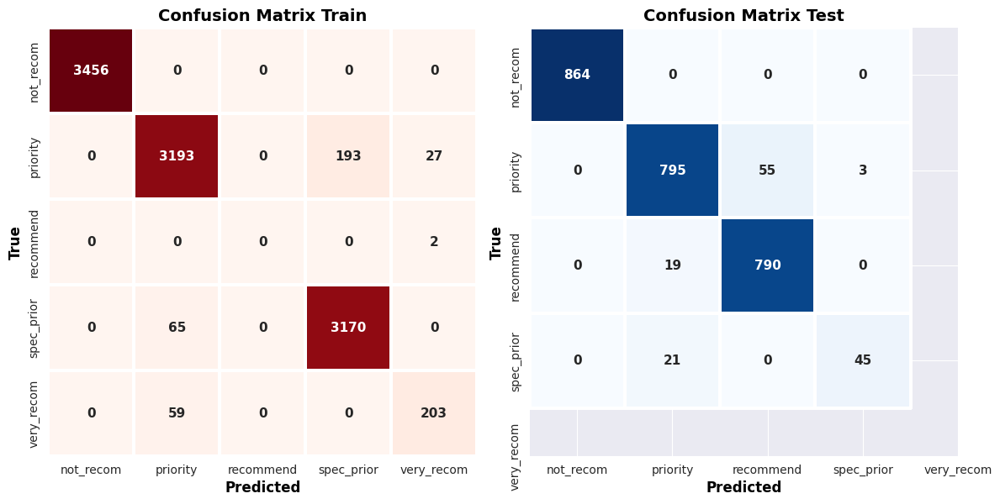

In [100]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

Streaming output truncated to the last 5000 lines.
0:	learn: 1.3511162	total: 3.75ms	remaining: 747ms
1:	learn: 1.1727972	total: 7.38ms	remaining: 731ms
2:	learn: 1.0406977	total: 10.9ms	remaining: 718ms
3:	learn: 0.9318207	total: 14.5ms	remaining: 711ms
4:	learn: 0.8502443	total: 18.5ms	remaining: 720ms
5:	learn: 0.7800222	total: 22ms	remaining: 713ms
6:	learn: 0.7219962	total: 25.8ms	remaining: 710ms
7:	learn: 0.6712912	total: 29.3ms	remaining: 703ms
8:	learn: 0.6239122	total: 33ms	remaining: 700ms
9:	learn: 0.5833779	total: 36.7ms	remaining: 697ms
10:	learn: 0.5466631	total: 40.3ms	remaining: 692ms
11:	learn: 0.5164104	total: 43.9ms	remaining: 688ms
12:	learn: 0.4914747	total: 47.5ms	remaining: 683ms
13:	learn: 0.4683581	total: 51.1ms	remaining: 679ms
14:	learn: 0.4449748	total: 54.7ms	remaining: 675ms
15:	learn: 0.4223301	total: 58.4ms	remaining: 671ms
16:	learn: 0.4027234	total: 62ms	remaining: 667ms
17:	learn: 0.3847567	total: 69.8ms	remaining: 706ms
18:	learn: 0.3720164	total: 7

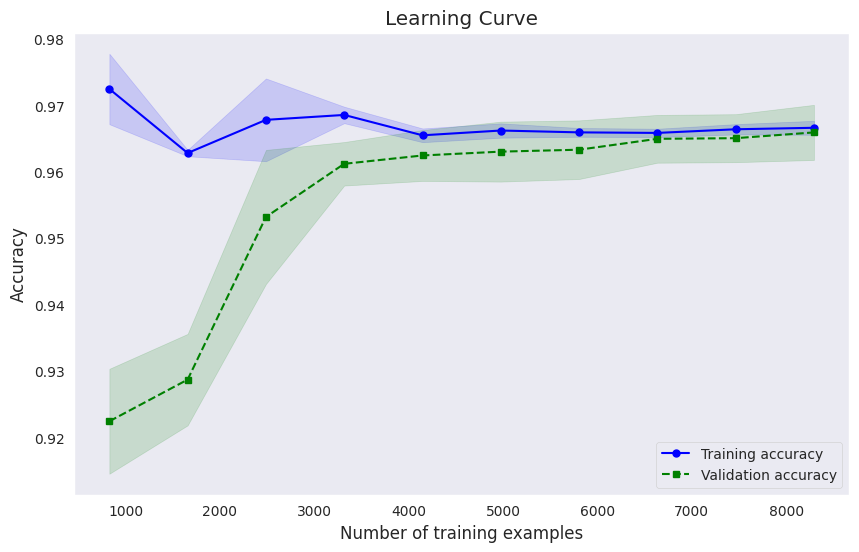

In [101]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

## GradientBoostingClassifier

In [102]:
param_grids = [
    {
        'feature_selection__k': [5, 10, 15],
        'classifier__n_estimators': [50, 100, 200],
        'classifier__learning_rate': [0.01, 0.05, 0.1],
        'classifier__max_depth': [3, 5, 7],
        'classifier__min_samples_split': [2, 5, 10],
        'classifier__min_samples_leaf': [1, 2, 4],
        'classifier__subsample': [0.8, 0.9, 1.0],
        'classifier__max_features': ['auto', 'sqrt', 'log2']
    }
]

pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier',GradientBoostingClassifier())
])


clf = RandomizedSearchCV(pipe, param_grids, cv=5, n_iter=50, verbose=2, n_jobs=-1)


clf.fit(X_train_encoded, y_train)


Fitting 5 folds for each of 50 candidates, totalling 250 fits


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

25:	learn: 0.5887257	total: 287ms	remaining: 265ms
26:	learn: 0.5781984	total: 304ms	remaining: 259ms
27:	learn: 0.5683109	total: 311ms	remaining: 244ms
28:	learn: 0.5594177	total: 318ms	remaining: 230ms
29:	learn: 0.5508144	total: 323ms	remaining: 215ms
30:	learn: 0.5425515	total: 327ms	remaining: 200ms
31:	learn: 0.5347699	total: 334ms	remaining: 188ms
32:	learn: 0.5277902	total: 337ms	remaining: 174ms
33:	learn: 0.5208571	total: 341ms	remaining: 161ms
34:	learn: 0.5144272	total: 345ms	remaining: 148ms
35:	learn: 0.5082469	total: 351ms	remaining: 136ms
36:	learn: 0.5024124	total: 356ms	remaining: 125ms
37:	learn: 0.4971453	total: 364ms	remaining: 115ms
38:	learn: 0.4924063	total: 370ms	remaining: 104ms
39:	learn: 0.4874401	total: 380ms	remaining: 95ms
40:	learn: 0.4829765	total: 389ms	remaining: 85.4ms
41:	learn: 0.4787553	total: 394ms	remaining: 75.1ms
42:	learn: 0.4747833	total: 400ms	remaining: 65.1ms
43:	learn: 0.4710277	total: 405ms	remaining: 55.3ms
44:	learn: 0.4675806	total: 

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

29:	learn: 0.5479358	total: 199ms	remaining: 132ms
30:	learn: 0.5396391	total: 203ms	remaining: 124ms
31:	learn: 0.5319732	total: 207ms	remaining: 117ms
32:	learn: 0.5249886	total: 212ms	remaining: 109ms
33:	learn: 0.5184098	total: 215ms	remaining: 101ms
34:	learn: 0.5123068	total: 219ms	remaining: 93.9ms
35:	learn: 0.5061734	total: 223ms	remaining: 86.8ms
36:	learn: 0.5002535	total: 228ms	remaining: 80ms
37:	learn: 0.4946635	total: 232ms	remaining: 73.4ms
38:	learn: 0.4893830	total: 237ms	remaining: 66.7ms
39:	learn: 0.4847192	total: 240ms	remaining: 60.1ms
40:	learn: 0.4799826	total: 245ms	remaining: 53.7ms
41:	learn: 0.4758669	total: 248ms	remaining: 47.3ms
42:	learn: 0.4717039	total: 252ms	remaining: 41.1ms
43:	learn: 0.4676672	total: 257ms	remaining: 35ms
44:	learn: 0.4642848	total: 260ms	remaining: 28.9ms
45:	learn: 0.4606419	total: 266ms	remaining: 23.1ms
46:	learn: 0.4572410	total: 269ms	remaining: 17.2ms
47:	learn: 0.4539707	total: 273ms	remaining: 11.4ms
48:	learn: 0.4509355	

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

[CV] END classifier__learning_rate=0.05, classifier__max_depth=7, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__subsample=0.8, feature_selection__k=10; total time=   8.7s
[CV] END classifier__learning_rate=0.05, classifier__max_depth=7, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__subsample=0.8, feature_selection__k=10; total time=   7.1s
[CV] END classifier__learning_rate=0.05, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__subsample=0.8, feature_selection__k=15; total time=   7.5s
[CV] END classifier__learning_rate=0.05, classifier__max_depth=3, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__sub

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'`

[CV] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__subsample=0.8, feature_selection__k=10; total time=   6.9s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=200, classifier__subsample=0.8, feature_selection__k=10; total time=   8.5s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=200, classifier__subsample=1.0, feature_selection__k=10; total time=  10.5s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=5, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=200, classifier__subsample=1

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, classifier__subsample=1.0, feature_selection__k=15; total time=   2.6s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, classifier__subsample=0.8, feature_selection__k=5; total time=   2.4s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, classifier__subsample=0.8, feature_selection__k=5; total time=   2.4s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, classifier__subsample=0.8

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

[CV] END classifier__learning_rate=0.1, classifier__max_depth=7, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=200, classifier__subsample=0.8, feature_selection__k=10; total time=  13.8s
[CV] END classifier__learning_rate=0.05, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, classifier__subsample=1.0, feature_selection__k=5; total time=   8.4s
[CV] END classifier__learning_rate=0.05, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, classifier__subsample=1.0, feature_selection__k=5; total time=   6.6s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=7, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=200, classifier__subsamp

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

[CV] END classifier__learning_rate=0.01, classifier__max_depth=7, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, classifier__subsample=0.9, feature_selection__k=5; total time=   1.8s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=7, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, classifier__subsample=0.9, feature_selection__k=5; total time=   1.9s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=7, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, classifier__subsample=0.9, feature_selection__k=5; total time=   2.0s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, classifier__subsample=

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('feature_selection',
                                              SelectKBest()),
                                             ('classifier',
                                              GradientBoostingClassifier())]),
                   n_iter=50, n_jobs=-1,
                   param_distributions=[{'classifier__learning_rate': [0.01,
                                                                       0.05,
                                                                       0.1],
                                         'classifier__max_depth': [3, 5, 7],
                                         'classifier__max_features': ['auto',
                                                                      'sqrt',
                                                                      'log2'],
                                         'classifier__min_samples_leaf': [1, 2,
                                                                          4],
                                         'classifier__min_samples_split': [2, 5,
                                                                           10],
                                         'classifier__n_estimators': [50, 100,
                                                                      200],
                                         'classifier__subsample': [0.8, 0.9,
                                                                   1.0],
                                         'feature_selection__k': [5, 10, 15]}],
                   verbose=2)

In [103]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [104]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.9560185185185185
0.9645061728395061


In [105]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)


0.9296068988736961
0.8648999487703561


In [106]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.96      0.94      0.95      3413
   recommend       0.08      1.00      0.15         2
  spec_prior       0.94      0.98      0.96      3235
  very_recom       0.87      0.74      0.80       262

    accuracy                           0.96     10368
   macro avg       0.77      0.93      0.77     10368
weighted avg       0.97      0.96      0.97     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

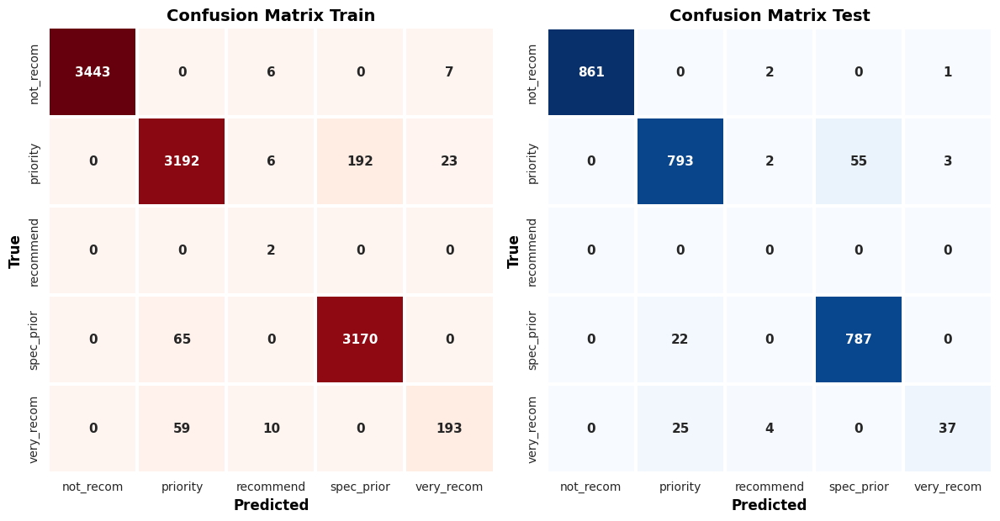

In [107]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()


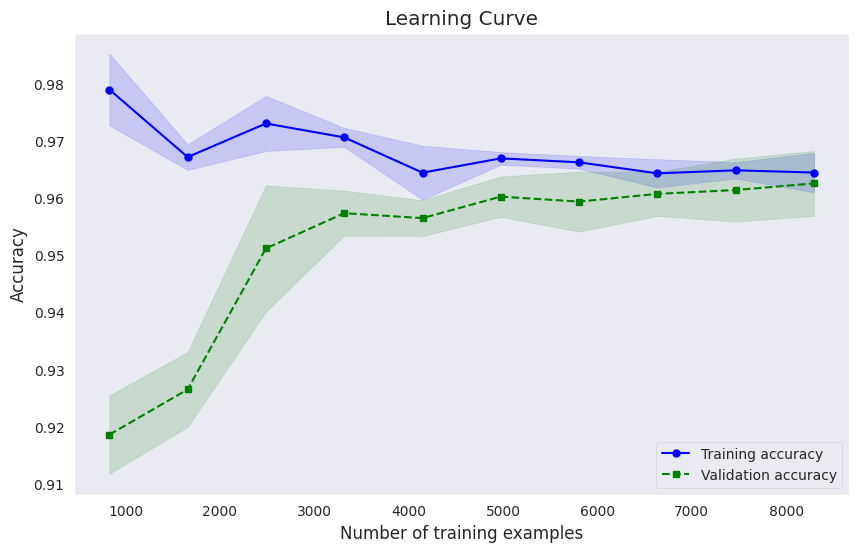

In [108]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()

## AdaBoostClassifier

In [109]:
param_grids = [
    {
       'feature_selection__k': [5, 10, 15],
       'classifier__n_estimators': [50, 100, 200],
       'classifier__learning_rate': [0.01, 0.05, 0.1],
       'classifier__algorithm': ['SAMME', 'SAMME.R']
    }
]

pipe = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('classifier',AdaBoostClassifier())
])


clf = RandomizedSearchCV(pipe, param_grids, cv=5, n_iter=50, verbose=2, n_jobs=-1)


clf.fit(X_train_encoded, y_train)


Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, classifier__subsample=0.8, feature_selection__k=15; total time=   2.7s
[CV] END classifier__learning_rate=0.01, classifier__max_depth=5, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, classifier__subsample=0.8, feature_selection__k=15; total time=   3.8s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=200, classifier__subsample=0.8, feature_selection__k=10; total time=   7.4s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=200, classifier__subsamp

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

[CV] END classifier__learning_rate=0.05, classifier__max_depth=3, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, classifier__subsample=1.0, feature_selection__k=10; total time=   3.3s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=7, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__subsample=0.9, feature_selection__k=5; total time=   5.1s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=7, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__subsample=0.9, feature_selection__k=5; total time=   7.8s
[CV] END classifier__learning_rate=0.1, classifier__max_depth=7, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, classifier__subsample

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=50, feature_selection__k=10; total time=   0.7s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.1, classifier__n_estimators=50, feature_selection__k=5; total time=   0.5s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.1, classifier__n_estimators=50, feature_selection__k=5; total time=   0.5s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.01, classifier__n_estimators=200, feature_selection__k=5; total time=   1.2s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.01, classifier__n_estimators=200, feature_selection__k=5; total time=   1.2s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.1, classifier__n_estimators=100, feature_selection__k=5; total time=   0.6s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.1, classifier__n_estimators=100, feature_selection__k=5; total time=   0.6s
[CV

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=200, feature_selection__k=10; total time=   2.1s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.1, classifier__n_estimators=200, feature_selection__k=10; total time=   1.7s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.1, classifier__n_estimators=200, feature_selection__k=10; total time=   1.8s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.1, classifier__n_estimators=200, feature_selection__k=10; total time=   1.8s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.01, classifier__n_estimators=50, feature_selection__k=5; total time=   0.3s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.01, classifier__n_estimators=50, feature_selection__k=15; total time=   0.4s
[CV] END classifier__algorithm=SAMME, classifier__learning_rate=0.01, classifier__n_estimators=50, feature_selection__k=15; total time

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=200, feature_selection__k=15; total time=   1.9s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=200, feature_selection__k=15; total time=   1.9s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=100, feature_selection__k=10; total time=   0.9s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=100, feature_selection__k=10; total time=   0.9s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.05, classifier__n_estimators=100, feature_selection__k=10; total time=   0.9s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.1, classifier__n_estimators=50, feature_selection__k=15; total time=   0.5s
[CV] END classifier__algorithm=SAMME.R, classifier__learning_rate=0.1, classifier__n_estimators=50, feature_selection__k=15; t

/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: divide by zero encountered in divide
  f = msb / msw
/usr/local

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('feature_selection',
                                              SelectKBest()),
                                             ('classifier',
                                              AdaBoostClassifier())]),
                   n_iter=50, n_jobs=-1,
                   param_distributions=[{'classifier__algorithm': ['SAMME',
                                                                   'SAMME.R'],
                                         'classifier__learning_rate': [0.01,
                                                                       0.05,
                                                                       0.1],
                                         'classifier__n_estimators': [50, 100,
                                                                      200],
                                         'feature_selection__k': [5, 10, 15]}],
                   verbose=2)

In [110]:
y_pred=clf.predict(X_test_encoded)
y_pred_train = clf.predict(X_train_encoded)

In [111]:
print(clf.score(X_test_encoded,y_test))
print(clf.score(X_train_encoded,y_train))

0.8761574074074074
0.8716242283950617


In [112]:
bal_acc_train = balanced_accuracy_score(y_train, y_pred_train)
bal_acc_test = balanced_accuracy_score(y_test, y_pred)
print(bal_acc_train)
print(bal_acc_test)


0.53544625943807
0.6728727373901753


In [113]:
print("##" * 40)
print(" " * 25, "Classification Report Train")
print("##" * 40)
print(classification_report(y_train, y_pred_train, target_names = le.classes_))
print("")

print("##" * 40)
print(" " * 25, "Classification Report Test")
print("##" * 40)
print(classification_report(y_test, y_pred))

################################################################################
                          Classification Report Train
################################################################################
              precision    recall  f1-score   support

   not_recom       1.00      1.00      1.00      3456
    priority       0.77      0.87      0.82      3413
   recommend       0.00      0.00      0.00         2
  spec_prior       0.86      0.81      0.83      3235
  very_recom       0.00      0.00      0.00       262

    accuracy                           0.87     10368
   macro avg       0.53      0.54      0.53     10368
weighted avg       0.85      0.87      0.86     10368


################################################################################
                          Classification Report Test
################################################################################
              precision    recall  f1-score   support

           0       1.00 

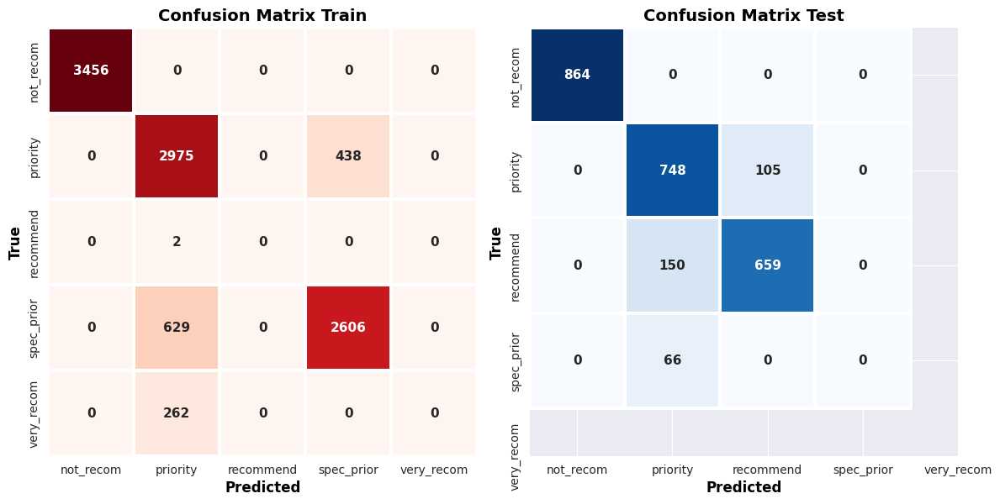

In [114]:
cf_mx_train = confusion_matrix(y_train, y_pred_train)
cf_mx_test = confusion_matrix(y_test, y_pred)

fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12,7))
axs = axs.flat

sns.heatmap(cf_mx_train, cmap = 'Reds', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[0])
sns.heatmap(cf_mx_test, cmap = 'Blues', annot = True, annot_kws = {'fontsize':11, 'fontweight':'bold'}, linewidths = 1.5, fmt = '', xticklabels = le.classes_, yticklabels = le.classes_, cbar = False, square = True, ax = axs[1])
axs[0].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_xlabel('Predicted', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[1].set_ylabel('True', fontsize = 12, fontweight = "bold", color = "black")
axs[0].set_title('Confusion Matrix Train', fontsize = 14, fontweight = "bold", color = "black")
axs[1].set_title('Confusion Matrix Test', fontsize = 14, fontweight = "bold", color = "black")

fig.tight_layout()
fig.show()

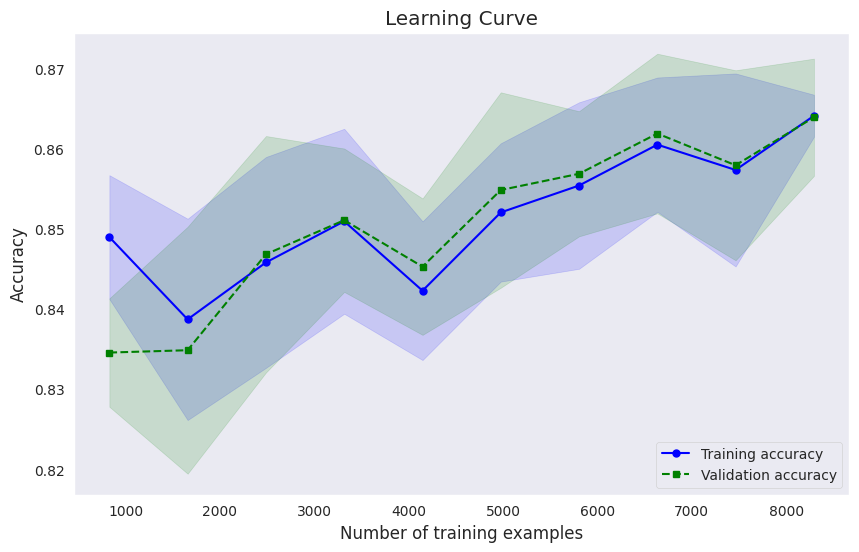

In [115]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=clf.best_estimator_, X=X_train_encoded, y=y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid()
plt.show()